Load Packages and settings

In [1]:
from sklearn.metrics import r2_score
from scipy.stats import gaussian_kde 
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from sklearn.metrics import r2_score
import xarray as xr

#select particular representative gauge
reg = 'SR'

if reg == 'CT':
    columnname = str(54)
    mask_size = '892'
elif reg == 'SR':
    columnname = str(38)
    mask_size = '961'

MLDir = '/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami' 
SimDir = "/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/simu/"


list_size = ['961','1773','3669','6941']
mask_size = list_size[0]
train_size = list_size[1]

Sample based on event information from INGV catalog

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import contextily as cx
import os

#select particular representative gauge
reg = 'SR'

if reg == 'CT':
    columnname = str(38)
    train_size = '3454'
    mask_size = '892'
elif reg == 'SR':
    columnname = str(54)
    train_size = '961'
    mask_size = '961'

MLDir = '/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami' 
eve_info = pd.read_csv(f'{MLDir}/resources/processed/allinfo_eventsBS_PS53550.csv',sep=',')
offshore_info = pd.read_csv(f'{MLDir}/data/info/grid0_allpts87_alleve53550.offshore.txt',sep='\t')
period_info = pd.read_csv(f'{MLDir}/data/info/grid0_allpts87_alleveWP53550.offshore.txt',sep='\t')
dperiod_info = pd.read_csv(f'{MLDir}/data/info/grid0_allpts87_alleveDP53550.offshore.txt',sep='\t')
onshore_info = pd.read_csv(f'{MLDir}/data/info/CHeight_{reg}_alleve53550.onshore.txt',sep='\t')
#add eve_id to offshore_info and onshore_info by splitting id at /

#mange id column
eve_info.rename(columns={'ID':'eve_id'}, inplace=True)
offshore_info['eve_id'] = offshore_info['id'].str.split('/').str[1]
onshore_info['eve_id'] = onshore_info['id'].str.split('/').str[1]
period_info['eve_id'] = period_info['id'].str.split('/').str[1]
dperiod_info['eve_id'] = dperiod_info['id'].str.split('/').str[1]

#keep only column gaugeno and eve_id
offshore_info = offshore_info[['eve_id',columnname]]
offshore_info.rename(columns={columnname:'max_off'}, inplace=True)

period_info = period_info[['eve_id',columnname]]
period_info.rename(columns={columnname:'wave_period'}, inplace=True)

dperiod_info = dperiod_info[['eve_id',columnname]]
dperiod_info.rename(columns={columnname:'dominant_period'}, inplace=True)

# onshore_info = onshore_info[['eve_id','max']]

#merge offshore, onshore and period
combined = pd.merge(offshore_info, onshore_info, on='eve_id', how='left')
combined = pd.merge(combined, period_info, on='eve_id', how='left')
combined = pd.merge(combined, dperiod_info, on='eve_id', how='left')
#merge combined with eve_info
combined = pd.merge(combined, eve_info, on='eve_id', how='left')

/tmp/ipykernel_6797/184904084.py:20: DtypeWarning: Columns (6,7,8,9) have mixed types. Specify dtype option on import or set low_memory=False.
  eve_info = pd.read_csv(f'{MLDir}/resources/processed/allinfo_eventsBS_PS53550.csv',sep=',')


In [2]:
#get column names
# combined.columns.values.tolist()
# ['eve_id',
#  '41', #offshore gauge selected for sampling
#  'id',
#  'count',
#  'max',
#  'logsum',
#  'mean',
#  'sd',
#  'dzmin',
#  'dzmax',
#  'Source_Region',
#  'Type',
#  'Mag',
#  'lon',
#  'lat',
#  'SlipModel',
#  'Scaling',
#  'RuptureModel',
#  'Rigidity',
#  'Depth',
#  'Strike',
#  'Dip',
#  'Rake',
#  'Length',
#  'Area',
#  'Slip',
#  'Location',
#  'LocationCount',
#  'mean_prob']

# #create a new dataframe with only the columns we need
# combined = combined[['eve_id','id',columnname,'mean_prob','dzmax','dzmin','dmax','lon','lat','Location','LocationCount']]

# #rename column gauge to max_off and change type to double
# combined.rename(columns={columnname:'max_off'}, inplace=True)
# combined['max_off'] = combined['max_off'].astype(np.double)


In [3]:
# #create a new dataframe with only the columns we need
combined = combined[['eve_id','id','max_off','wave_period','dominant_period','mean_prob','dzmax','dzmin','count','dmax','lon','lat','Location','LocationCount']]

#get max abs deformation
combined['max_absdz'] = combined[['dzmax','dzmin']].abs().max(axis=1)

#if absolute value of dzmax or dzmin is less than 0.1, set event_type to 'near'(0) ie  else 'far'(1)
combined['event_type'] = combined['max_absdz'].apply(lambda x: 1 if abs(x)<0.1 else 0).astype(np.double)
# combined['event_type'] = combined['dzmax'].apply(lambda x: 1 if x<0.2 else 0).astype(np.double)

#importance variable
combined['importance'] = combined['mean_prob'] * combined['max_off'].astype(np.double)

# #count when importance is 0
# combined[combined['importance']==0]
# #set importance to 1e-10  if importance is 0
# combined['importance'] = combined['importance'].apply(lambda x: 1e-10 if x==0 else x)


#count number of events in each cluster of event_type
print(combined.groupby('event_type').count())

#create uniform weights column
combined['uniform_wt'] = 1/len(combined)


            eve_id     id  max_off  wave_period  dominant_period  mean_prob  \
event_type                                                                    
0.0           9186   9186     9186         9186             9186       9186   
1.0          44364  44364    44364        44364            44364      44364   

            dzmax  dzmin  count   dmax    lon    lat  Location  LocationCount  \
event_type                                                                      
0.0          9186   9186   9186   9186   9186   9186      9186           9186   
1.0         44364  44364  44364  44364  44364  44364     44364          44364   

            max_absdz  importance  
event_type                         
0.0              9186        9186  
1.0             44364       44364  


#add grid count based on grid size of 0.3 degree *110 lm--> 33 km

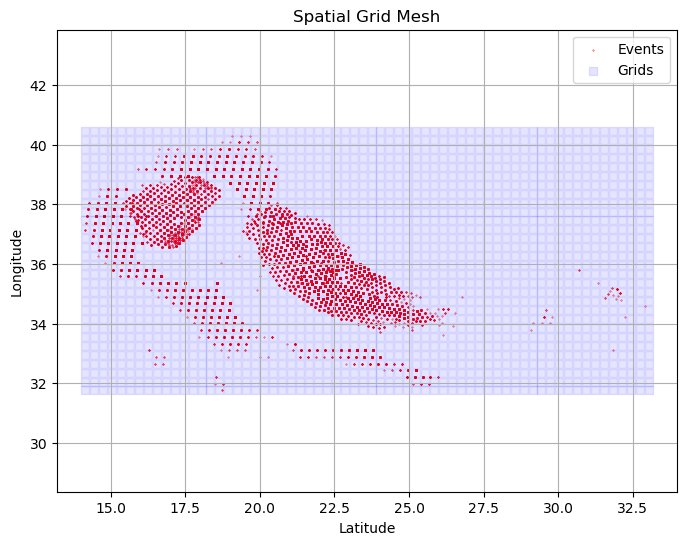

In [4]:
# Calculate the extent of latitude and longitude
min_lat = combined['lat'].min()
max_lat = combined['lat'].max()
min_lon = combined['lon'].min()
max_lon = combined['lon'].max()

# Define the size of the grid
grid_size = 0.3

# Create the latitude and longitude grids centre
lat_grids = np.arange(min_lat, max_lat + grid_size, grid_size)
lon_grids = np.arange(min_lon, max_lon + grid_size, grid_size)

# Create a meshgrid of latitude and longitude
mesh_lon,mesh_lat = np.meshgrid(lon_grids,lat_grids,)

# Plot the grid mesh
plt.figure(figsize=(8, 6))
plt.scatter(combined['lon'], combined['lat'], color='red', label='Events',s=0.1)
plt.scatter(mesh_lon,mesh_lat, color='blue', alpha=0.1, label='Grids', s=40, marker='s')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Spatial Grid Mesh')
plt.legend()
plt.grid(True)
plt.axis('equal')
plt.show()

In [5]:
# Calculate the number of events per grid
grid_counts = {}
for i in range(len(lat_grids) - 1):
    for j in range(len(lon_grids) - 1):
        lat_min, lat_max = lat_grids[i], lat_grids[i+1]
        lon_min, lon_max = lon_grids[j], lon_grids[j+1]
        count = combined[(combined['lat'] >= lat_min) & (combined['lat'] < lat_max) &
                         (combined['lon'] >= lon_min) & (combined['lon'] < lon_max)].shape[0]
        if count > 0:
            grid_id = f"{lat_min.round(3)},{lon_min.round(3)}"
            grid_counts[grid_id] = count

# Assign grid counts and grid ID to events
combined['gridcount'] = np.nan
combined['grid_id'] = np.nan
for index, event in combined.iterrows():
    lat, lon = event['lat'], event['lon']
    for grid_id, count in grid_counts.items():
        lat_min, lon_min = map(float, grid_id.split(","))
        lat_max, lon_max = lat_min + grid_size, lon_min + grid_size
        if lat_min <= lat < lat_max and lon_min <= lon < lon_max:
            combined.at[index, 'gridcount'] = count
            combined.at[index, 'grid_id'] = grid_id
            break

#if any entry nan for gridcount, set it to copy value of row above
combined['gridcount'] = combined['gridcount'].fillna(method='ffill')
combined['grid_id'] = combined['grid_id'].fillna(method='ffill')

In [6]:
# #'save combined to csv'
combined.to_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/info/sampling_input_{reg}_{columnname}.csv',index=False)

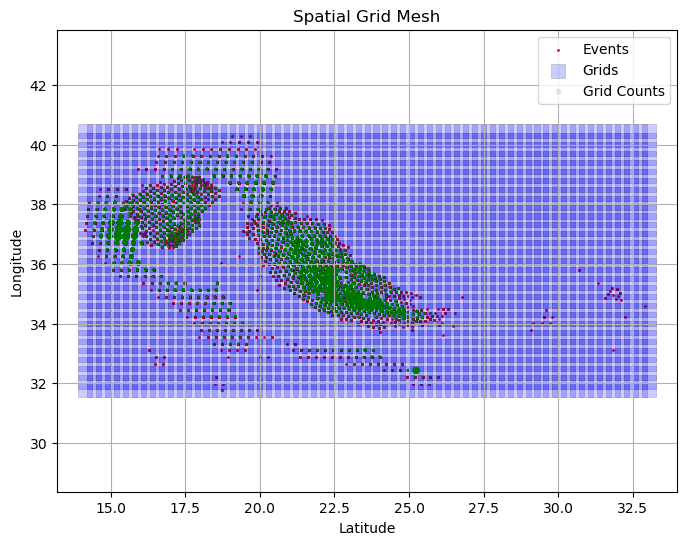

In [7]:
#plot grid counts and grid id
plt.figure(figsize=(8, 6))
plt.scatter(combined['lon'], combined['lat'], color='red', label='Events',s=1)
plt.scatter(mesh_lon,mesh_lat, color='blue', alpha=0.2, label='Grids', s=90, marker='s',linewidth =0.5, edgecolors='black')
plt.scatter(combined['lon'], combined['lat'], s=combined['gridcount']*0.01, color='green', alpha=0.1, label='Grid Counts')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Spatial Grid Mesh')
plt.legend()
plt.grid(True)
plt.axis('equal')
plt.show()

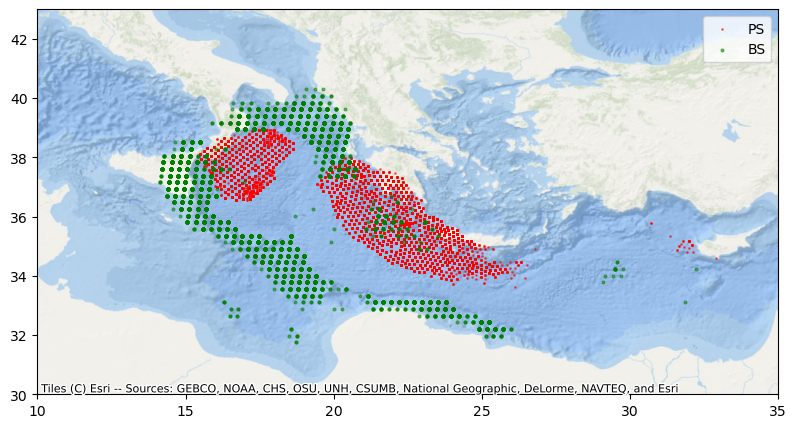

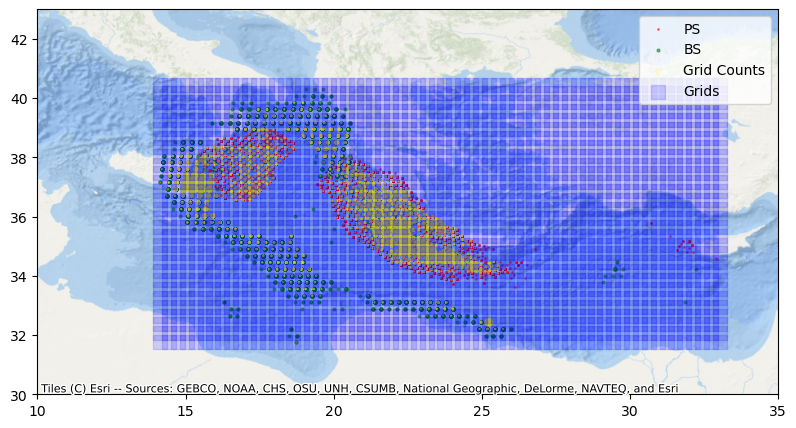

In [21]:
#plot location of events by event type
fig, ax = plt.subplots(figsize=(10,5))
#if BS or PS
ax = plt.scatter(combined[combined['id'].str[:2]=='PS']['lon'], combined[combined['id'].str[:2]=='PS']['lat'], alpha=0.5, label='PS',s=1,color='red')
ax = plt.scatter(combined[combined['id'].str[:2]=='BS']['lon'], combined[combined['id'].str[:2]=='BS']['lat'], alpha=0.5, label='BS', s=4,color='green')
# ax = plt.scatter(combined['lon'], combined['lat'], s=combined['gridcount']*0.01, color='yellow', alpha=0.1, label='Grid Counts')
# ax = plt.scatter(mesh_lon,mesh_lat, color='blue', alpha=0.2, label='Grids', s=50, marker='s',linewidth =0.5, edgecolors='blue')
plt.legend(loc='upper right')
plt.xlim(10, 35)
plt.ylim(30, 43)
ax = plt.gca()
cx.add_basemap(ax,crs='EPSG:4326', source=cx.providers.Esri.OceanBasemap)
plt.show()
#plot location of events by event type
fig, ax = plt.subplots(figsize=(10,5))
#if BS or PS
ax = plt.scatter(combined[combined['id'].str[:2]=='PS']['lon'], combined[combined['id'].str[:2]=='PS']['lat'], alpha=0.5, label='PS',s=1,color='red')
ax = plt.scatter(combined[combined['id'].str[:2]=='BS']['lon'], combined[combined['id'].str[:2]=='BS']['lat'], alpha=0.5, label='BS', s=4,color='green')
ax = plt.scatter(combined['lon'], combined['lat'], s=combined['gridcount']*0.015, color='yellow', alpha=0.1, label='Grid Counts')
ax = plt.scatter(mesh_lon,mesh_lat, color='blue', alpha=0.15, label='Grids', s=90, marker='s',linewidth =1, edgecolors='blue')
plt.legend(loc='upper right')
plt.xlim(10, 35)
plt.ylim(30, 43)
ax = plt.gca()
cx.add_basemap(ax,crs='EPSG:4326', source=cx.providers.Esri.OceanBasemap)
plt.show()

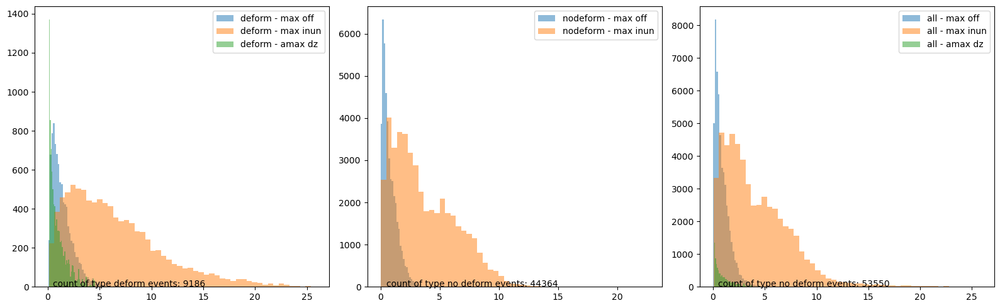

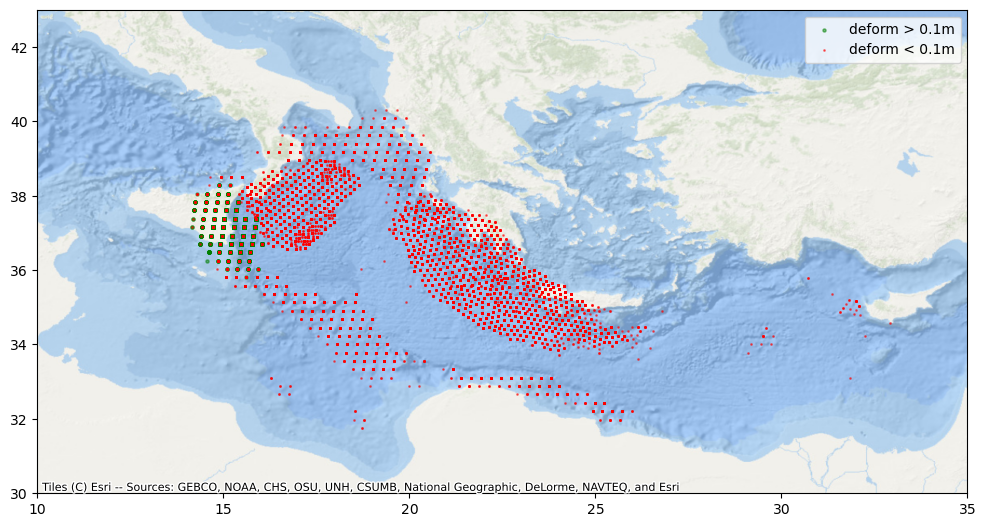

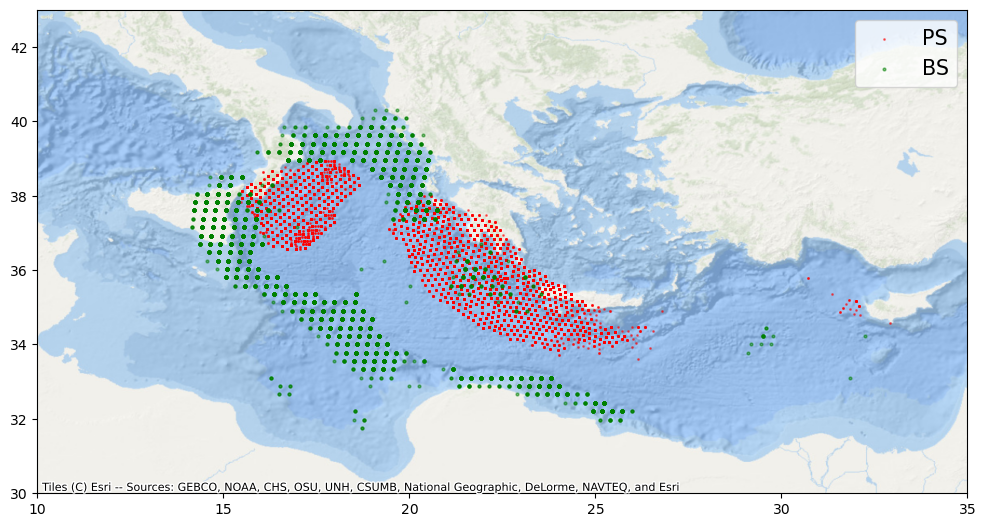

In [9]:
#distribution of events
fig, axs = plt.subplots(1, 3, tight_layout=True, figsize=(16,5))
axs[0].hist(combined[combined['event_type']==0]['max_off'], bins=50, alpha=0.5, label='deform - max off')
axs[0].hist(combined[combined['event_type']==0]['dmax'], bins=50, alpha=0.5, label='deform - max inun')
axs[0].hist(combined[combined['event_type']==0]['max_absdz'], bins=50, alpha=0.5, label='deform - amax dz')
axs[0].text(0.5, 2, 'count of type deform events: '+str(len(combined[combined['event_type']==0])))
axs[0].legend(loc='upper right')

axs[1].hist(combined[combined['event_type']==1]['max_off'], bins=50, alpha=0.5, label='nodeform - max off')
axs[1].hist(combined[combined['event_type']==1]['dmax'], bins=50, alpha=0.5, label='nodeform - max inun')
# axs[0,1].hist(combined[combined['event_type']==1]['max_absdz'], bins=50, alpha=0.5, label='nodeform - amax dz')
axs[1].text(0.5, 2, 'count of type no deform events: '+str(len(combined[combined['event_type']==1])))
axs[1].legend(loc='upper right')

# axs[1,0].hist(combined[combined['event_type']==0]['importance'], bins=50, alpha=0.5, label='deform - importance')
# axs[1,0].hist(combined[combined['event_type']==1]['importance'], bins=50, alpha=0.5, label='nodeform - importance')
# axs[1,0].legend(loc='upper right')

axs[2].hist(combined['max_off'], bins=50, alpha=0.5, label='all - max off')
axs[2].hist(combined['dmax'], bins=50, alpha=0.5, label='all - max inun')
axs[2].hist(combined[combined['max_absdz']>0.1]['max_absdz'], bins=50, alpha=0.5, label='all - amax dz')
axs[2].text(0.5, 2, 'count of type no deform events: '+str(len(combined)))
axs[2].legend(loc='upper right')

#plot location of events by event type
fig, ax = plt.subplots(figsize=(12,10))
ax = plt.scatter(combined[combined['event_type']==0]['lon'], combined[combined['event_type']==0]['lat'], alpha=0.5, label='deform > 0.1m', s=5,color='green')
ax = plt.scatter(combined[combined['event_type']==1]['lon'], combined[combined['event_type']==1]['lat'], alpha=0.5, label='deform < 0.1m',s=1,color='red')
plt.legend(loc='upper right')
plt.xlim(10, 35)
plt.ylim(30, 43)
ax = plt.gca()
cx.add_basemap(ax,crs='EPSG:4326', source=cx.providers.Esri.OceanBasemap)

#plot location of events by event type
fig, ax = plt.subplots(figsize=(12,10))
#if BS or PS
ax = plt.scatter(combined[combined['id'].str[:2]=='PS']['lon'], combined[combined['id'].str[:2]=='PS']['lat'], alpha=0.5, label='PS',s=1,color='red')
ax = plt.scatter(combined[combined['id'].str[:2]=='BS']['lon'], combined[combined['id'].str[:2]=='BS']['lat'], alpha=0.5, label='BS', s=4,color='green')
plt.legend(loc='upper right',fontsize=15)
plt.xlim(10, 35)
plt.ylim(30, 43)
ax = plt.gca()
cx.add_basemap(ax,crs='EPSG:4326', source=cx.providers.Esri.OceanBasemap)
plt.show()

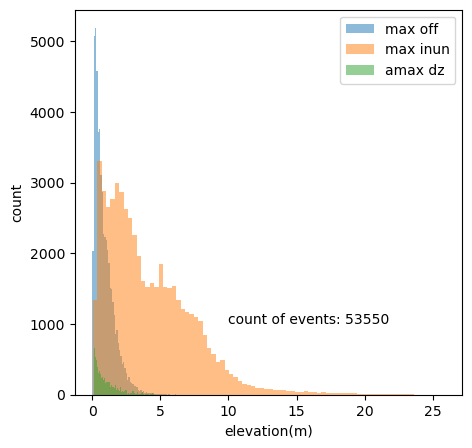

In [10]:
fig, axs = plt.subplots(1, 1, figsize=(5, 5))
axs.hist(combined['max_off'], bins=80, alpha=0.5, label='max off')
axs.hist(combined['dmax'], bins=80, alpha=0.5, label='max inun')
axs.hist(combined[combined['max_absdz']>0.1]['max_absdz'], bins=80, alpha=0.5, label='amax dz')
axs.text(10, 1000, 'count of events: '+str(len(combined)))
axs.legend(loc='upper right')
#label axes
axs.set(xlabel='elevation(m)', ylabel='count')
plt.savefig(MLDir + f'/resources/plots/dist_events{str(len(combined))}_{reg}_{columnname}.png', bbox_inches='tight')


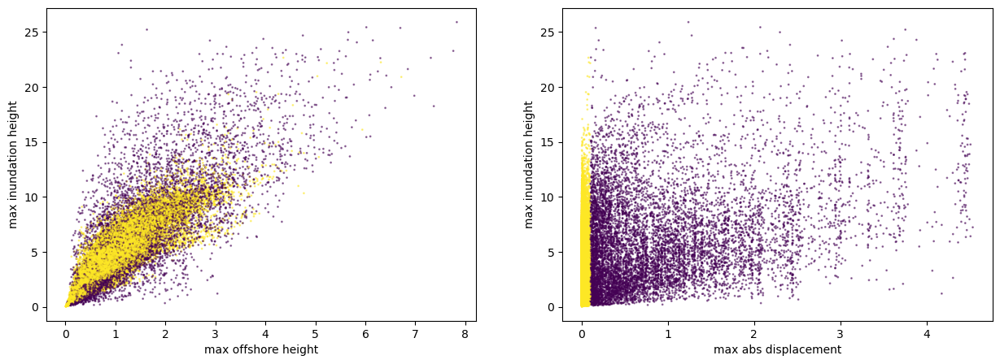

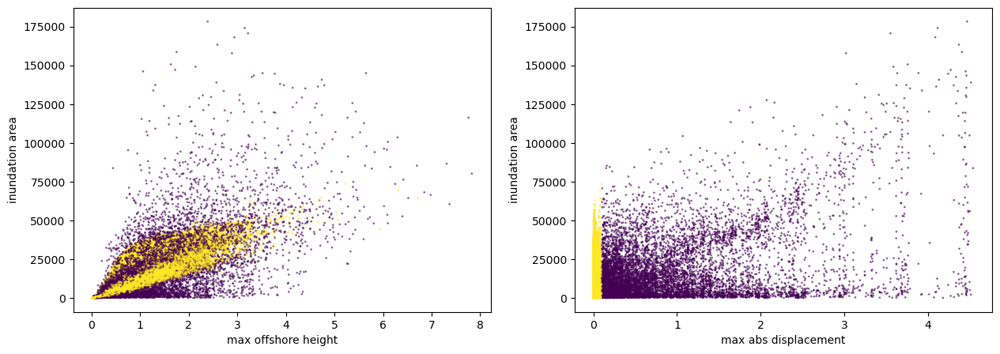

In [11]:
#plt relationship between max_off and dmax
fig, axs = plt.subplots(1, 2, figsize=(15, 5))
axs[0].scatter(combined['max_off'], combined['dmax'], alpha=0.5,s=1, c=combined['event_type'])
axs[1].scatter(combined['max_absdz'], combined['dmax'], alpha=0.5,s=1, c=combined['event_type'])
#set labels
axs[0].set(xlabel='max offshore height', ylabel='max inundation height')
axs[1].set(xlabel='max abs displacement', ylabel='max inundation height')
plt.show()

#plt relationship between max_off and dmax
fig, axs = plt.subplots(1, 2, figsize=(15, 5))
axs[0].scatter(combined['max_off'], combined['count'], alpha=0.5,s=1, c=combined['event_type'])
axs[1].scatter(combined['max_absdz'], combined['count'], alpha=0.5,s=1, c=combined['event_type'])
#set labels
axs[0].set(xlabel='max offshore height', ylabel='inundation area')
axs[1].set(xlabel='max abs displacement', ylabel='inundation area')
plt.show()

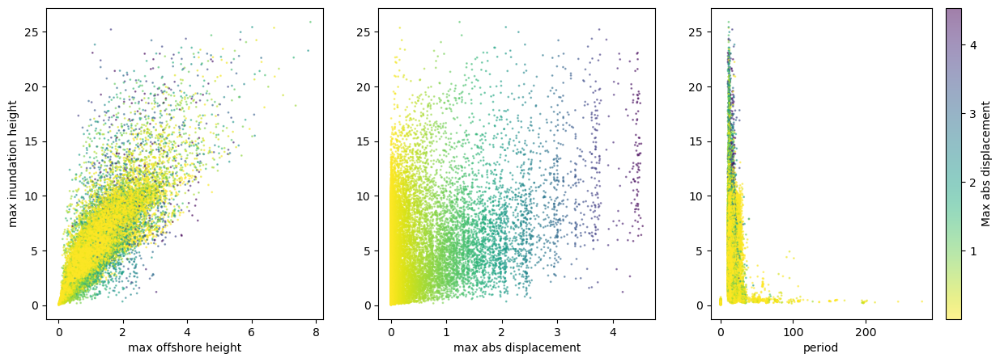

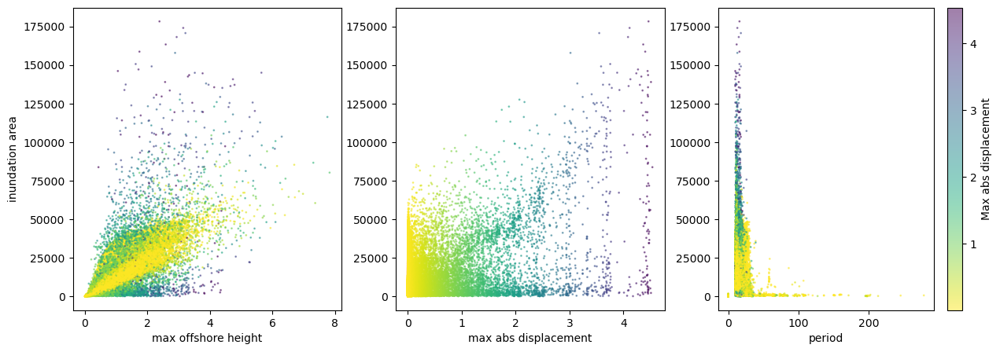

In [12]:
cmap = plt.cm.viridis.reversed()

#plt relationship between max_off and dmax
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
sc=axs[0].scatter(combined['max_off'], combined['dmax'], alpha=0.5,s=1, c=combined['max_absdz'],cmap = cmap)
axs[1].scatter(combined['max_absdz'], combined['dmax'], alpha=0.5,s=1, c=combined['max_absdz'],cmap = cmap)
axs[2].scatter(combined['wave_period'], combined['dmax'], alpha=0.5,s=1, c=combined['max_absdz'],cmap = cmap)
#set labels
axs[0].set(xlabel='max offshore height', ylabel='max inundation height')
axs[1].set(xlabel='max abs displacement')
axs[2].set(xlabel='period')
# Add colorbar
cbar = plt.colorbar(sc, ax=axs[2])
cbar.set_label('Max abs displacement')
plt.show()

#plt relationship between max_off and dmax
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
sc=axs[0].scatter(combined['max_off'], combined['count'], alpha=0.5,s=1, c=combined['max_absdz'],cmap = cmap)
axs[1].scatter(combined['max_absdz'], combined['count'], alpha=0.5,s=1, c=combined['max_absdz'],cmap = cmap)
axs[2].scatter(combined['wave_period'], combined['count'], alpha=0.5,s=1, c=combined['max_absdz'],cmap = cmap)
#set labels
axs[0].set(xlabel='max offshore height', ylabel='inundation area')
axs[1].set(xlabel='max abs displacement')
axs[2].set(xlabel='period')
# Add colorbar
cbar = plt.colorbar(sc, ax=axs[2])
cbar.set_label('Max abs displacement')
# plt.show()

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import contextily as cx

np.random.seed(0)

def sample_train_events(data, #input dataframe with event info 
                        importance_column='mean_prob', #column name for importance weighted sampling
                        samples_per_bin=10, #no of events to sample per bin
                        bin_def = [0,0.5,1.0,1.5,2.0,2.5,3.0,3.5,4.0,5.0], #bin width for wave height,
                        basis_var='max_off' #variable to bin 
                        ): 

    #define bin edges
    bin_start = bin_def[:-1]
    bin_end = bin_def[1:]

    if np.any((data['mean_prob'] < 0) | (data[importance_column] < 0)):
        raise ValueError('event_rates and importance parameter must be nonnegative')
    
    sample = []
    for bin in list(zip(bin_start, bin_end)):
       
        #get events in this bin
        events_in_bin = data[(data[basis_var] >= bin[0]) & (data[basis_var] < bin[1])]
        print('Sampling',samples_per_bin, 'events in bin',bin,'from',len(events_in_bin),'events')
        
        rate_with_this_bin = np.sum(events_in_bin['mean_prob'] )    
        events_in_bin_copy = events_in_bin.copy()

        #sort by lat and lon
        events_in_bin_copy.sort_values(by=['lat', 'lon'], inplace=True)

        if importance_column == 'gridcount' or importance_column == 'LocationCount':
            # Print count of events per grid and print grid ID with the minimum count
            grid_counts = events_in_bin_copy.groupby('grid_id').count()['id']
            # Add the weights column
            events_in_bin_copy['norm_wt'] = events_in_bin_copy['grid_id'].map(lambda x: 1 / grid_counts[x])
            events_in_bin_copy['norm_wt'] /= np.sum(events_in_bin_copy['norm_wt'])      
        else:
            events_in_bin_copy.loc[:, 'norm_wt'] = events_in_bin[importance_column] / np.sum(events_in_bin[importance_column])  

        if samples_per_bin > 0 and np.sum(events_in_bin_copy['norm_wt']) > 0:
            #sample events from this bin weighted by norm_wt
            if len(events_in_bin) <= samples_per_bin:
                print('Less scenarios(',len(events_in_bin),') to sample in this bin',bin,' -- need to be careful using samples will use sample with replacement')
                sampled_ids = np.random.choice(events_in_bin['id'],
                                                size=len(events_in_bin),
                                                p=events_in_bin_copy['norm_wt'],
                                                replace=False,
                                                )
            else:
                sampled_ids = np.random.choice(events_in_bin['id'],
                                                size=samples_per_bin,
                                                p=events_in_bin_copy['norm_wt'],
                                                replace=False,
                                                )            
        #get the sampled events
        sample.append(pd.DataFrame({
            'id': sampled_ids,
            'bin_start': np.repeat(bin[0], len(sampled_ids)),
            'bin_end': np.repeat(bin[1], len(sampled_ids)),
            'rate_with_this_bin': np.repeat(rate_with_this_bin, len(sampled_ids))
        }))
    
    return sample


In [4]:
#select particular representative gauge
reg = 'SR'

if reg == 'SR':
    columnname = str(54)
elif reg == 'CT':
    columnname = str(38)

#read combined dataframe
combined = pd.read_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/info/sampling_input_{reg}_{columnname}.csv')

# far = combined.groupby('event_type').get_group(1)
# near = combined.groupby('event_type').get_group(0)
MLDir = '/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami' 

In [5]:
# #get data to sample
deform_combine = combined.groupby('event_type').get_group(0)
combined_half_deform = deform_combine.sample(frac=0.5, random_state=0).reset_index(drop=True)
nodeform_combine = combined.groupby('event_type').get_group(1)
combined_half_nodeform = nodeform_combine.sample(frac=0.5, random_state=0).reset_index(drop=True)
#split id first 2 characters to get BS or PS
combined_half_nodeform['source_type'] = combined_half_nodeform['id'].str[:2]

#'split sampling in two steps for event type 0 and 1 then merge'
wt_para = 'gridcount' #'LocationCount', 'mean_prob', 'importance', 'uniform', gridcount


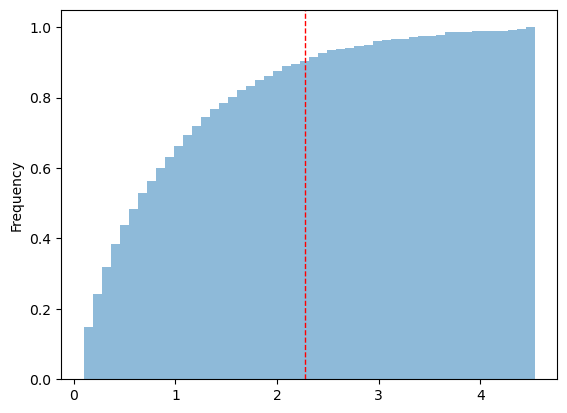

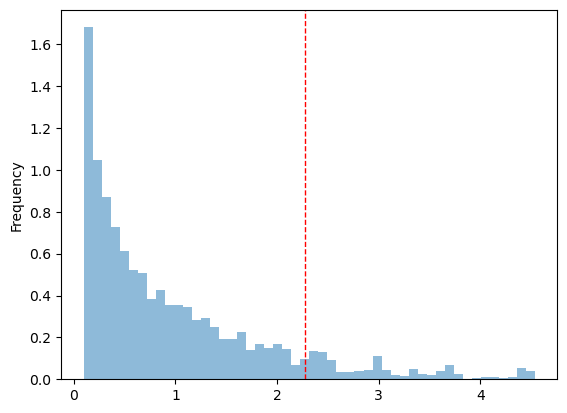

count above 90th percentile 918
total count 9186


In [6]:
'plot the distribution of the variable to sample'
var2plot = 'max_absdz'
#plot cdf of variable to sample
deform_combine[var2plot].plot.hist(bins=50, alpha=0.5, label='deform',cumulative=True, density=True)
plt.axvline(deform_combine[var2plot].quantile(0.9), color='red', linestyle='dashed', linewidth=1)
plt.show()
deform_combine[var2plot].plot.hist(bins=50, alpha=0.5, label='deform',density=True)
plt.axvline(deform_combine[var2plot].quantile(0.9), color='red', linestyle='dashed', linewidth=1)
plt.show()
print('count above 90th percentile',len(deform_combine[deform_combine[var2plot]>deform_combine[var2plot].quantile(0.9)]))
print('total count',len(deform_combine))

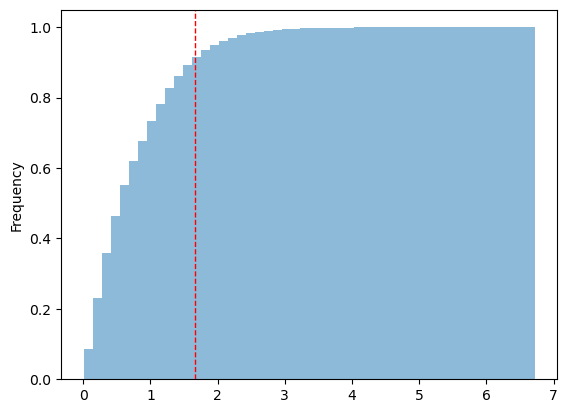

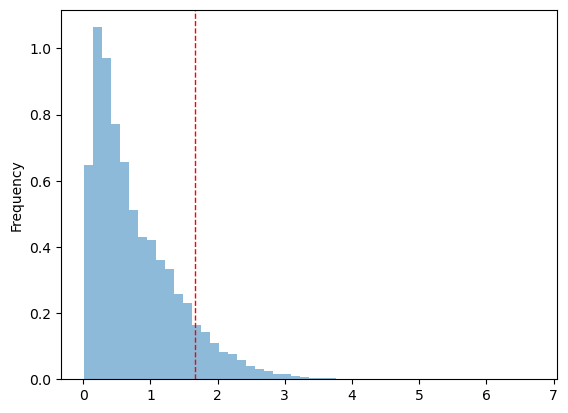

count above 90th percentile 4417
total count 44364


In [7]:
'plot the distribution of the variable to sample'
var2plot = 'max_off'
#plot cdf of variable to sample
nodeform_combine[var2plot].plot.hist(bins=50, alpha=0.5, label='deform',cumulative=True, density=True)
plt.axvline(nodeform_combine[var2plot].quantile(0.9), color='red', linestyle='dashed', linewidth=1)
plt.show()
nodeform_combine[var2plot].plot.hist(bins=50, alpha=0.5, label='deform',density=True)
plt.axvline(nodeform_combine[var2plot].quantile(0.9), color='red', linestyle='dashed', linewidth=1)
plt.show()
print('count above 90th percentile',len(nodeform_combine[nodeform_combine[var2plot]>nodeform_combine[var2plot].quantile(0.9)]))
print('total count',len(nodeform_combine))

In [8]:
#use all for deformation pretraining
deform_combine['id'].to_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/sample_events{str(len(deform_combine))}_{reg}_{columnname}.txt', header=False, index=None)

In [22]:
start = 0.1

thresh_deform = combined_half_deform['max_absdz'].quantile(0.9)
max_deform = combined_half_deform['max_absdz'].max()
total_deform = len(combined_half_deform)    

thresh_deform_off = combined_half_deform['max_off'].quantile(0.9)
max_deform_off = combined_half_deform['max_off'].max()

temp = combined_half_nodeform.groupby('source_type').get_group('BS')
thresh_BS_off = temp['max_off'].quantile(0.9)
max_BS_off = temp['max_off'].max()
total_BS_off = len(temp)
del temp

temp = combined_half_nodeform.groupby('source_type').get_group('PS')
thresh_PS_off = temp['max_off'].quantile(0.9)
max_PS_off = temp['max_off'].max()
total_PS_off = len(temp)
del temp

#total and count above threshold
count_deform = len(combined_half_deform[combined_half_deform['max_absdz']>thresh_deform])
count_def_off = len(combined_half_deform[combined_half_deform['max_off']>thresh_deform_off])


thresh_deform 2.2764000000000006 max_deform 4.5
bin_def [ 0.1         0.34182222  0.58364444  0.82546667  1.06728889  1.30911111
  1.55093333  1.79275556  2.03457778  2.2764      2.2764      2.52346667
  2.77053333  3.0176      3.26466667  3.51173333  3.7588      4.00586667
  4.25293333  4.5        99.        ] count 21
Sampling 9 events in bin (0.1, 0.34182222222222225) from 1384 events
Sampling 9 events in bin (0.34182222222222225, 0.5836444444444445) from 768 events
Sampling 9 events in bin (0.5836444444444445, 0.8254666666666668) from 506 events
Sampling 9 events in bin (0.8254666666666668, 1.0672888888888892) from 417 events
Sampling 9 events in bin (1.0672888888888892, 1.3091111111111116) from 329 events
Sampling 9 events in bin (1.3091111111111116, 1.5509333333333337) from 255 events
Sampling 9 events in bin (1.5509333333333337, 1.7927555555555559) from 189 events
Sampling 9 events in bin (1.7927555555555559, 2.0345777777777783) from 176 events
Sampling 9 events in bin (2.034577

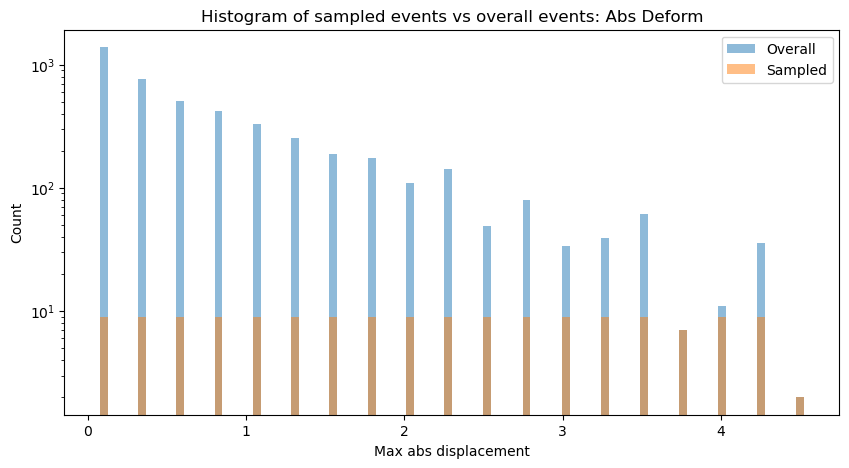

Unique sampled events: 162
thresh_deform_off 2.8 max_deform_off 6.25
bin_def [ 0.1         0.4         0.7         1.          1.3         1.6
  1.9         2.2         2.5         2.8         2.8         3.18333333
  3.56666667  3.95        4.33333333  4.71666667  5.1         5.48333333
  5.86666667  6.25       99.        ] count 21
Sampling 9 events in bin (0.1, 0.4) from 596 events
Sampling 9 events in bin (0.4, 0.7) from 789 events
Sampling 9 events in bin (0.7, 0.9999999999999999) from 644 events
Sampling 9 events in bin (0.9999999999999999, 1.3) from 586 events
Sampling 9 events in bin (1.3, 1.6) from 437 events
Sampling 9 events in bin (1.6, 1.9) from 381 events
Sampling 9 events in bin (1.9, 2.2) from 285 events
Sampling 9 events in bin (2.2, 2.5) from 224 events
Sampling 9 events in bin (2.5, 2.8) from 167 events
Sampling 9 events in bin (2.8, 2.8) from 0 events
Sampling 9 events in bin (2.8, 3.183333333333333) from 168 events
Sampling 9 events in bin (3.183333333333333, 3.566

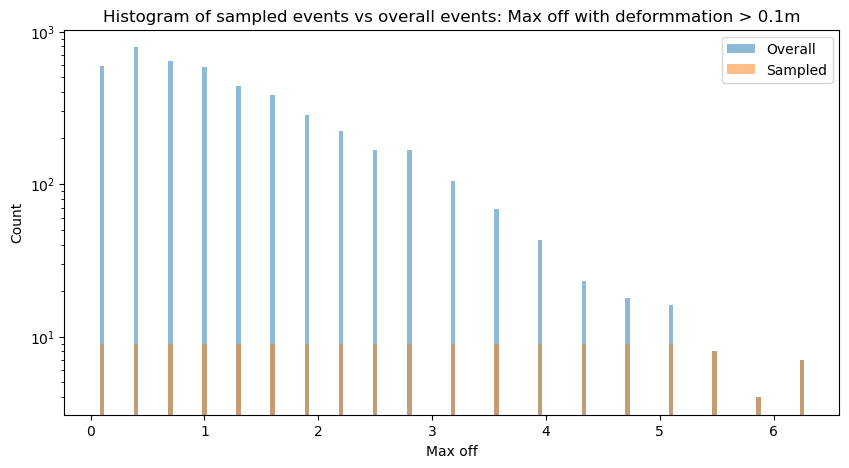

Unique sampled events: 163
thresh_BS_off 1.58 max_BS_off 4.25
bin_def [ 0.1         0.26444444  0.42888889  0.59333333  0.75777778  0.92222222
  1.08666667  1.25111111  1.41555556  1.58        1.58        1.87666667
  2.17333333  2.47        2.76666667  3.06333333  3.36        3.65666667
  3.95333333  4.25       99.        ] count 21
Sampling 9 events in bin (0.1, 0.2644444444444445) from 1294 events
Sampling 9 events in bin (0.2644444444444445, 0.4288888888888889) from 1359 events
Sampling 9 events in bin (0.4288888888888889, 0.5933333333333334) from 1199 events
Sampling 9 events in bin (0.5933333333333334, 0.7577777777777778) from 822 events
Sampling 9 events in bin (0.7577777777777778, 0.9222222222222222) from 732 events
Sampling 9 events in bin (0.9222222222222222, 1.0866666666666667) from 536 events
Sampling 9 events in bin (1.0866666666666667, 1.2511111111111113) from 446 events
Sampling 9 events in bin (1.2511111111111113, 1.4155555555555557) from 313 events
Sampling 9 events in

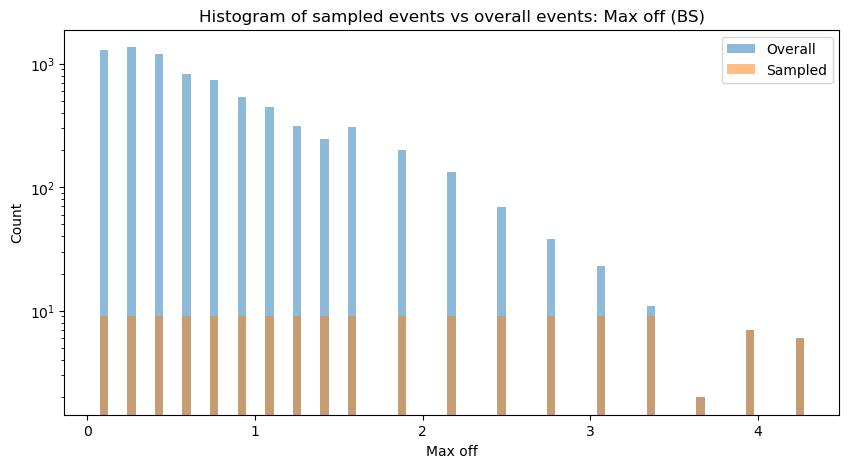

Unique sampled events: 159
thresh_PS_off 1.7 max_PS_off 3.6
bin_def [ 0.1         0.27777778  0.45555556  0.63333333  0.81111111  0.98888889
  1.16666667  1.34444444  1.52222222  1.7         1.7         1.91111111
  2.12222222  2.33333333  2.54444444  2.75555556  2.96666667  3.17777778
  3.38888889  3.6        99.        ] count 21
Sampling 27 events in bin (0.1, 0.2777777777777778) from 2892 events
Sampling 27 events in bin (0.2777777777777778, 0.4555555555555555) from 2127 events
Sampling 27 events in bin (0.4555555555555555, 0.6333333333333332) from 1752 events
Sampling 27 events in bin (0.6333333333333332, 0.811111111111111) from 1230 events
Sampling 27 events in bin (0.811111111111111, 0.9888888888888888) from 1008 events
Sampling 27 events in bin (0.9888888888888888, 1.1666666666666665) from 1048 events
Sampling 27 events in bin (1.1666666666666665, 1.3444444444444443) from 909 events
Sampling 27 events in bin (1.3444444444444443, 1.5222222222222221) from 713 events
Sampling 27 e

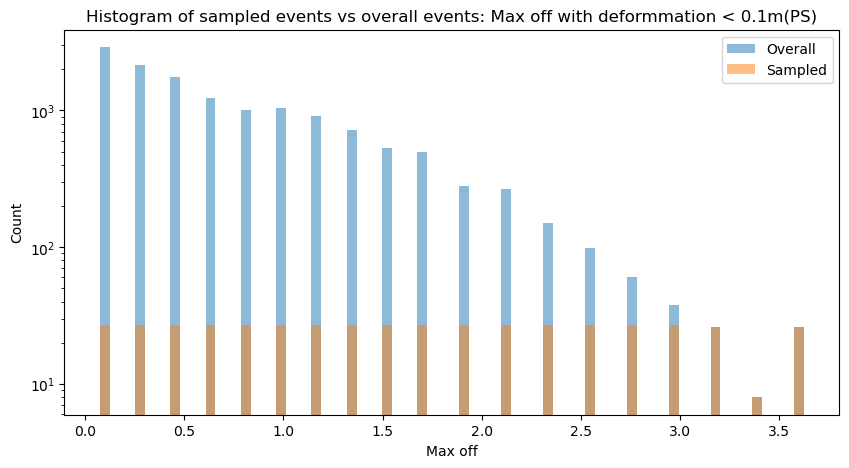

Unique sampled events: 492
test set size: 52589


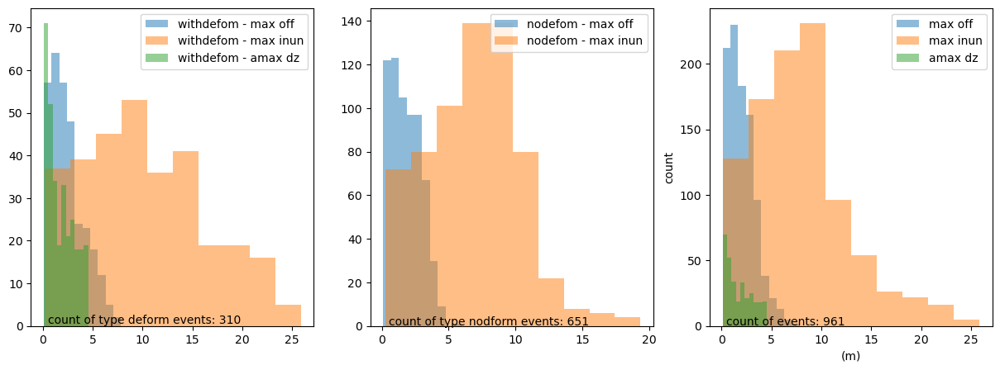

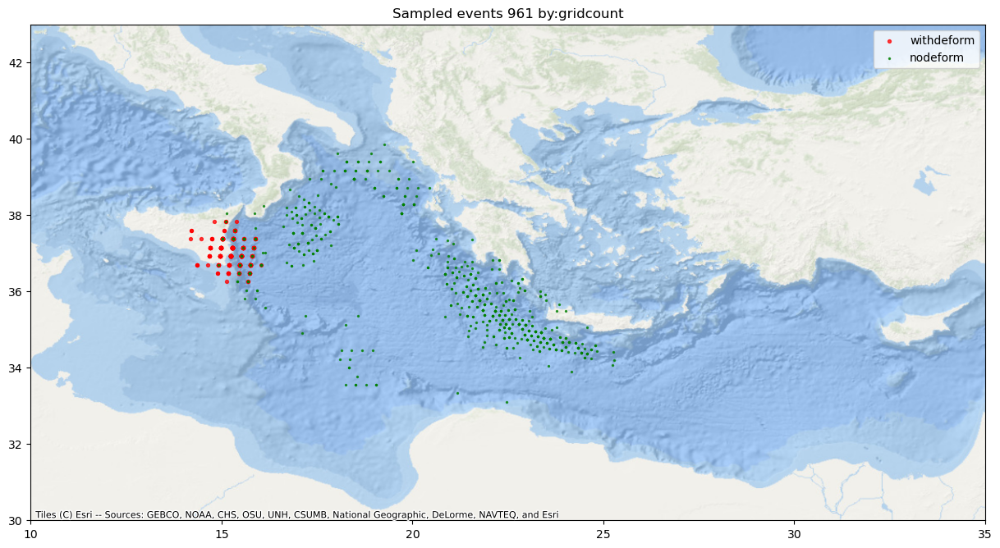

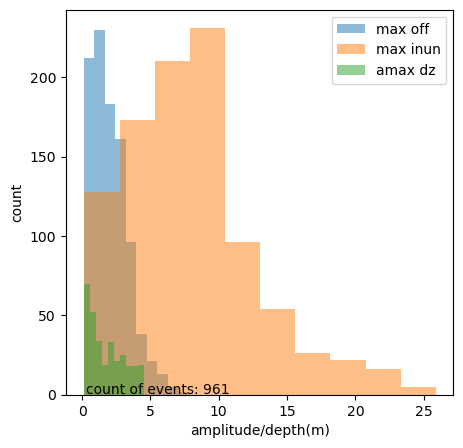

In [35]:
X = 1
#emphasis above a threshold(90%) 
max_deform = 4.5
samples_per_bin = 9 * X
bin_splits = 10

bin_def_1 =  np.linspace(start,thresh_deform,bin_splits)
bin_def_2 =  np.linspace(thresh_deform,max_deform, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_deform',thresh_deform,'max_deform',max_deform)
print('bin_def',bin_def,'count',len(bin_def))

#sample function
sample_step0 = sample_train_events(combined_half_deform.groupby('event_type').get_group(0),
                                importance_column=wt_para,
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_absdz')
#set as dataframe
sample_step0 = pd.concat(sample_step0, axis=0)

#update other parameters from combined
sample_step0 = pd.merge(sample_step0, combined, on='id', how='left')

#keep only unique events
sample_step0 = sample_step0.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_deform['max_absdz'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step0['max_absdz'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.05,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.05, alpha=0.5, label='Sampled')
ax.set(xlabel='Max abs displacement', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Abs Deform')
plt.legend()
plt.show()
print('Unique sampled events:',len(sample_step0['id'].unique()))

#override max_deform_off
max_deform_off = 6.25

bin_def_1 =  np.linspace(start,thresh_deform_off,bin_splits)
bin_def_2 =  np.linspace(thresh_deform_off,max_deform_off, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_deform_off',thresh_deform_off,'max_deform_off',max_deform_off)
print('bin_def',bin_def,'count',len(bin_def))

#sample function
sample_step1 = sample_train_events(combined_half_deform.groupby('event_type').get_group(0),
                                importance_column=wt_para,
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_off')
#set as dataframe
sample_step1 = pd.concat(sample_step1, axis=0)
#update other parameters from combined
sample_step1 = pd.merge(sample_step1, combined, on='id', how='left')
#keep only unique events
sample_step1 = sample_step1.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_deform['max_off'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step1['max_off'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.04,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.04, alpha=0.5, label='Sampled')
ax.set(xlabel='Max off', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Max off with deformmation > 0.1m')
plt.legend()
plt.show()
print('Unique sampled events:',len(sample_step1['id'].unique()))

#override max_off
max_BS_off = 4.25

bin_def_1 =  np.linspace(start,thresh_BS_off,bin_splits)
bin_def_2 =  np.linspace(thresh_BS_off,max_BS_off, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_BS_off',thresh_BS_off,'max_BS_off',max_BS_off)
print('bin_def',bin_def,'count',len(bin_def))


sample_step3 = sample_train_events(combined_half_nodeform.groupby('source_type').get_group('BS'),
                                importance_column=wt_para, 
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_off')

#set as dataframe
sample_step3 = pd.concat(sample_step3, axis=0)
#update other parameters from combined
sample_step3 = pd.merge(sample_step3, combined, on='id', how='left')
#keep only unique events
sample_step3 = sample_step3.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_nodeform.groupby('source_type').get_group('BS')['max_off'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step3['max_off'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.05,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.05, alpha=0.5, label='Sampled')
ax.set(xlabel='Max off', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Max off (BS)')
plt.legend()
plt.show()
print('Unique sampled events:',len(sample_step3['id'].unique()))

#override max
samples_per_bin = samples_per_bin *3
max_PS_off = 3.6

bin_def_1 =  np.linspace(start,thresh_PS_off,bin_splits)
bin_def_2 =  np.linspace(thresh_PS_off,max_PS_off, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_PS_off',thresh_PS_off,'max_PS_off',max_PS_off)
print('bin_def',bin_def,'count',len(bin_def))


sample_step2 = sample_train_events(combined_half_nodeform.groupby('source_type').get_group('PS'),
                                importance_column=wt_para, 
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_off')

#set as dataframe
sample_step2 = pd.concat(sample_step2, axis=0)
#update other parameters from combined
sample_step2 = pd.merge(sample_step2, combined, on='id', how='left')
#keep only unique events
sample_step2 = sample_step2.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_nodeform.groupby('source_type').get_group('PS')['max_off'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step2['max_off'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.05,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.05, alpha=0.5, label='Sampled')
ax.set(xlabel='Max off', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Max off with deformmation < 0.1m(PS)')
plt.legend()
plt.show()

print('Unique sampled events:',len(sample_step2['id'].unique()))
#merge samples to get final sample
sample_test = pd.concat([sample_step0,sample_step1,sample_step2,sample_step3], axis=0)
#keep only unique events
sample_test = sample_test.drop_duplicates(subset=['id'])

#check if plot folder exists
if not os.path.exists(MLDir + f'/model/{reg}/plot'):
    os.makedirs(MLDir + f'/model/{reg}/plot')


#plot 
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].hist(sample_test[sample_test['event_type']==0]['max_off'], bins=bin_splits, alpha=0.5, label='withdefom - max off')
axs[0].hist(sample_test[sample_test['event_type']==0]['dmax'], bins=bin_splits, alpha=0.5, label='withdefom - max inun')
axs[0].hist(sample_test[sample_test['event_type']==0]['max_absdz'], bins=bin_splits, alpha=0.5, label='withdefom - amax dz')
axs[0].text(0.5, 0.5, 'count of type deform events: '+str(len(sample_test[sample_test['event_type']==0])))
axs[0].legend(loc='upper right')

axs[1].hist(sample_test[sample_test['event_type']==1]['max_off'], bins=bin_splits, alpha=0.5, label='nodefom - max off')
axs[1].hist(sample_test[sample_test['event_type']==1]['dmax'], bins=bin_splits, alpha=0.5, label='nodefom - max inun')
axs[1].text(0.5, 0.5,'count of type nodform events: '+str(len(sample_test[sample_test['event_type']==1])))
axs[1].legend(loc='upper right')

axs[2].hist(sample_test['max_off'], bins=bin_splits, alpha=0.5, label='max off')
axs[2].hist(sample_test['dmax'], bins=bin_splits, alpha=0.5, label='max inun')
axs[2].hist(sample_test[sample_test['max_absdz']>0.1]['max_absdz'], bins=bin_splits, alpha=0.5, label='amax dz')
axs[2].text(0.5, 0.5, 'count of events: '+str(len(sample_test['id'].unique())))
axs[2].legend(loc='upper right')
#label axes
axs[2].set(xlabel='(m)', ylabel='count')
plt.savefig(MLDir + f'/model/{reg}/plot/sampledist_events_splits{str(len(sample_test))}_{reg}_{columnname}.png', bbox_inches='tight')

fig, ax = plt.subplots(figsize=(15,10))
ax.title.set_text('Sampled events ' + str(len(sample_test)) + ' by:' + wt_para)
ax = plt.scatter(sample_test[sample_test['event_type']==0]['lon'], sample_test[sample_test['event_type']==0]['lat'], alpha=0.75, label='withdeform',s=8, color='red')
ax = plt.scatter(sample_test[sample_test['event_type']==1]['lon'], sample_test[sample_test['event_type']==1]['lat'], alpha=0.75, label='nodeform', s=2, color='green')
plt.legend(loc='upper right')
plt.xlim(10, 35)
plt.ylim(30, 43)
ax = plt.gca()
cx.add_basemap(ax,crs='EPSG:4326', source=cx.providers.Esri.OceanBasemap)
plt.savefig(MLDir + f'/model/{reg}/plot/samplemap_events{str(len(sample_test))}_{reg}_{columnname}.png', bbox_inches='tight')

fig, axs = plt.subplots(1, 1, figsize=(5, 5))
axs.hist(sample_test['max_off'], bins=bin_splits, alpha=0.5, label='max off')
axs.hist(sample_test['dmax'], bins=bin_splits, alpha=0.5, label='max inun')
axs.hist(sample_test[sample_test['max_absdz']>0.1]['max_absdz'], bins=bin_splits, alpha=0.5, label='amax dz')
axs.text(0.25, 0.5, 'count of events: '+str(len(sample_test['id'].unique())))
axs.legend(loc='upper right')
#label axes
axs.set(xlabel='amplitude/depth(m)', ylabel='count')
plt.savefig(MLDir + f'/model/{reg}/plot/sampledist_events{str(len(sample_test))}_{reg}_{columnname}.png', bbox_inches='tight')

#save list of ids to txt file for training
#for building model
sample_test['id'].to_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/sample_events{str(len(sample_test))}_{reg}_{columnname}.txt', header=False, index=None)

#evaluation of model by removing sample from combined ie the test set
test = combined[~combined['id'].isin(sample_test['id'])]
len_test = len(test['id'].unique())
print('test set size:',len_test)
pd.DataFrame(test['id'].unique()).to_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/shuffled_events_test_{reg}_{str(len_test)}_{str(len(sample_test))}.txt', header=False, index=None)


thresh_deform 2.2764000000000006 max_deform 4.5
bin_def [ 0.1         0.34182222  0.58364444  0.82546667  1.06728889  1.30911111
  1.55093333  1.79275556  2.03457778  2.2764      2.2764      2.52346667
  2.77053333  3.0176      3.26466667  3.51173333  3.7588      4.00586667
  4.25293333  4.5        99.        ] count 21
Sampling 18 events in bin (0.1, 0.34182222222222225) from 1384 events
Sampling 18 events in bin (0.34182222222222225, 0.5836444444444445) from 768 events
Sampling 18 events in bin (0.5836444444444445, 0.8254666666666668) from 506 events
Sampling 18 events in bin (0.8254666666666668, 1.0672888888888892) from 417 events
Sampling 18 events in bin (1.0672888888888892, 1.3091111111111116) from 329 events
Sampling 18 events in bin (1.3091111111111116, 1.5509333333333337) from 255 events
Sampling 18 events in bin (1.5509333333333337, 1.7927555555555559) from 189 events
Sampling 18 events in bin (1.7927555555555559, 2.0345777777777783) from 176 events
Sampling 18 events in bin 

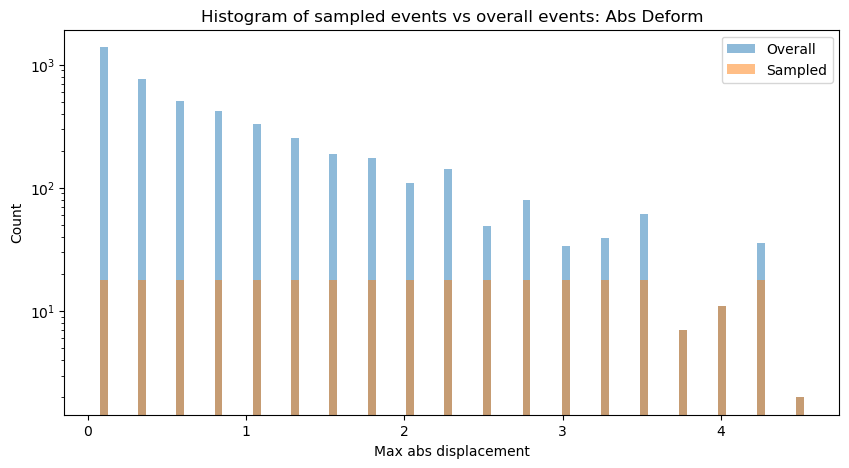

Unique sampled events: 308
thresh_deform_off 2.8 max_deform_off 6.25
bin_def [ 0.1         0.4         0.7         1.          1.3         1.6
  1.9         2.2         2.5         2.8         2.8         3.18333333
  3.56666667  3.95        4.33333333  4.71666667  5.1         5.48333333
  5.86666667  6.25       99.        ] count 21
Sampling 18 events in bin (0.1, 0.4) from 596 events
Sampling 18 events in bin (0.4, 0.7) from 789 events
Sampling 18 events in bin (0.7, 0.9999999999999999) from 644 events
Sampling 18 events in bin (0.9999999999999999, 1.3) from 586 events
Sampling 18 events in bin (1.3, 1.6) from 437 events
Sampling 18 events in bin (1.6, 1.9) from 381 events
Sampling 18 events in bin (1.9, 2.2) from 285 events
Sampling 18 events in bin (2.2, 2.5) from 224 events
Sampling 18 events in bin (2.5, 2.8) from 167 events
Sampling 18 events in bin (2.8, 2.8) from 0 events
Sampling 18 events in bin (2.8, 3.183333333333333) from 168 events
Sampling 18 events in bin (3.1833333333

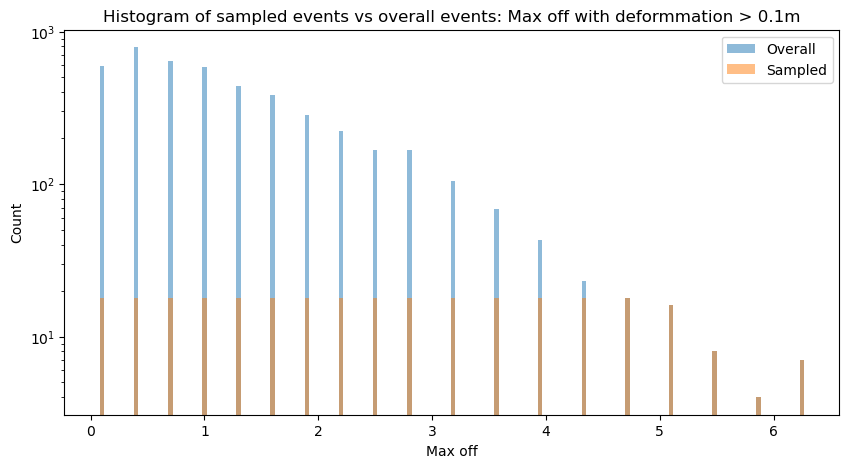

Unique sampled events: 305
thresh_BS_off 1.58 max_BS_off 4.25
bin_def [ 0.1         0.26444444  0.42888889  0.59333333  0.75777778  0.92222222
  1.08666667  1.25111111  1.41555556  1.58        1.58        1.87666667
  2.17333333  2.47        2.76666667  3.06333333  3.36        3.65666667
  3.95333333  4.25       99.        ] count 21
Sampling 18 events in bin (0.1, 0.2644444444444445) from 1294 events
Sampling 18 events in bin (0.2644444444444445, 0.4288888888888889) from 1359 events
Sampling 18 events in bin (0.4288888888888889, 0.5933333333333334) from 1199 events
Sampling 18 events in bin (0.5933333333333334, 0.7577777777777778) from 822 events
Sampling 18 events in bin (0.7577777777777778, 0.9222222222222222) from 732 events
Sampling 18 events in bin (0.9222222222222222, 1.0866666666666667) from 536 events
Sampling 18 events in bin (1.0866666666666667, 1.2511111111111113) from 446 events
Sampling 18 events in bin (1.2511111111111113, 1.4155555555555557) from 313 events
Sampling 18 

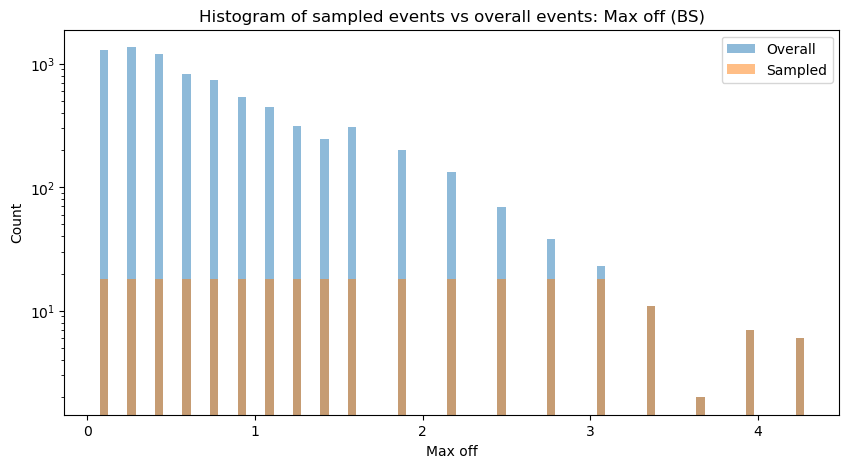

Unique sampled events: 296
thresh_PS_off 1.7 max_PS_off 3.6
bin_def [ 0.1         0.27777778  0.45555556  0.63333333  0.81111111  0.98888889
  1.16666667  1.34444444  1.52222222  1.7         1.7         1.91111111
  2.12222222  2.33333333  2.54444444  2.75555556  2.96666667  3.17777778
  3.38888889  3.6        99.        ] count 21
Sampling 54 events in bin (0.1, 0.2777777777777778) from 2892 events
Sampling 54 events in bin (0.2777777777777778, 0.4555555555555555) from 2127 events
Sampling 54 events in bin (0.4555555555555555, 0.6333333333333332) from 1752 events
Sampling 54 events in bin (0.6333333333333332, 0.811111111111111) from 1230 events
Sampling 54 events in bin (0.811111111111111, 0.9888888888888888) from 1008 events
Sampling 54 events in bin (0.9888888888888888, 1.1666666666666665) from 1048 events
Sampling 54 events in bin (1.1666666666666665, 1.3444444444444443) from 909 events
Sampling 54 events in bin (1.3444444444444443, 1.5222222222222221) from 713 events
Sampling 54 e

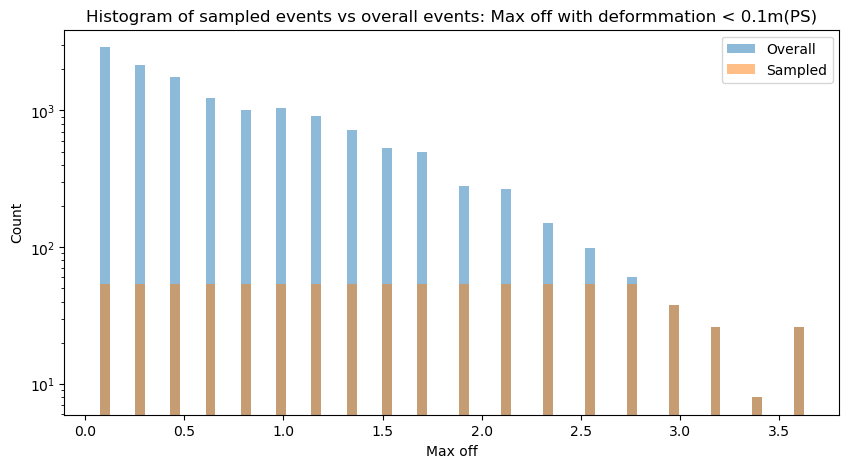

Unique sampled events: 908
test set size: 51777


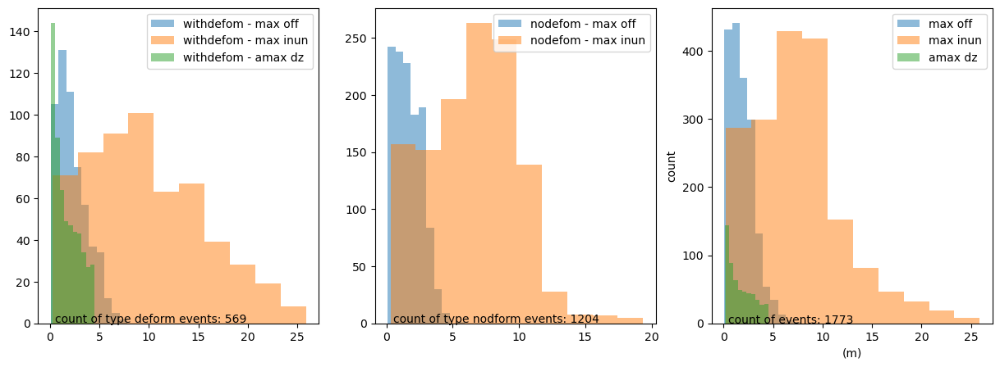

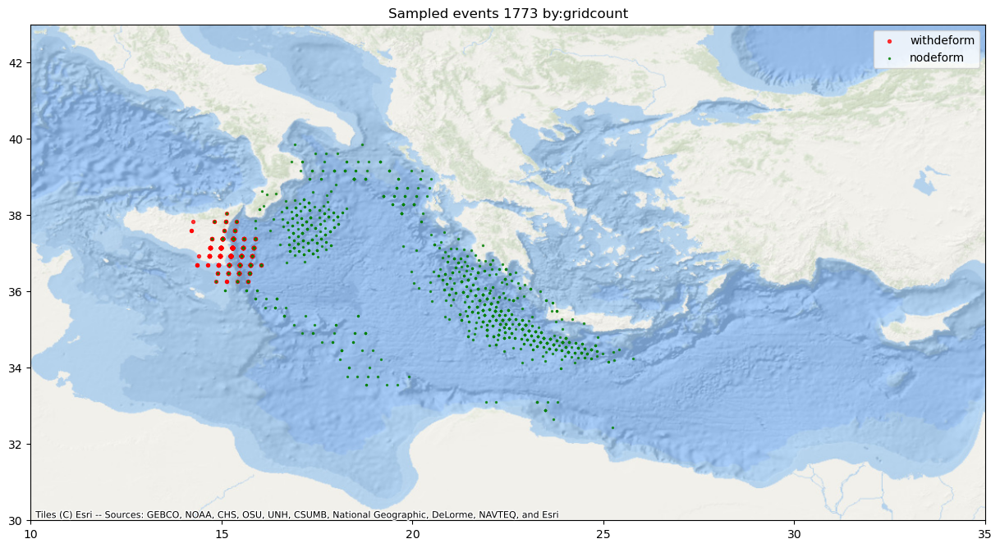

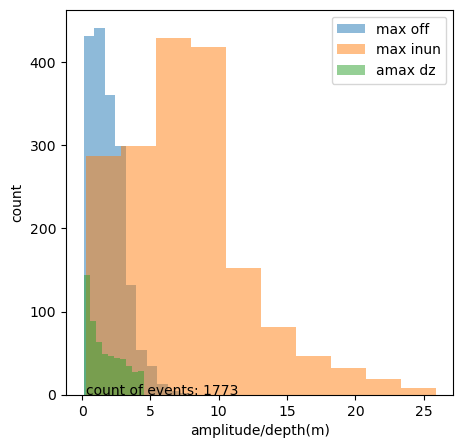

In [36]:
X = 1
#emphasis above a threshold(90%) 
max_deform = 4.5
samples_per_bin = 18 * X
bin_splits = 10

bin_def_1 =  np.linspace(start,thresh_deform,bin_splits)
bin_def_2 =  np.linspace(thresh_deform,max_deform, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_deform',thresh_deform,'max_deform',max_deform)
print('bin_def',bin_def,'count',len(bin_def))

#sample function
sample_step0 = sample_train_events(combined_half_deform.groupby('event_type').get_group(0),
                                importance_column=wt_para,
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_absdz')
#set as dataframe
sample_step0 = pd.concat(sample_step0, axis=0)

#update other parameters from combined
sample_step0 = pd.merge(sample_step0, combined, on='id', how='left')

#keep only unique events
sample_step0 = sample_step0.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_deform['max_absdz'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step0['max_absdz'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.05,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.05, alpha=0.5, label='Sampled')
ax.set(xlabel='Max abs displacement', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Abs Deform')
plt.legend()
plt.show()
print('Unique sampled events:',len(sample_step0['id'].unique()))

#override max_deform_off
max_deform_off = 6.25

bin_def_1 =  np.linspace(start,thresh_deform_off,bin_splits)
bin_def_2 =  np.linspace(thresh_deform_off,max_deform_off, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_deform_off',thresh_deform_off,'max_deform_off',max_deform_off)
print('bin_def',bin_def,'count',len(bin_def))

#sample function
sample_step1 = sample_train_events(combined_half_deform.groupby('event_type').get_group(0),
                                importance_column=wt_para,
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_off')
#set as dataframe
sample_step1 = pd.concat(sample_step1, axis=0)
#update other parameters from combined
sample_step1 = pd.merge(sample_step1, combined, on='id', how='left')
#keep only unique events
sample_step1 = sample_step1.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_deform['max_off'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step1['max_off'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.04,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.04, alpha=0.5, label='Sampled')
ax.set(xlabel='Max off', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Max off with deformmation > 0.1m')
plt.legend()
plt.show()
print('Unique sampled events:',len(sample_step1['id'].unique()))

#override max_off
max_BS_off = 4.25

bin_def_1 =  np.linspace(start,thresh_BS_off,bin_splits)
bin_def_2 =  np.linspace(thresh_BS_off,max_BS_off, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_BS_off',thresh_BS_off,'max_BS_off',max_BS_off)
print('bin_def',bin_def,'count',len(bin_def))


sample_step3 = sample_train_events(combined_half_nodeform.groupby('source_type').get_group('BS'),
                                importance_column=wt_para, 
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_off')

#set as dataframe
sample_step3 = pd.concat(sample_step3, axis=0)
#update other parameters from combined
sample_step3 = pd.merge(sample_step3, combined, on='id', how='left')
#keep only unique events
sample_step3 = sample_step3.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_nodeform.groupby('source_type').get_group('BS')['max_off'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step3['max_off'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.05,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.05, alpha=0.5, label='Sampled')
ax.set(xlabel='Max off', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Max off (BS)')
plt.legend()
plt.show()
print('Unique sampled events:',len(sample_step3['id'].unique()))

#override max
samples_per_bin = samples_per_bin *3
max_PS_off = 3.6

bin_def_1 =  np.linspace(start,thresh_PS_off,bin_splits)
bin_def_2 =  np.linspace(thresh_PS_off,max_PS_off, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_PS_off',thresh_PS_off,'max_PS_off',max_PS_off)
print('bin_def',bin_def,'count',len(bin_def))


sample_step2 = sample_train_events(combined_half_nodeform.groupby('source_type').get_group('PS'),
                                importance_column=wt_para, 
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_off')

#set as dataframe
sample_step2 = pd.concat(sample_step2, axis=0)
#update other parameters from combined
sample_step2 = pd.merge(sample_step2, combined, on='id', how='left')
#keep only unique events
sample_step2 = sample_step2.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_nodeform.groupby('source_type').get_group('PS')['max_off'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step2['max_off'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.05,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.05, alpha=0.5, label='Sampled')
ax.set(xlabel='Max off', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Max off with deformmation < 0.1m(PS)')
plt.legend()
plt.show()

print('Unique sampled events:',len(sample_step2['id'].unique()))
#merge samples to get final sample
sample_test = pd.concat([sample_step0,sample_step1,sample_step2,sample_step3], axis=0)
#keep only unique events
sample_test = sample_test.drop_duplicates(subset=['id'])

#check if plot folder exists
if not os.path.exists(MLDir + f'/model/{reg}/plot'):
    os.makedirs(MLDir + f'/model/{reg}/plot')


#plot 
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].hist(sample_test[sample_test['event_type']==0]['max_off'], bins=bin_splits, alpha=0.5, label='withdefom - max off')
axs[0].hist(sample_test[sample_test['event_type']==0]['dmax'], bins=bin_splits, alpha=0.5, label='withdefom - max inun')
axs[0].hist(sample_test[sample_test['event_type']==0]['max_absdz'], bins=bin_splits, alpha=0.5, label='withdefom - amax dz')
axs[0].text(0.5, 0.5, 'count of type deform events: '+str(len(sample_test[sample_test['event_type']==0])))
axs[0].legend(loc='upper right')

axs[1].hist(sample_test[sample_test['event_type']==1]['max_off'], bins=bin_splits, alpha=0.5, label='nodefom - max off')
axs[1].hist(sample_test[sample_test['event_type']==1]['dmax'], bins=bin_splits, alpha=0.5, label='nodefom - max inun')
axs[1].text(0.5, 0.5,'count of type nodform events: '+str(len(sample_test[sample_test['event_type']==1])))
axs[1].legend(loc='upper right')

axs[2].hist(sample_test['max_off'], bins=bin_splits, alpha=0.5, label='max off')
axs[2].hist(sample_test['dmax'], bins=bin_splits, alpha=0.5, label='max inun')
axs[2].hist(sample_test[sample_test['max_absdz']>0.1]['max_absdz'], bins=bin_splits, alpha=0.5, label='amax dz')
axs[2].text(0.5, 0.5, 'count of events: '+str(len(sample_test['id'].unique())))
axs[2].legend(loc='upper right')
#label axes
axs[2].set(xlabel='(m)', ylabel='count')
plt.savefig(MLDir + f'/model/{reg}/plot/sampledist_events_splits{str(len(sample_test))}_{reg}_{columnname}.png', bbox_inches='tight')

fig, ax = plt.subplots(figsize=(15,10))
ax.title.set_text('Sampled events ' + str(len(sample_test)) + ' by:' + wt_para)
ax = plt.scatter(sample_test[sample_test['event_type']==0]['lon'], sample_test[sample_test['event_type']==0]['lat'], alpha=0.75, label='withdeform',s=8, color='red')
ax = plt.scatter(sample_test[sample_test['event_type']==1]['lon'], sample_test[sample_test['event_type']==1]['lat'], alpha=0.75, label='nodeform', s=2, color='green')
plt.legend(loc='upper right')
plt.xlim(10, 35)
plt.ylim(30, 43)
ax = plt.gca()
cx.add_basemap(ax,crs='EPSG:4326', source=cx.providers.Esri.OceanBasemap)
plt.savefig(MLDir + f'/model/{reg}/plot/samplemap_events{str(len(sample_test))}_{reg}_{columnname}.png', bbox_inches='tight')

fig, axs = plt.subplots(1, 1, figsize=(5, 5))
axs.hist(sample_test['max_off'], bins=bin_splits, alpha=0.5, label='max off')
axs.hist(sample_test['dmax'], bins=bin_splits, alpha=0.5, label='max inun')
axs.hist(sample_test[sample_test['max_absdz']>0.1]['max_absdz'], bins=bin_splits, alpha=0.5, label='amax dz')
axs.text(0.25, 0.5, 'count of events: '+str(len(sample_test['id'].unique())))
axs.legend(loc='upper right')
#label axes
axs.set(xlabel='amplitude/depth(m)', ylabel='count')
plt.savefig(MLDir + f'/model/{reg}/plot/sampledist_events{str(len(sample_test))}_{reg}_{columnname}.png', bbox_inches='tight')

#save list of ids to txt file for training
#for building model
sample_test['id'].to_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/sample_events{str(len(sample_test))}_{reg}_{columnname}.txt', header=False, index=None)

#evaluation of model by removing sample from combined ie the test set
test = combined[~combined['id'].isin(sample_test['id'])]
len_test = len(test['id'].unique())
print('test set size:',len_test)
pd.DataFrame(test['id'].unique()).to_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/shuffled_events_test_{reg}_{str(len_test)}_{str(len(sample_test))}.txt', header=False, index=None)


thresh_deform 2.2764000000000006 max_deform 4.5
bin_def [ 0.1         0.34182222  0.58364444  0.82546667  1.06728889  1.30911111
  1.55093333  1.79275556  2.03457778  2.2764      2.2764      2.52346667
  2.77053333  3.0176      3.26466667  3.51173333  3.7588      4.00586667
  4.25293333  4.5        99.        ] count 21
Sampling 42 events in bin (0.1, 0.34182222222222225) from 1384 events
Sampling 42 events in bin (0.34182222222222225, 0.5836444444444445) from 768 events
Sampling 42 events in bin (0.5836444444444445, 0.8254666666666668) from 506 events
Sampling 42 events in bin (0.8254666666666668, 1.0672888888888892) from 417 events
Sampling 42 events in bin (1.0672888888888892, 1.3091111111111116) from 329 events
Sampling 42 events in bin (1.3091111111111116, 1.5509333333333337) from 255 events
Sampling 42 events in bin (1.5509333333333337, 1.7927555555555559) from 189 events
Sampling 42 events in bin (1.7927555555555559, 2.0345777777777783) from 176 events
Sampling 42 events in bin 

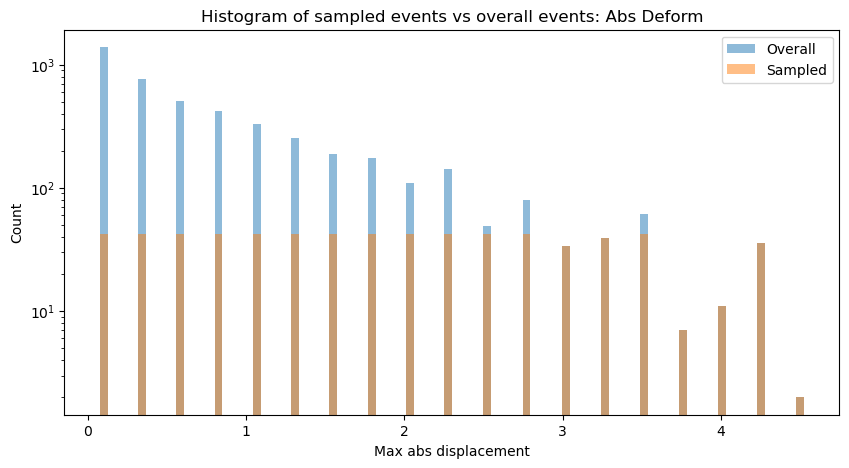

Unique sampled events: 675
thresh_deform_off 2.8 max_deform_off 6.25
bin_def [ 0.1         0.4         0.7         1.          1.3         1.6
  1.9         2.2         2.5         2.8         2.8         3.18333333
  3.56666667  3.95        4.33333333  4.71666667  5.1         5.48333333
  5.86666667  6.25       99.        ] count 21
Sampling 42 events in bin (0.1, 0.4) from 596 events
Sampling 42 events in bin (0.4, 0.7) from 789 events
Sampling 42 events in bin (0.7, 0.9999999999999999) from 644 events
Sampling 42 events in bin (0.9999999999999999, 1.3) from 586 events
Sampling 42 events in bin (1.3, 1.6) from 437 events
Sampling 42 events in bin (1.6, 1.9) from 381 events
Sampling 42 events in bin (1.9, 2.2) from 285 events
Sampling 42 events in bin (2.2, 2.5) from 224 events
Sampling 42 events in bin (2.5, 2.8) from 167 events
Sampling 42 events in bin (2.8, 2.8) from 0 events
Sampling 42 events in bin (2.8, 3.183333333333333) from 168 events
Sampling 42 events in bin (3.1833333333

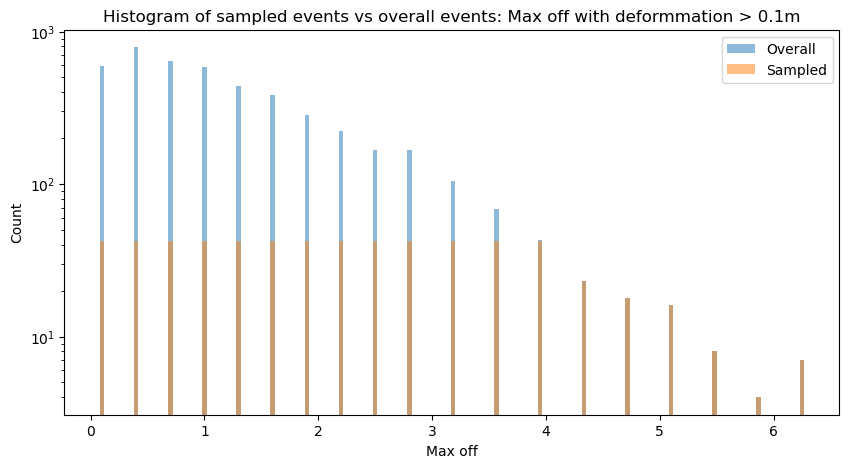

Unique sampled events: 622
thresh_BS_off 1.58 max_BS_off 4.25
bin_def [ 0.1         0.26444444  0.42888889  0.59333333  0.75777778  0.92222222
  1.08666667  1.25111111  1.41555556  1.58        1.58        1.87666667
  2.17333333  2.47        2.76666667  3.06333333  3.36        3.65666667
  3.95333333  4.25       99.        ] count 21
Sampling 42 events in bin (0.1, 0.2644444444444445) from 1294 events
Sampling 42 events in bin (0.2644444444444445, 0.4288888888888889) from 1359 events
Sampling 42 events in bin (0.4288888888888889, 0.5933333333333334) from 1199 events
Sampling 42 events in bin (0.5933333333333334, 0.7577777777777778) from 822 events
Sampling 42 events in bin (0.7577777777777778, 0.9222222222222222) from 732 events
Sampling 42 events in bin (0.9222222222222222, 1.0866666666666667) from 536 events
Sampling 42 events in bin (1.0866666666666667, 1.2511111111111113) from 446 events
Sampling 42 events in bin (1.2511111111111113, 1.4155555555555557) from 313 events
Sampling 42 

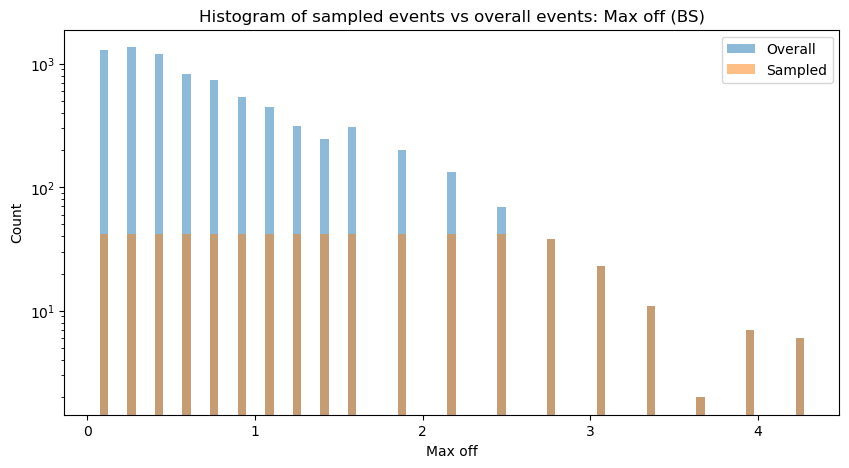

Unique sampled events: 633
thresh_PS_off 1.7 max_PS_off 3.6
bin_def [ 0.1         0.27777778  0.45555556  0.63333333  0.81111111  0.98888889
  1.16666667  1.34444444  1.52222222  1.7         1.7         1.91111111
  2.12222222  2.33333333  2.54444444  2.75555556  2.96666667  3.17777778
  3.38888889  3.6        99.        ] count 21
Sampling 126 events in bin (0.1, 0.2777777777777778) from 2892 events
Sampling 126 events in bin (0.2777777777777778, 0.4555555555555555) from 2127 events
Sampling 126 events in bin (0.4555555555555555, 0.6333333333333332) from 1752 events
Sampling 126 events in bin (0.6333333333333332, 0.811111111111111) from 1230 events
Sampling 126 events in bin (0.811111111111111, 0.9888888888888888) from 1008 events
Sampling 126 events in bin (0.9888888888888888, 1.1666666666666665) from 1048 events
Sampling 126 events in bin (1.1666666666666665, 1.3444444444444443) from 909 events
Sampling 126 events in bin (1.3444444444444443, 1.5222222222222221) from 713 events
Sampl

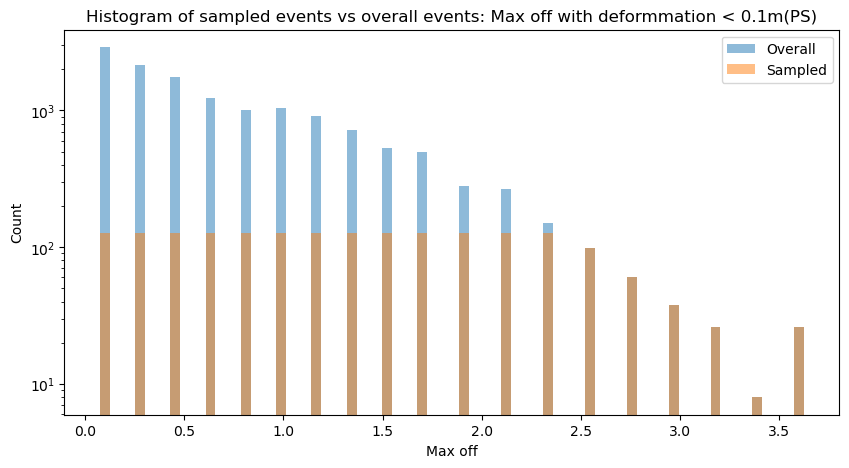

Unique sampled events: 1895
test set size: 49881


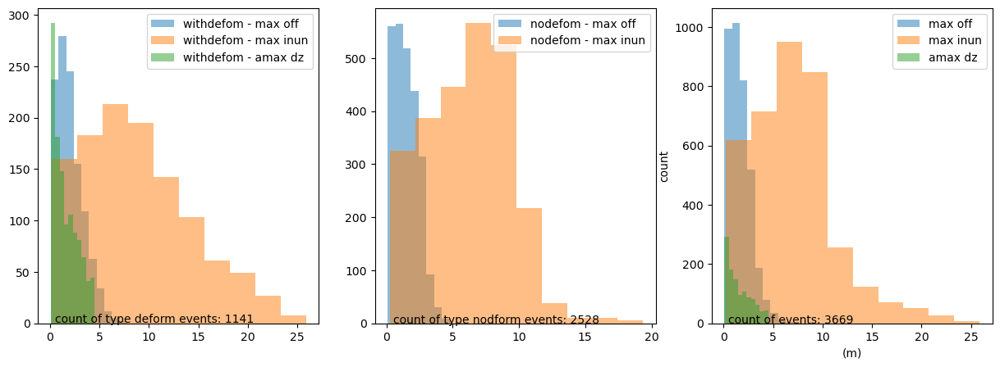

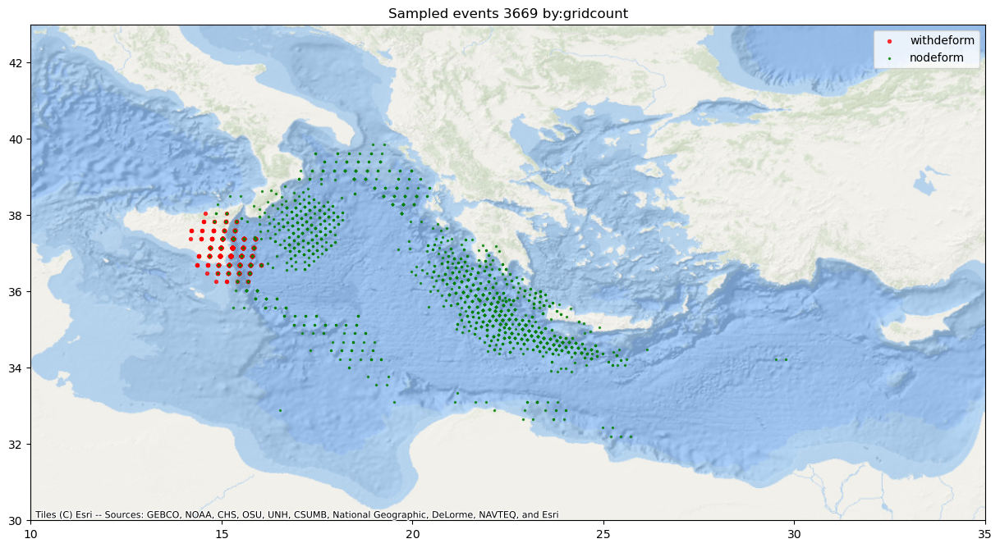

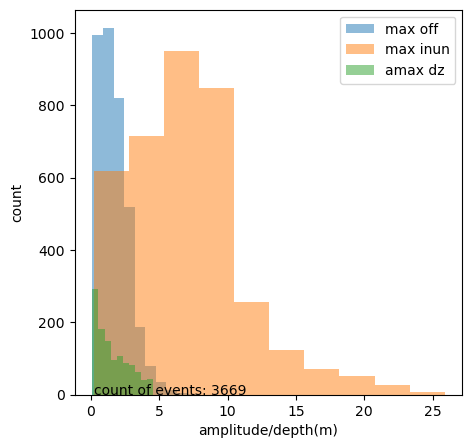

In [37]:
X = 2
#emphasis above a threshold(90%) 
max_deform = 4.5
samples_per_bin = 21 * X
bin_splits = 10

bin_def_1 =  np.linspace(start,thresh_deform,bin_splits)
bin_def_2 =  np.linspace(thresh_deform,max_deform, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_deform',thresh_deform,'max_deform',max_deform)
print('bin_def',bin_def,'count',len(bin_def))

#sample function
sample_step0 = sample_train_events(combined_half_deform.groupby('event_type').get_group(0),
                                importance_column=wt_para,
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_absdz')
#set as dataframe
sample_step0 = pd.concat(sample_step0, axis=0)

#update other parameters from combined
sample_step0 = pd.merge(sample_step0, combined, on='id', how='left')

#keep only unique events
sample_step0 = sample_step0.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_deform['max_absdz'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step0['max_absdz'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.05,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.05, alpha=0.5, label='Sampled')
ax.set(xlabel='Max abs displacement', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Abs Deform')
plt.legend()
plt.show()
print('Unique sampled events:',len(sample_step0['id'].unique()))

#override max_deform_off
max_deform_off = 6.25

bin_def_1 =  np.linspace(start,thresh_deform_off,bin_splits)
bin_def_2 =  np.linspace(thresh_deform_off,max_deform_off, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_deform_off',thresh_deform_off,'max_deform_off',max_deform_off)
print('bin_def',bin_def,'count',len(bin_def))

#sample function
sample_step1 = sample_train_events(combined_half_deform.groupby('event_type').get_group(0),
                                importance_column=wt_para,
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_off')
#set as dataframe
sample_step1 = pd.concat(sample_step1, axis=0)
#update other parameters from combined
sample_step1 = pd.merge(sample_step1, combined, on='id', how='left')
#keep only unique events
sample_step1 = sample_step1.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_deform['max_off'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step1['max_off'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.04,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.04, alpha=0.5, label='Sampled')
ax.set(xlabel='Max off', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Max off with deformmation > 0.1m')
plt.legend()
plt.show()
print('Unique sampled events:',len(sample_step1['id'].unique()))

#override max_off
max_BS_off = 4.25

bin_def_1 =  np.linspace(start,thresh_BS_off,bin_splits)
bin_def_2 =  np.linspace(thresh_BS_off,max_BS_off, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_BS_off',thresh_BS_off,'max_BS_off',max_BS_off)
print('bin_def',bin_def,'count',len(bin_def))


sample_step3 = sample_train_events(combined_half_nodeform.groupby('source_type').get_group('BS'),
                                importance_column=wt_para, 
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_off')

#set as dataframe
sample_step3 = pd.concat(sample_step3, axis=0)
#update other parameters from combined
sample_step3 = pd.merge(sample_step3, combined, on='id', how='left')
#keep only unique events
sample_step3 = sample_step3.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_nodeform.groupby('source_type').get_group('BS')['max_off'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step3['max_off'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.05,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.05, alpha=0.5, label='Sampled')
ax.set(xlabel='Max off', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Max off (BS)')
plt.legend()
plt.show()
print('Unique sampled events:',len(sample_step3['id'].unique()))

#override max
samples_per_bin = samples_per_bin *3
max_PS_off = 3.6

bin_def_1 =  np.linspace(start,thresh_PS_off,bin_splits)
bin_def_2 =  np.linspace(thresh_PS_off,max_PS_off, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_PS_off',thresh_PS_off,'max_PS_off',max_PS_off)
print('bin_def',bin_def,'count',len(bin_def))


sample_step2 = sample_train_events(combined_half_nodeform.groupby('source_type').get_group('PS'),
                                importance_column=wt_para, 
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_off')

#set as dataframe
sample_step2 = pd.concat(sample_step2, axis=0)
#update other parameters from combined
sample_step2 = pd.merge(sample_step2, combined, on='id', how='left')
#keep only unique events
sample_step2 = sample_step2.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_nodeform.groupby('source_type').get_group('PS')['max_off'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step2['max_off'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.05,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.05, alpha=0.5, label='Sampled')
ax.set(xlabel='Max off', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Max off with deformmation < 0.1m(PS)')
plt.legend()
plt.show()

print('Unique sampled events:',len(sample_step2['id'].unique()))
#merge samples to get final sample
sample_test = pd.concat([sample_step0,sample_step1,sample_step2,sample_step3], axis=0)
#keep only unique events
sample_test = sample_test.drop_duplicates(subset=['id'])

#check if plot folder exists
if not os.path.exists(MLDir + f'/model/{reg}/plot'):
    os.makedirs(MLDir + f'/model/{reg}/plot')


#plot 
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].hist(sample_test[sample_test['event_type']==0]['max_off'], bins=bin_splits, alpha=0.5, label='withdefom - max off')
axs[0].hist(sample_test[sample_test['event_type']==0]['dmax'], bins=bin_splits, alpha=0.5, label='withdefom - max inun')
axs[0].hist(sample_test[sample_test['event_type']==0]['max_absdz'], bins=bin_splits, alpha=0.5, label='withdefom - amax dz')
axs[0].text(0.5, 0.5, 'count of type deform events: '+str(len(sample_test[sample_test['event_type']==0])))
axs[0].legend(loc='upper right')

axs[1].hist(sample_test[sample_test['event_type']==1]['max_off'], bins=bin_splits, alpha=0.5, label='nodefom - max off')
axs[1].hist(sample_test[sample_test['event_type']==1]['dmax'], bins=bin_splits, alpha=0.5, label='nodefom - max inun')
axs[1].text(0.5, 0.5,'count of type nodform events: '+str(len(sample_test[sample_test['event_type']==1])))
axs[1].legend(loc='upper right')

axs[2].hist(sample_test['max_off'], bins=bin_splits, alpha=0.5, label='max off')
axs[2].hist(sample_test['dmax'], bins=bin_splits, alpha=0.5, label='max inun')
axs[2].hist(sample_test[sample_test['max_absdz']>0.1]['max_absdz'], bins=bin_splits, alpha=0.5, label='amax dz')
axs[2].text(0.5, 0.5, 'count of events: '+str(len(sample_test['id'].unique())))
axs[2].legend(loc='upper right')
#label axes
axs[2].set(xlabel='(m)', ylabel='count')
plt.savefig(MLDir + f'/model/{reg}/plot/sampledist_events_splits{str(len(sample_test))}_{reg}_{columnname}.png', bbox_inches='tight')

fig, ax = plt.subplots(figsize=(15,10))
ax.title.set_text('Sampled events ' + str(len(sample_test)) + ' by:' + wt_para)
ax = plt.scatter(sample_test[sample_test['event_type']==0]['lon'], sample_test[sample_test['event_type']==0]['lat'], alpha=0.75, label='withdeform',s=8, color='red')
ax = plt.scatter(sample_test[sample_test['event_type']==1]['lon'], sample_test[sample_test['event_type']==1]['lat'], alpha=0.75, label='nodeform', s=2, color='green')
plt.legend(loc='upper right')
plt.xlim(10, 35)
plt.ylim(30, 43)
ax = plt.gca()
cx.add_basemap(ax,crs='EPSG:4326', source=cx.providers.Esri.OceanBasemap)
plt.savefig(MLDir + f'/model/{reg}/plot/samplemap_events{str(len(sample_test))}_{reg}_{columnname}.png', bbox_inches='tight')

fig, axs = plt.subplots(1, 1, figsize=(5, 5))
axs.hist(sample_test['max_off'], bins=bin_splits, alpha=0.5, label='max off')
axs.hist(sample_test['dmax'], bins=bin_splits, alpha=0.5, label='max inun')
axs.hist(sample_test[sample_test['max_absdz']>0.1]['max_absdz'], bins=bin_splits, alpha=0.5, label='amax dz')
axs.text(0.25, 0.5, 'count of events: '+str(len(sample_test['id'].unique())))
axs.legend(loc='upper right')
#label axes
axs.set(xlabel='amplitude/depth(m)', ylabel='count')
plt.savefig(MLDir + f'/model/{reg}/plot/sampledist_events{str(len(sample_test))}_{reg}_{columnname}.png', bbox_inches='tight')

#save list of ids to txt file for training
#for building model
sample_test['id'].to_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/sample_events{str(len(sample_test))}_{reg}_{columnname}.txt', header=False, index=None)

#evaluation of model by removing sample from combined ie the test set
test = combined[~combined['id'].isin(sample_test['id'])]
len_test = len(test['id'].unique())
print('test set size:',len_test)
pd.DataFrame(test['id'].unique()).to_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/shuffled_events_test_{reg}_{str(len_test)}_{str(len(sample_test))}.txt', header=False, index=None)


thresh_deform 2.2764000000000006 max_deform 4.5
bin_def [ 0.1         0.34182222  0.58364444  0.82546667  1.06728889  1.30911111
  1.55093333  1.79275556  2.03457778  2.2764      2.2764      2.52346667
  2.77053333  3.0176      3.26466667  3.51173333  3.7588      4.00586667
  4.25293333  4.5        99.        ] count 21
Sampling 92 events in bin (0.1, 0.34182222222222225) from 1384 events
Sampling 92 events in bin (0.34182222222222225, 0.5836444444444445) from 768 events
Sampling 92 events in bin (0.5836444444444445, 0.8254666666666668) from 506 events
Sampling 92 events in bin (0.8254666666666668, 1.0672888888888892) from 417 events
Sampling 92 events in bin (1.0672888888888892, 1.3091111111111116) from 329 events
Sampling 92 events in bin (1.3091111111111116, 1.5509333333333337) from 255 events
Sampling 92 events in bin (1.5509333333333337, 1.7927555555555559) from 189 events
Sampling 92 events in bin (1.7927555555555559, 2.0345777777777783) from 176 events
Sampling 92 events in bin 

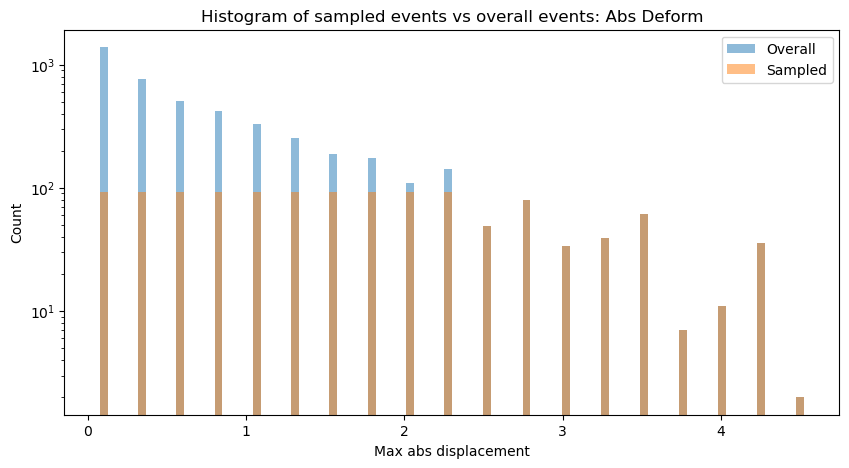

Unique sampled events: 1239
thresh_deform_off 2.8 max_deform_off 6.25
bin_def [ 0.1         0.4         0.7         1.          1.3         1.6
  1.9         2.2         2.5         2.8         2.8         3.18333333
  3.56666667  3.95        4.33333333  4.71666667  5.1         5.48333333
  5.86666667  6.25       99.        ] count 21
Sampling 92 events in bin (0.1, 0.4) from 596 events
Sampling 92 events in bin (0.4, 0.7) from 789 events
Sampling 92 events in bin (0.7, 0.9999999999999999) from 644 events
Sampling 92 events in bin (0.9999999999999999, 1.3) from 586 events
Sampling 92 events in bin (1.3, 1.6) from 437 events
Sampling 92 events in bin (1.6, 1.9) from 381 events
Sampling 92 events in bin (1.9, 2.2) from 285 events
Sampling 92 events in bin (2.2, 2.5) from 224 events
Sampling 92 events in bin (2.5, 2.8) from 167 events
Sampling 92 events in bin (2.8, 2.8) from 0 events
Sampling 92 events in bin (2.8, 3.183333333333333) from 168 events
Sampling 92 events in bin (3.183333333

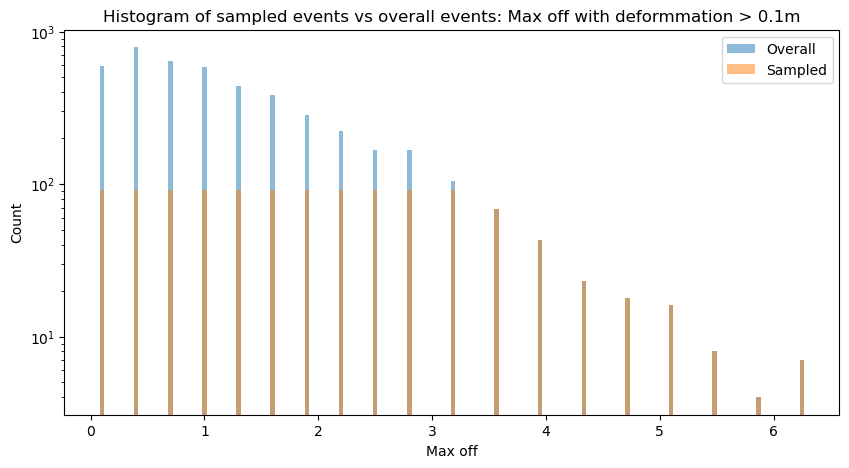

Unique sampled events: 1200
thresh_BS_off 1.58 max_BS_off 4.25
bin_def [ 0.1         0.26444444  0.42888889  0.59333333  0.75777778  0.92222222
  1.08666667  1.25111111  1.41555556  1.58        1.58        1.87666667
  2.17333333  2.47        2.76666667  3.06333333  3.36        3.65666667
  3.95333333  4.25       99.        ] count 21
Sampling 92 events in bin (0.1, 0.2644444444444445) from 1294 events
Sampling 92 events in bin (0.2644444444444445, 0.4288888888888889) from 1359 events
Sampling 92 events in bin (0.4288888888888889, 0.5933333333333334) from 1199 events
Sampling 92 events in bin (0.5933333333333334, 0.7577777777777778) from 822 events
Sampling 92 events in bin (0.7577777777777778, 0.9222222222222222) from 732 events
Sampling 92 events in bin (0.9222222222222222, 1.0866666666666667) from 536 events
Sampling 92 events in bin (1.0866666666666667, 1.2511111111111113) from 446 events
Sampling 92 events in bin (1.2511111111111113, 1.4155555555555557) from 313 events
Sampling 92

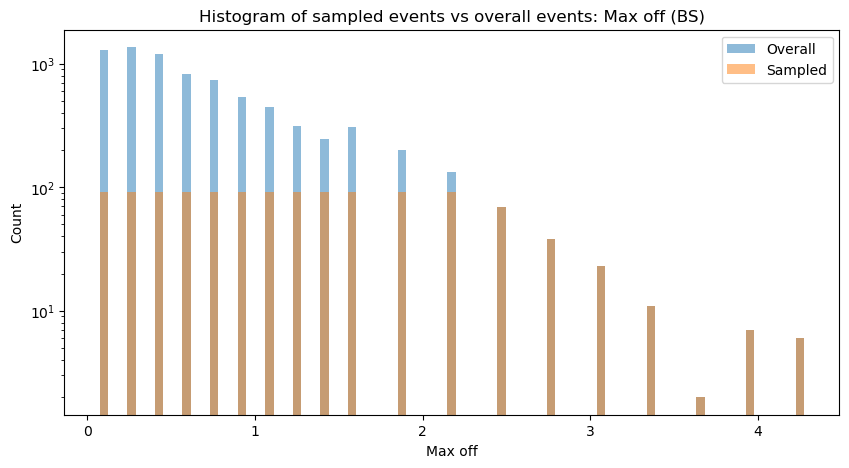

Unique sampled events: 1260
thresh_PS_off 1.7 max_PS_off 3.6
bin_def [ 0.1         0.27777778  0.45555556  0.63333333  0.81111111  0.98888889
  1.16666667  1.34444444  1.52222222  1.7         1.7         1.91111111
  2.12222222  2.33333333  2.54444444  2.75555556  2.96666667  3.17777778
  3.38888889  3.6        99.        ] count 21
Sampling 276 events in bin (0.1, 0.2777777777777778) from 2892 events
Sampling 276 events in bin (0.2777777777777778, 0.4555555555555555) from 2127 events
Sampling 276 events in bin (0.4555555555555555, 0.6333333333333332) from 1752 events
Sampling 276 events in bin (0.6333333333333332, 0.811111111111111) from 1230 events
Sampling 276 events in bin (0.811111111111111, 0.9888888888888888) from 1008 events
Sampling 276 events in bin (0.9888888888888888, 1.1666666666666665) from 1048 events
Sampling 276 events in bin (1.1666666666666665, 1.3444444444444443) from 909 events
Sampling 276 events in bin (1.3444444444444443, 1.5222222222222221) from 713 events
Samp

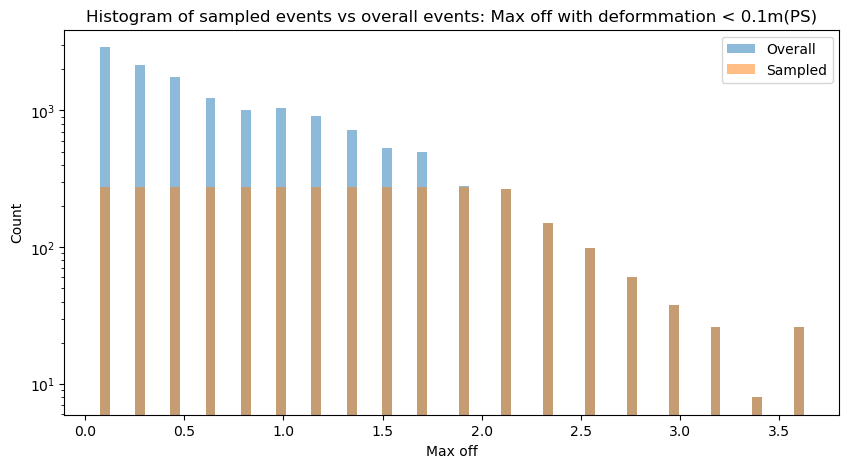

Unique sampled events: 3706
test set size: 46609


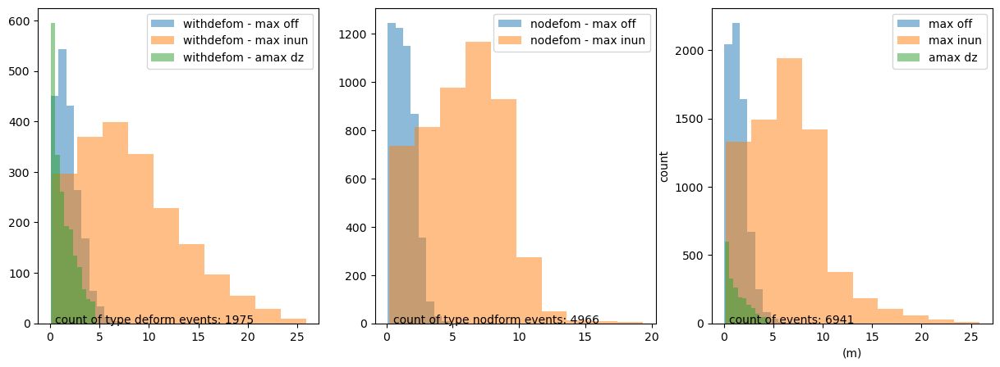

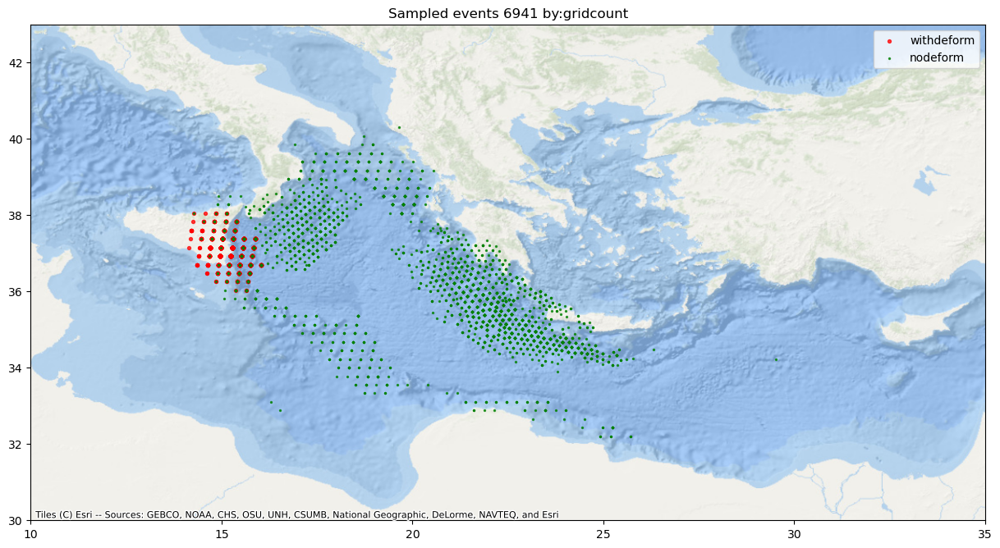

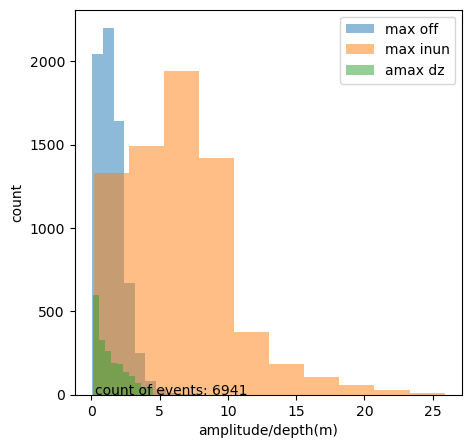

In [38]:
X = 4
#emphasis above a threshold(90%) 
max_deform = 4.5
samples_per_bin = 23 * X
bin_splits = 10

bin_def_1 =  np.linspace(start,thresh_deform,bin_splits)
bin_def_2 =  np.linspace(thresh_deform,max_deform, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_deform',thresh_deform,'max_deform',max_deform)
print('bin_def',bin_def,'count',len(bin_def))

#sample function
sample_step0 = sample_train_events(combined_half_deform.groupby('event_type').get_group(0),
                                importance_column=wt_para,
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_absdz')
#set as dataframe
sample_step0 = pd.concat(sample_step0, axis=0)

#update other parameters from combined
sample_step0 = pd.merge(sample_step0, combined, on='id', how='left')

#keep only unique events
sample_step0 = sample_step0.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_deform['max_absdz'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step0['max_absdz'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.05,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.05, alpha=0.5, label='Sampled')
ax.set(xlabel='Max abs displacement', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Abs Deform')
plt.legend()
plt.show()
print('Unique sampled events:',len(sample_step0['id'].unique()))

#override max_deform_off
max_deform_off = 6.25

bin_def_1 =  np.linspace(start,thresh_deform_off,bin_splits)
bin_def_2 =  np.linspace(thresh_deform_off,max_deform_off, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_deform_off',thresh_deform_off,'max_deform_off',max_deform_off)
print('bin_def',bin_def,'count',len(bin_def))

#sample function
sample_step1 = sample_train_events(combined_half_deform.groupby('event_type').get_group(0),
                                importance_column=wt_para,
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_off')
#set as dataframe
sample_step1 = pd.concat(sample_step1, axis=0)
#update other parameters from combined
sample_step1 = pd.merge(sample_step1, combined, on='id', how='left')
#keep only unique events
sample_step1 = sample_step1.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_deform['max_off'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step1['max_off'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.04,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.04, alpha=0.5, label='Sampled')
ax.set(xlabel='Max off', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Max off with deformmation > 0.1m')
plt.legend()
plt.show()
print('Unique sampled events:',len(sample_step1['id'].unique()))

#override max_off
max_BS_off = 4.25

bin_def_1 =  np.linspace(start,thresh_BS_off,bin_splits)
bin_def_2 =  np.linspace(thresh_BS_off,max_BS_off, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_BS_off',thresh_BS_off,'max_BS_off',max_BS_off)
print('bin_def',bin_def,'count',len(bin_def))


sample_step3 = sample_train_events(combined_half_nodeform.groupby('source_type').get_group('BS'),
                                importance_column=wt_para, 
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_off')

#set as dataframe
sample_step3 = pd.concat(sample_step3, axis=0)
#update other parameters from combined
sample_step3 = pd.merge(sample_step3, combined, on='id', how='left')
#keep only unique events
sample_step3 = sample_step3.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_nodeform.groupby('source_type').get_group('BS')['max_off'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step3['max_off'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.05,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.05, alpha=0.5, label='Sampled')
ax.set(xlabel='Max off', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Max off (BS)')
plt.legend()
plt.show()
print('Unique sampled events:',len(sample_step3['id'].unique()))

#override max
samples_per_bin = samples_per_bin *3
max_PS_off = 3.6

bin_def_1 =  np.linspace(start,thresh_PS_off,bin_splits)
bin_def_2 =  np.linspace(thresh_PS_off,max_PS_off, bin_splits)

#combine the bins and add 99 to the end
bin_def = np.append(np.concatenate((bin_def_1,bin_def_2)),99)
print('thresh_PS_off',thresh_PS_off,'max_PS_off',max_PS_off)
print('bin_def',bin_def,'count',len(bin_def))


sample_step2 = sample_train_events(combined_half_nodeform.groupby('source_type').get_group('PS'),
                                importance_column=wt_para, 
                                samples_per_bin=samples_per_bin,
                                bin_def = bin_def,
                                basis_var='max_off')

#set as dataframe
sample_step2 = pd.concat(sample_step2, axis=0)
#update other parameters from combined
sample_step2 = pd.merge(sample_step2, combined, on='id', how='left')
#keep only unique events
sample_step2 = sample_step2.drop_duplicates(subset=['id'])

#plot histogram of sampled events vs overall events using bin_def
overall_hist, overall_bins = np.histogram(combined_half_nodeform.groupby('source_type').get_group('PS')['max_off'], bins=bin_def)
sample_hist, sample_bins = np.histogram(sample_step2['max_off'], bins=bin_def)

# Plot histograms
fig, ax = plt.subplots(figsize=(10, 5))
ax.bar(overall_bins[:-1], overall_hist,width=0.05,alpha=0.5, label='Overall')
ax.bar(sample_bins[:-1], sample_hist, width=0.05, alpha=0.5, label='Sampled')
ax.set(xlabel='Max off', ylabel='Count')
ax.set_yscale('log')
plt.title('Histogram of sampled events vs overall events: Max off with deformmation < 0.1m(PS)')
plt.legend()
plt.show()

print('Unique sampled events:',len(sample_step2['id'].unique()))
#merge samples to get final sample
sample_test = pd.concat([sample_step0,sample_step1,sample_step2,sample_step3], axis=0)
#keep only unique events
sample_test = sample_test.drop_duplicates(subset=['id'])

#check if plot folder exists
if not os.path.exists(MLDir + f'/model/{reg}/plot'):
    os.makedirs(MLDir + f'/model/{reg}/plot')


#plot 
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
axs[0].hist(sample_test[sample_test['event_type']==0]['max_off'], bins=bin_splits, alpha=0.5, label='withdefom - max off')
axs[0].hist(sample_test[sample_test['event_type']==0]['dmax'], bins=bin_splits, alpha=0.5, label='withdefom - max inun')
axs[0].hist(sample_test[sample_test['event_type']==0]['max_absdz'], bins=bin_splits, alpha=0.5, label='withdefom - amax dz')
axs[0].text(0.5, 0.5, 'count of type deform events: '+str(len(sample_test[sample_test['event_type']==0])))
axs[0].legend(loc='upper right')

axs[1].hist(sample_test[sample_test['event_type']==1]['max_off'], bins=bin_splits, alpha=0.5, label='nodefom - max off')
axs[1].hist(sample_test[sample_test['event_type']==1]['dmax'], bins=bin_splits, alpha=0.5, label='nodefom - max inun')
axs[1].text(0.5, 0.5,'count of type nodform events: '+str(len(sample_test[sample_test['event_type']==1])))
axs[1].legend(loc='upper right')

axs[2].hist(sample_test['max_off'], bins=bin_splits, alpha=0.5, label='max off')
axs[2].hist(sample_test['dmax'], bins=bin_splits, alpha=0.5, label='max inun')
axs[2].hist(sample_test[sample_test['max_absdz']>0.1]['max_absdz'], bins=bin_splits, alpha=0.5, label='amax dz')
axs[2].text(0.5, 0.5, 'count of events: '+str(len(sample_test['id'].unique())))
axs[2].legend(loc='upper right')
#label axes
axs[2].set(xlabel='(m)', ylabel='count')
plt.savefig(MLDir + f'/model/{reg}/plot/sampledist_events_splits{str(len(sample_test))}_{reg}_{columnname}.png', bbox_inches='tight')

fig, ax = plt.subplots(figsize=(15,10))
ax.title.set_text('Sampled events ' + str(len(sample_test)) + ' by:' + wt_para)
ax = plt.scatter(sample_test[sample_test['event_type']==0]['lon'], sample_test[sample_test['event_type']==0]['lat'], alpha=0.75, label='withdeform',s=8, color='red')
ax = plt.scatter(sample_test[sample_test['event_type']==1]['lon'], sample_test[sample_test['event_type']==1]['lat'], alpha=0.75, label='nodeform', s=2, color='green')
plt.legend(loc='upper right')
plt.xlim(10, 35)
plt.ylim(30, 43)
ax = plt.gca()
cx.add_basemap(ax,crs='EPSG:4326', source=cx.providers.Esri.OceanBasemap)
plt.savefig(MLDir + f'/model/{reg}/plot/samplemap_events{str(len(sample_test))}_{reg}_{columnname}.png', bbox_inches='tight')

fig, axs = plt.subplots(1, 1, figsize=(5, 5))
axs.hist(sample_test['max_off'], bins=bin_splits, alpha=0.5, label='max off')
axs.hist(sample_test['dmax'], bins=bin_splits, alpha=0.5, label='max inun')
axs.hist(sample_test[sample_test['max_absdz']>0.1]['max_absdz'], bins=bin_splits, alpha=0.5, label='amax dz')
axs.text(0.25, 0.5, 'count of events: '+str(len(sample_test['id'].unique())))
axs.legend(loc='upper right')
#label axes
axs.set(xlabel='amplitude/depth(m)', ylabel='count')
plt.savefig(MLDir + f'/model/{reg}/plot/sampledist_events{str(len(sample_test))}_{reg}_{columnname}.png', bbox_inches='tight')

#save list of ids to txt file for training
#for building model
sample_test['id'].to_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/sample_events{str(len(sample_test))}_{reg}_{columnname}.txt', header=False, index=None)

#evaluation of model by removing sample from combined ie the test set
test = combined[~combined['id'].isin(sample_test['id'])]
len_test = len(test['id'].unique())
print('test set size:',len_test)
pd.DataFrame(test['id'].unique()).to_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/shuffled_events_test_{reg}_{str(len_test)}_{str(len(sample_test))}.txt', header=False, index=None)


In [39]:
size_list = ['961','1773','3669','6941','9186']
reg_list = ['SR']

total_unique_events = []

for reg in reg_list:
    for size in size_list:
        #filter events with lower than threshold of 0.1 at atleast one station
        offshore_threshold = 0.1
        onshore_threshold = 0.20
        split = 0.75

        #offshore
        allpts_max = np.loadtxt(f'{MLDir}/data/info/grid0_allpts87_alleve53550.offshore.txt', dtype='str',skiprows=1)

        #select particular representative gauge for files and gauges for threshold test
        if reg == 'CT':
            columnname = str(38)
            GaugeNo = list(range(35,44)) #for Catania
        elif reg == 'SR':
            GaugeNo = list(range(53,58)) #for Siracusa
            columnname = str(54)

        event_list = np.loadtxt(f'{MLDir}/data/events/sample_events{size}_{reg}_{columnname}.txt', dtype='str') #for harcode

        #find index of event list in allpts_max wiht duplicate events
        event_list_index = np.array([np.where(allpts_max[:,0]==event)[0] for event in event_list]).flatten()
        allpts_max = allpts_max[event_list_index]
        Gauge_Max = allpts_max[:,GaugeNo]
        maxPerEve = Gauge_Max.astype(float).max(axis=1)

        #onshore
        inun_info = np.loadtxt(f'{MLDir}/data/info/CHeight_{reg}_alleve53550.onshore.txt', dtype='str',skiprows=1)
        inun_info = inun_info[event_list_index]
        #get column of max inundation depth which is 3rd column
        Inun_Max = inun_info[:,2]

        #filter events greater than thresholds for gauge and min inundation depth
        offshore_check = maxPerEve>offshore_threshold
        onshore_check = Inun_Max.astype(float)>onshore_threshold
        print("check threshold of events, offshore and onshore" )
        print(len(event_list), len(offshore_check), len(onshore_check))

        #combine event list with offshore and onshore max values and save
        event_maxlist = np.column_stack((event_list, maxPerEve, Inun_Max))
        # np.savetxt(f'{MLDir}/data/events/event_maxvaloffon_{reg}_{size}.txt', event_maxlist, fmt='%s')

        overall_check = offshore_check & onshore_check
        event_list = event_list[overall_check]

        #pick unique events only
        event_list = np.unique(event_list)

        #append to total unique events and find new unique events
        total_unique_events = np.append(total_unique_events, event_list)
        total_unique_events = np.unique(total_unique_events)

        #shuffle events
        np.random.shuffle(event_list)

        #split events in train and test and validation as 75:25
        train_events = event_list[:int(len(event_list)*split)] 
        test_events = event_list[int(len(event_list)*split):]

        #print number of events in each set
        print('total events:',len(event_list),'train events:',len(train_events),'test events:',len(test_events))
        
        #save events in file
        np.savetxt(f'{MLDir}/data/events/shuffled_events_{reg}_{size}.txt', event_list, fmt='%s')
        np.savetxt(f'{MLDir}/data/events/train_events_{reg}_{size}.txt', train_events, fmt='%s')
        np.savetxt(f'{MLDir}/data/events/test_events_{reg}_{size}.txt', test_events, fmt='%s')

# #save total unique events as total train events
# np.savetxt(f'{MLDir}/data/info/train_events_{reg}_total.txt', total_unique_events, fmt='%s')



check threshold of events, offshore and onshore
961 961 961
total events: 956 train events: 717 test events: 239
check threshold of events, offshore and onshore
1773 1773 1773
total events: 1767 train events: 1325 test events: 442
check threshold of events, offshore and onshore
3669 3669 3669
total events: 3660 train events: 2745 test events: 915
check threshold of events, offshore and onshore
6941 6941 6941
total events: 6923 train events: 5192 test events: 1731
check threshold of events, offshore and onshore
9186 9186 9186
total events: 9141 train events: 6855 test events: 2286


In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
reg = 'SR'
MLDir = '/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami' 
#select particular representative gauge for files and gauges for threshold test
if reg == 'CT':
    columnname = str(38)
    GaugeNo = list(range(35,44)) #for Catania
elif reg == 'SR':
    GaugeNo = list(range(53,58)) #for Siracusa
    columnname = str(54)

#find all other events apart from the total unique events
combined = pd.read_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/info/sampling_input_{reg}_{columnname}.csv')
total_unique_events = np.loadtxt(f'{MLDir}/data/info/train_events_{reg}_total.txt', dtype='str')

# #find events not in total unique events
# event_list = combined[~combined['id'].isin(total_unique_events)]
# event_list = event_list['id'].unique()
event_list = combined['id'].unique()

#check for threshold 0.1 at atleast one station abd 0.2 at atleast one onshore location
#filter events with lower than threshold of 0.1 at atleast one station
offshore_threshold = 0.1
onshore_threshold = 0.20

#offshore
allpts_max = np.loadtxt(f'{MLDir}/data/info/grid0_allpts87_alleve53550.offshore.txt', dtype='str',skiprows=1)


#find index of event list in allpts_max wiht duplicate events
event_list_index = np.array([np.where(allpts_max[:,0]==event)[0] for event in event_list]).flatten()
allpts_max = allpts_max[event_list_index]
Gauge_Max = allpts_max[:,GaugeNo]
maxPerEve = Gauge_Max.astype(float).max(axis=1)

#onshore
inun_info = np.loadtxt(f'{MLDir}/data/info/CHeight_{reg}_alleve53550.onshore.txt', dtype='str',skiprows=1)
inun_info = inun_info[event_list_index]
#get column of max inundation depth which is 3rd column
Inun_Max = inun_info[:,2]

#filter events greater than thresholds for gauge and min inundation depth
offshore_check = maxPerEve>offshore_threshold
onshore_check = Inun_Max.astype(float)>onshore_threshold
print("check threshold of events, offshore and onshore" )
print(len(event_list), len(offshore_check), len(onshore_check))

#combine event list with offshore and onshore max values and save
event_maxlist = np.column_stack((event_list, maxPerEve, Inun_Max))
np.savetxt(f'{MLDir}/data/events/event_maxvaloffon_{reg}_test_{len(event_maxlist)}.txt', event_maxlist, fmt='%s')

#save this filterd list as test events
np.savetxt(f'{MLDir}/data/events/shuffled_events_test_{reg}_{len(event_list)}_all.txt',event_list, fmt='%s')

#split test events into 4 partsm and save as size 0,1,2,3
np.savetxt(f'{MLDir}/data/events/shuffled_events_test_{reg}_0.txt',event_list[:int(len(event_list)*0.25)], fmt='%s')
np.savetxt(f'{MLDir}/data/events/shuffled_events_test_{reg}_1.txt',event_list[int(len(event_list)*0.25):int(len(event_list)*0.5)], fmt='%s')
np.savetxt(f'{MLDir}/data/events/shuffled_events_test_{reg}_2.txt',event_list[int(len(event_list)*0.5):int(len(event_list)*0.75)], fmt='%s')
np.savetxt(f'{MLDir}/data/events/shuffled_events_test_{reg}_3.txt',event_list[int(len(event_list)*0.75):], fmt='%s')

check threshold of events, offshore and onshore
53550 53550 53550


In [44]:
import folium
import pandas as pd


# file_list = ['/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/shuffled_events_CT_762.txt',
# '/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/shuffled_events_CT_1441.txt',
# '/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/shuffled_events_CT_2589.txt',
# '/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/shuffled_events_CT_4005.txt',
# '/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/events/shuffled_events_CT_6734.txt']

#read train events
#read train events
# train_events = np.loadtxt(f'{MLDir}/data/info/train_events_{reg}_total.txt', dtype='str')

train_events = np.loadtxt(f'{MLDir}/data/events/shuffled_events_{reg}_1773.txt', dtype='str')

#Create location keyword
DF_eve = pd.read_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/info/sampling_input_{reg}_{columnname}.csv')

#event_list train events, pick form DF_eve
Train_eve = DF_eve[DF_eve['id'].isin(train_events)]

#Unique EQ locations overall
unique_locations = len(DF_eve['Location'].unique())
print('uniques EQ locations in the dataset:',unique_locations)

#filter 1 row per unique location from list of DF_eve
DF_eve_unique = DF_eve.drop_duplicates(subset=['Location'], keep='first')
#reset index
DF_eve_unique.reset_index(drop=True, inplace=True)

#unique locations for training events
unique_locations_train = len(Train_eve['Location'].unique())
print('uniques EQ locations in the training dataset:',unique_locations_train)

#filter 1 row per unique location from list of train list
Train_eve_unique = Train_eve.drop_duplicates(subset=['Location'], keep='first')
#reset index
Train_eve_unique.reset_index(drop=True, inplace=True)

data_pts = np.loadtxt('/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/resources/raw/pois_eastern_sicily_2km.txt', dtype=str)
id_pts = data_pts[:, 0]
lon_pts = data_pts[:, 1].astype(float)
lat_pts = data_pts[:, 2].astype(float)
z_pts = data_pts[:, 3].astype(float)

#Create a map with the unique locations
eve_map = folium.Map(location=[np.mean(DF_eve_unique['lat']),
                               np.mean(DF_eve_unique['lon'])],
                               zoom_start=7, tiles='OpenStreetMap')

# Basemaps
folium.TileLayer(tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
        attr = 'Esri',
        name = 'Esri Satellite',
        overlay = False,
        control = True,
        show = False).add_to(eve_map)

# Create a feature group for the offshore points and eq loc 
fg_pts = folium.FeatureGroup(name='Offshore Points Txt').add_to(eve_map)
fg_Unq_EQ = folium.FeatureGroup(name='Unique EQ Location').add_to(eve_map)
fg_Train_EQ = folium.FeatureGroup(name='Train EQ Location').add_to(eve_map)

for i in range(len(DF_eve_unique)-1):
    folium.CircleMarker([DF_eve_unique.loc[i+1,'lat'], DF_eve_unique.loc[i+1,'lon']],radius= 3,color = 'green',opacity=0.95 ).add_to(fg_Unq_EQ)
folium.LayerControl().add_to(eve_map)

for i in range(len(Train_eve_unique)-1):
    folium.CircleMarker([Train_eve_unique.loc[i+1,'lat'], Train_eve_unique.loc[i+1,'lon']],radius= 1,color = 'red',opacity=0.95 ).add_to(fg_Train_EQ)
folium.LayerControl().add_to(eve_map)

for id, lat, lon,z in zip(id_pts, lat_pts, lon_pts, z_pts):
    info = f"ID:{id}, Depth: {z} "  # Create tooltip string
    folium.CircleMarker(location=[lat, lon],
                  tooltip=info,radius=0.5,
                  icon=folium.Icon(color='blue', icon='')).add_to(fg_pts)
    
# # Save the map as an HTML file or plot here
# # eve_map.save('tsu_PS_eve_map.html')

eve_map

uniques EQ locations in the dataset: 1283
uniques EQ locations in the training dataset: 467


/tmp/ipykernel_1066535/3898525511.py:30: DtypeWarning: Columns (6,7,8,9) have mixed types. Specify dtype option on import or set low_memory=False.
  master_info = pd.read_csv(f'{MLDir}/resources/processed/allinfo_eventsBS_PS53550.csv',sep=',')
/tmp/ipykernel_1066535/3898525511.py:30: DtypeWarning: Columns (6,7,8,9) have mixed types. Specify dtype option on import or set low_memory=False.
  master_info = pd.read_csv(f'{MLDir}/resources/processed/allinfo_eventsBS_PS53550.csv',sep=',')
/tmp/ipykernel_1066535/3898525511.py:30: DtypeWarning: Columns (6,7,8,9) have mixed types. Specify dtype option on import or set low_memory=False.
  master_info = pd.read_csv(f'{MLDir}/resources/processed/allinfo_eventsBS_PS53550.csv',sep=',')
/tmp/ipykernel_1066535/3898525511.py:30: DtypeWarning: Columns (6,7,8,9) have mixed types. Specify dtype option on import or set low_memory=False.
  master_info = pd.read_csv(f'{MLDir}/resources/processed/allinfo_eventsBS_PS53550.csv',sep=',')


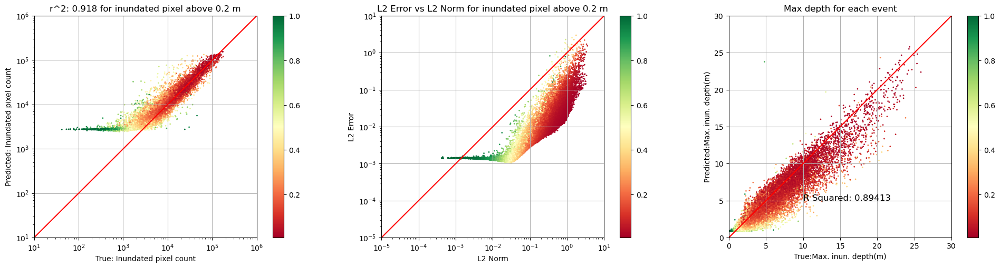

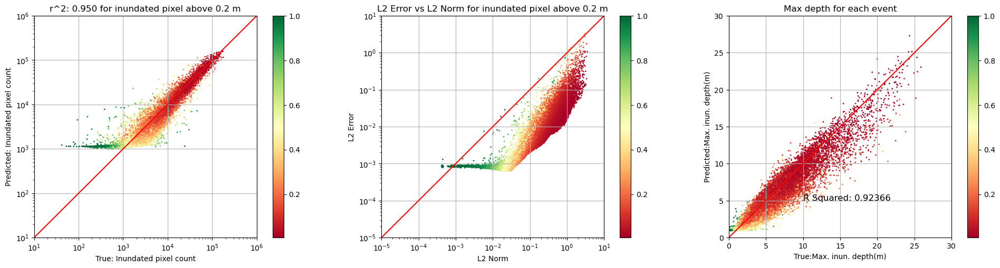

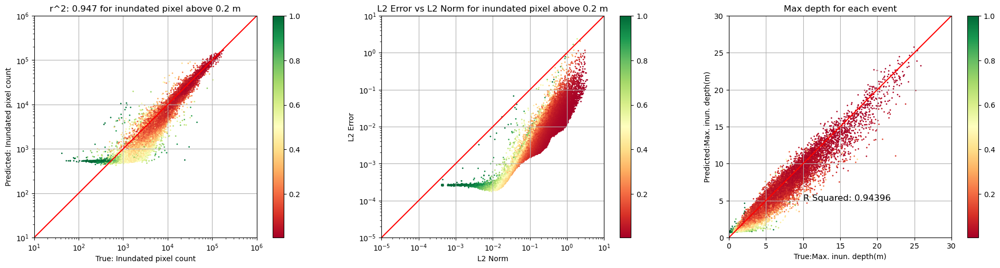

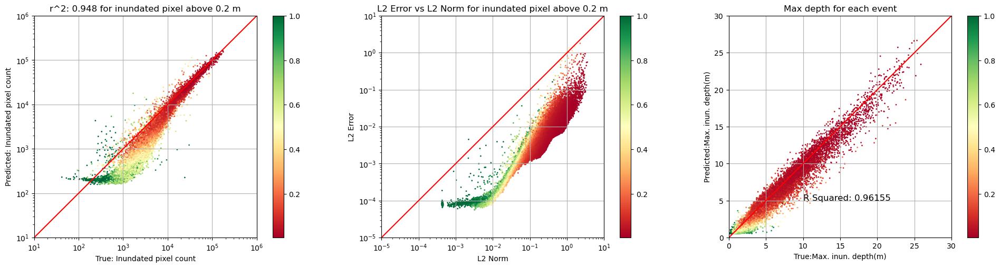

In [2]:
#select particular representative gauge
reg = 'SR'

list_size = ['961','1773','3669','6941']
columnname = str(54)
mask_size = '961'

for train_size in list_size:
    MLDir = '/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami' 
    perf_df_list = []
    loc_df_list = []
    for test_size in ['0', '1', '2', '3']:
        #read test performance events and append together rows to single dataframe
        file_perf = f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_testsize{test_size}.csv'
        file_loc = f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_true_pred_er_testsize{test_size}.csv'
        df1 = pd.read_csv(file_perf)
        df2 = pd.read_csv(file_loc)
        perf_df_list.append(df1)
        loc_df_list.append(df2)

    perf_df = pd.concat(perf_df_list, ignore_index=True)
    loc_df = pd.concat(loc_df_list, ignore_index=True)
    #read train events to mark test or train
    train_file = f'{MLDir}/data/events/shuffled_events_{reg}_{train_size}.txt'
    train_eve = np.loadtxt(train_file, dtype='str')
    perf_df['split'] = np.where(perf_df['id'].isin(train_eve), 'train', 'test')
    loc_df['split'] = np.where(loc_df['id'].isin(train_eve), 'train', 'test')
    
    #read master info file to add more columns
    master_info = pd.read_csv(f'{MLDir}/resources/processed/allinfo_eventsBS_PS53550.csv',sep=',')
    master_info = master_info.rename(columns={'ID':'eve_id'})
    perf_df['Mag'] = perf_df['eve_id'].map(master_info.set_index('eve_id')['Mag'])
    
    perf_df.to_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv', header=True, index=None)
    loc_df.to_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_true_pred_er_combined.csv', header=True, index=None)


    eve_perf = pd.read_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv')
    # Create a single figure with three axes
    fig, ax = plt.subplots(1, 3, figsize=(20, 5))

    # Plot scatter of flood count
    r2area = r2_score(eve_perf['true'], eve_perf['pred'])
    scatter = ax[0].scatter(eve_perf['true'], eve_perf['pred'], s=1, c=eve_perf['g'], cmap='RdYlGn')
    ax[0].plot([0, 1], [0, 1], transform=ax[0].transAxes, color='red')
    ax[0].set_title(f"r^2: {r2area:.3f} for inundated pixel above 0.2 m")
    plt.colorbar(scatter, ax=ax[0])
    ax[0].set_aspect('equal', adjustable='box')
    ax[0].set_xscale('log')
    ax[0].set_yscale('log')
    ax[0].set_xlim(10, 1000000)
    ax[0].set_ylim(10, 1000000)
    ax[0].grid()
    ax[0].set_xlabel('True: Inundated pixel count')
    ax[0].set_ylabel('Predicted: Inundated pixel count')

    # Plot scatter of mse vs l2norm
    scatter = ax[1].scatter(eve_perf['l2n'], eve_perf['mse'], s=1, c=eve_perf['g'], cmap='RdYlGn')
    ax[1].plot([0, 1], [0, 1], transform=ax[1].transAxes, color='red')
    plt.colorbar(scatter, ax=ax[1])
    ax[1].set_title(f"L2 Error vs L2 Norm for inundated pixel above 0.2 m")
    ax[1].set_aspect('equal', adjustable='box')
    ax[1].set_xscale('log')
    ax[1].set_yscale('log')
    ax[1].set_xlim(.00001, 10)
    ax[1].set_ylim(.00001, 10)
    ax[1].grid()
    ax[1].set_xlabel('L2 Norm')
    ax[1].set_ylabel('L2 Error')

    # Plot scatter of max depth for each event
    # Calculate the point density
    x = eve_perf['truemax']
    y = eve_perf['predmax']
    r2maxdepth = r2_score(x, y)
    scatter = ax[2].scatter(x, y, s=1, c=eve_perf['g'], cmap='RdYlGn')#c=z,
    ax[2].plot([0, 1], [0, 1], transform=ax[2].transAxes, color='red')
    plt.colorbar(scatter, ax=ax[2])
    ax[2].set_title("Max depth for each event")
    ax[2].text(10, 5, f"R Squared: {r2maxdepth:.5f} ", fontsize=12)
    ax[2].set_aspect('equal', adjustable='box')
    ax[2].set_xlim(0, 30)
    ax[2].set_ylim(0, 30)
    ax[2].grid()
    plt.xlabel('True:Max. inun. depth(m)')
    plt.ylabel('Predicted:Max. inun. depth(m)')

    # Adjust layout and add a suptitle to the main plot
    plt.tight_layout()
    # plt.suptitle(f"mseoverall: {mseoverall:.5f}, r2maxdepth: {r2maxdepth:.5f}, gfitoverall: {gfitoverall:.4f}, testsize: {self.test_size}", fontsize=16, y=0.02)
    plt.savefig(f'{MLDir}/model/{reg}/results/model_coupled_[64, 128, 256]_on[16, 128, 128]_{train_size}_combined.png')


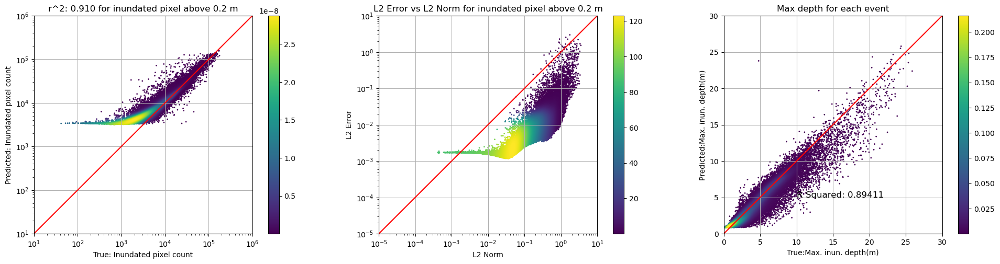

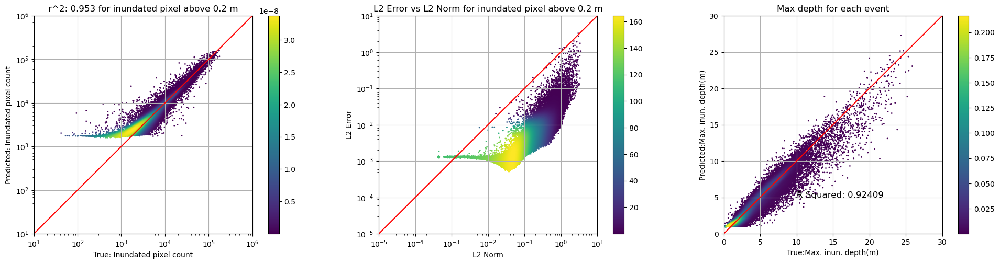

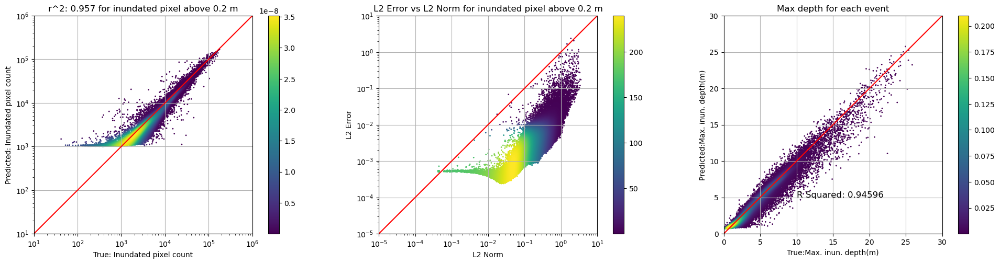

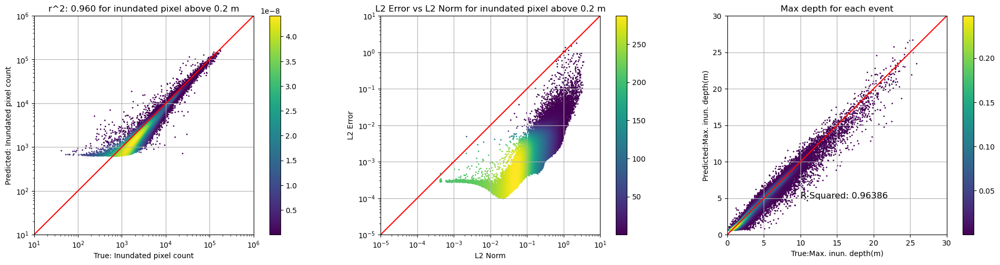

In [22]:
for train_size in list_size:
    eve_perf = pd.read_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv')

    # Create a single figure with three axes
    fig, ax = plt.subplots(1, 3, figsize=(20, 5))

    # Plot scatter of flood count
    x = eve_perf['true']
    y = eve_perf['pred']
    r2area = r2_score(x, y)
    xy = np.vstack([x,y])
    z = gaussian_kde(xy)(xy)
    index = z.argsort()
    x, y, z = x[index], y[index], z[index]
    scatter = ax[0].scatter(x, y, c=z, s=1)
    ax[0].plot([0, 1], [0, 1], transform=ax[0].transAxes, color='red')
    ax[0].set_title(f"r^2: {r2area:.3f} for inundated pixel above 0.2 m")
    plt.colorbar(scatter, ax=ax[0])
    ax[0].set_aspect('equal', adjustable='box')
    ax[0].set_xscale('log')
    ax[0].set_yscale('log')
    ax[0].set_xlim(10, 1000000)
    ax[0].set_ylim(10, 1000000)
    ax[0].grid()
    ax[0].set_xlabel('True: Inundated pixel count')
    ax[0].set_ylabel('Predicted: Inundated pixel count')

    # Plot scatter of mse vs l2norm
    # Calculate the point density
    x = eve_perf['l2n']
    y = eve_perf['mse']
    xy = np.vstack([x,y])
    z = gaussian_kde(xy)(xy)
    index = z.argsort()
    x, y, z = x[index], y[index], z[index]
    scatter = ax[1].scatter(x, y, c=z, s=1)
    ax[1].plot([0, 1], [0, 1], transform=ax[1].transAxes, color='red')
    plt.colorbar(scatter, ax=ax[1])
    ax[1].set_title(f"L2 Error vs L2 Norm for inundated pixel above 0.2 m")
    ax[1].set_aspect('equal', adjustable='box')
    ax[1].set_xscale('log')
    ax[1].set_yscale('log')
    ax[1].set_xlim(.00001, 10)
    ax[1].set_ylim(.00001, 10)
    ax[1].grid()
    ax[1].set_xlabel('L2 Norm')
    ax[1].set_ylabel('L2 Error')

    # Plot scatter of max depth for each event
    # Calculate the point density
    x = eve_perf['truemax']
    y = eve_perf['predmax']
    r2maxdepth = r2_score(x, y)
    xy = np.vstack([x,y])
    z = gaussian_kde(xy)(xy)
    index = z.argsort()
    x, y, z = x[index], y[index], z[index]
    scatter = ax[2].scatter(x, y, c=z, s=1)
    ax[2].plot([0, 1], [0, 1], transform=ax[2].transAxes, color='red')
    plt.colorbar(scatter, ax=ax[2])
    ax[2].set_title("Max depth for each event")
    ax[2].text(10, 5, f"R Squared: {r2maxdepth:.5f} ", fontsize=12)
    ax[2].set_aspect('equal', adjustable='box')
    ax[2].set_xlim(0, 30)
    ax[2].set_ylim(0, 30)
    ax[2].grid()
    plt.xlabel('True:Max. inun. depth(m)')
    plt.ylabel('Predicted:Max. inun. depth(m)')

    # Adjust layout and add a suptitle to the main plot
    plt.tight_layout()



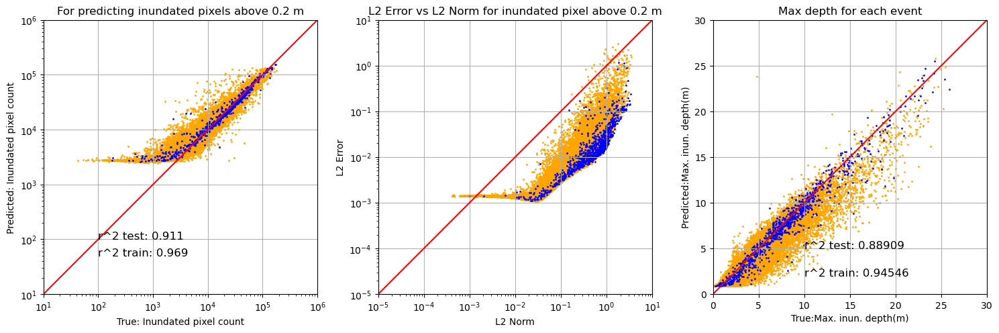

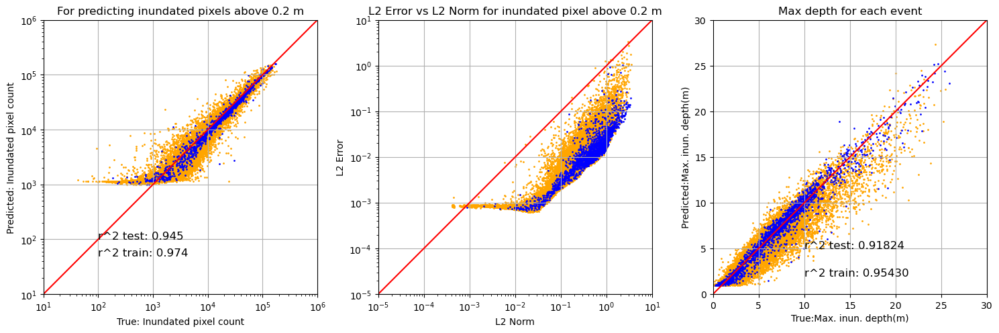

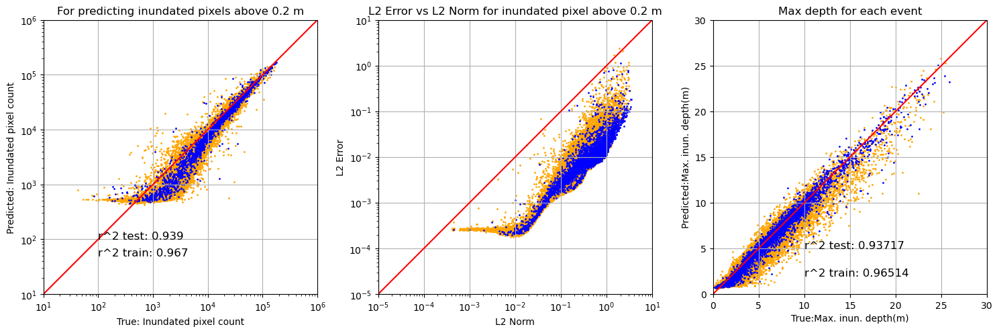

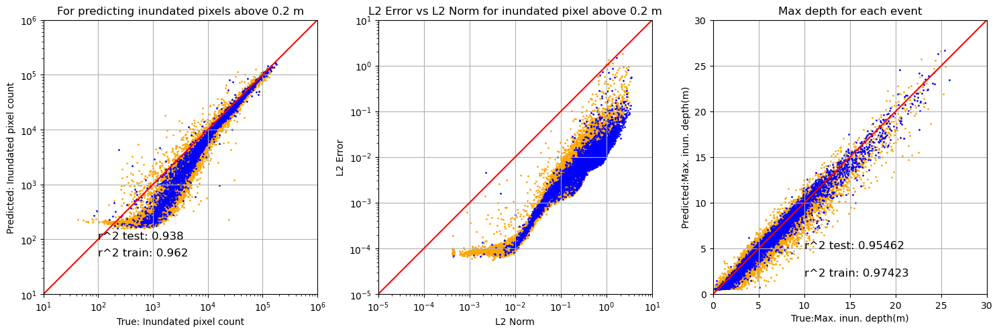

In [3]:
for train_size in list_size:
    eve_perf = pd.read_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv')

    # Create a single figure with three axes
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    # Plot scatter of flood count
    x = eve_perf[eve_perf['split'] == 'test']['true']
    y = eve_perf[eve_perf['split'] == 'test']['pred']
    r2area = r2_score(x, y)
    scatter = ax[0].scatter(x, y, s=1,label='test', c='orange')
    #add r2 score at bottom right of axis
    ax[0].text(100,100,f"r^2 test: {r2area:.3f} ", fontsize=12)

    x = eve_perf[eve_perf['split'] == 'train']['true']
    y = eve_perf[eve_perf['split'] == 'train']['pred']
    r2area = r2_score(x, y)
    scatter = ax[0].scatter(x, y, s=1,label='train', c='blue')
    ax[0].text(100,50,f"r^2 train: {r2area:.3f} ", fontsize=12)
    
    ax[0].title.set_text(f"For predicting inundated pixels above 0.2 m")
    ax[0].plot([0, 1], [0, 1], transform=ax[0].transAxes, color='red')
    ax[0].set_aspect('equal', adjustable='box')
    ax[0].set_xscale('log')
    ax[0].set_yscale('log')
    ax[0].set_xlim(10, 1000000)
    ax[0].set_ylim(10, 1000000)
    ax[0].grid()
    ax[0].set_xlabel('True: Inundated pixel count')
    ax[0].set_ylabel('Predicted: Inundated pixel count')

    # Plot scatter of mse vs l2norm
    x = eve_perf[eve_perf['split'] == 'test']['l2n']
    y = eve_perf[eve_perf['split'] == 'test']['mse']
    scatter = ax[1].scatter(x, y, s=1,label='test', c='orange')

    x = eve_perf[eve_perf['split'] == 'train']['l2n']
    y = eve_perf[eve_perf['split'] == 'train']['mse']
    scatter = ax[1].scatter(x, y, s=1,label='train', c='blue')
    
    ax[1].plot([0, 1], [0, 1], transform=ax[1].transAxes, color='red')
    ax[1].set_title(f"L2 Error vs L2 Norm for inundated pixel above 0.2 m")
    ax[1].set_aspect('equal', adjustable='box')
    ax[1].set_xscale('log')
    ax[1].set_yscale('log')
    ax[1].set_xlim(.00001, 10)
    ax[1].set_ylim(.00001, 10)
    ax[1].grid()
    ax[1].set_xlabel('L2 Norm')
    ax[1].set_ylabel('L2 Error')

    # Plot scatter of max depth for each event
    # Calculate the point density
   
    x = eve_perf[eve_perf['split'] == 'test']['truemax']
    y = eve_perf[eve_perf['split'] == 'test']['predmax']
    scatter = ax[2].scatter(x, y, s=1,label='test', c='orange')
    r2maxdepth = r2_score(x, y)
    ax[2].text(10, 5, f"r^2 test: {r2maxdepth:.5f} ", fontsize=12)

    x = eve_perf[eve_perf['split'] == 'train']['truemax']
    y = eve_perf[eve_perf['split'] == 'train']['predmax']
    scatter = ax[2].scatter(x, y, s=1,label='train', c='blue')
    r2maxdepth = r2_score(x, y)
    ax[2].text(10, 2, f"r^2 train: {r2maxdepth:.5f} ", fontsize=12)

    ax[2].plot([0, 1], [0, 1], transform=ax[2].transAxes, color='red')
    ax[2].set_title("Max depth for each event")
    ax[2].set_aspect('equal', adjustable='box')
    ax[2].set_xlim(0, 30)
    ax[2].set_ylim(0, 30)
    ax[2].grid()
    plt.xlabel('True:Max. inun. depth(m)')
    plt.ylabel('Predicted:Max. inun. depth(m)')

    # Adjust layout and add a suptitle to the main plot
    plt.tight_layout()



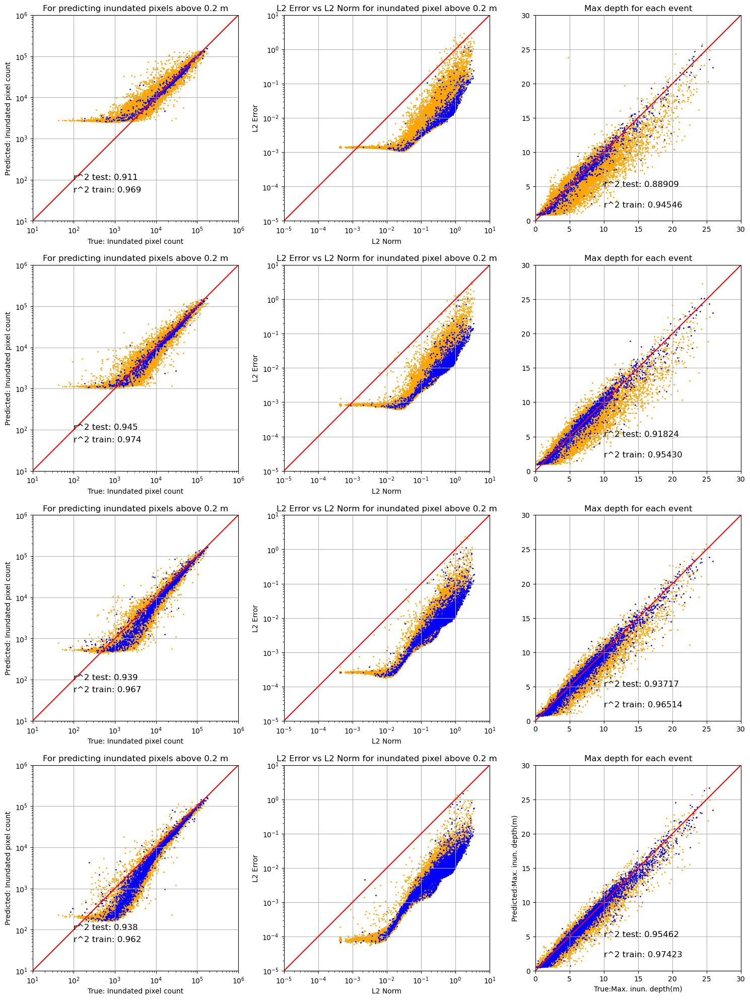

In [4]:
# Create a single figure with three axes
fig, ax = plt.subplots(4, 3, figsize=(15, 20))

for t,train_size in enumerate(list_size):
    eve_perf = pd.read_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv')

    # Plot scatter of flood count
    x = eve_perf[eve_perf['split'] == 'test']['true']
    y = eve_perf[eve_perf['split'] == 'test']['pred']
    r2area = r2_score(x, y)
    scatter = ax[t,0].scatter(x, y, s=1,label='test', c='orange')
    #add r2 score at bottom right of axis
    ax[t,0].text(100,100,f"r^2 test: {r2area:.3f} ", fontsize=12)

    x = eve_perf[eve_perf['split'] == 'train']['true']
    y = eve_perf[eve_perf['split'] == 'train']['pred']
    r2area = r2_score(x, y)
    scatter = ax[t,0].scatter(x, y, s=1,label='train', c='blue')
    ax[t,0].text(100,50,f"r^2 train: {r2area:.3f} ", fontsize=12)
    
    ax[t,0].title.set_text(f"For predicting inundated pixels above 0.2 m")
    ax[t,0].plot([0, 1], [0, 1], transform=ax[t,0].transAxes, color='red')
    ax[t,0].set_aspect('equal', adjustable='box')
    ax[t,0].set_xscale('log')
    ax[t,0].set_yscale('log')
    ax[t,0].set_xlim(10, 1000000)
    ax[t,0].set_ylim(10, 1000000)
    ax[t,0].grid()
    ax[t,0].set_xlabel('True: Inundated pixel count')
    ax[t,0].set_ylabel('Predicted: Inundated pixel count')

    # Plot scatter of mse vs l2norm
    x = eve_perf[eve_perf['split'] == 'test']['l2n']
    y = eve_perf[eve_perf['split'] == 'test']['mse']
    scatter = ax[t,1].scatter(x, y, s=1,label='test', c='orange')

    x = eve_perf[eve_perf['split'] == 'train']['l2n']
    y = eve_perf[eve_perf['split'] == 'train']['mse']
    scatter = ax[t,1].scatter(x, y, s=1,label='train', c='blue')
    
    ax[t,1].plot([0, 1], [0, 1], transform=ax[t,1].transAxes, color='red')
    ax[t,1].set_title(f"L2 Error vs L2 Norm for inundated pixel above 0.2 m")
    ax[t,1].set_aspect('equal', adjustable='box')
    ax[t,1].set_xscale('log')
    ax[t,1].set_yscale('log')
    ax[t,1].set_xlim(.00001, 10)
    ax[t,1].set_ylim(.00001, 10)
    ax[t,1].grid()
    ax[t,1].set_xlabel('L2 Norm')
    ax[t,1].set_ylabel('L2 Error')

    # Plot scatter of max depth for each event
    # Calculate the point density
   
    x = eve_perf[eve_perf['split'] == 'test']['truemax']
    y = eve_perf[eve_perf['split'] == 'test']['predmax']
    scatter = ax[t,2].scatter(x, y, s=1,label='test', c='orange')
    r2maxdepth = r2_score(x, y)
    ax[t,2].text(10, 5, f"r^2 test: {r2maxdepth:.5f} ", fontsize=12)

    x = eve_perf[eve_perf['split'] == 'train']['truemax']
    y = eve_perf[eve_perf['split'] == 'train']['predmax']
    scatter = ax[t,2].scatter(x, y, s=1,label='train', c='blue')
    r2maxdepth = r2_score(x, y)
    ax[t,2].text(10, 2, f"r^2 train: {r2maxdepth:.5f} ", fontsize=12)

    ax[t,2].plot([0, 1], [0, 1], transform=ax[t,2].transAxes, color='red')
    ax[t,2].set_title("Max depth for each event")
    ax[t,2].set_aspect('equal', adjustable='box')
    ax[t,2].set_xlim(0, 30)
    ax[t,2].set_ylim(0, 30)
    ax[t,2].grid()
    plt.xlabel('True:Max. inun. depth(m)')
    plt.ylabel('Predicted:Max. inun. depth(m)')

    # Adjust layout and add a suptitle to the main plot
    plt.tight_layout()

#save the plot
plt.savefig(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/scripts/PaperIIPlots/plots/combined_trainingsizeSR.png')
    


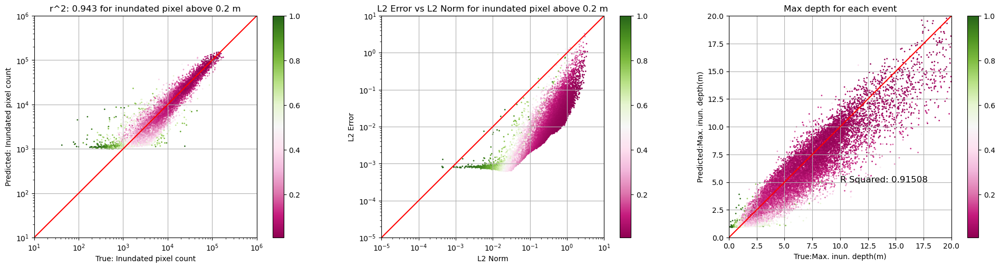

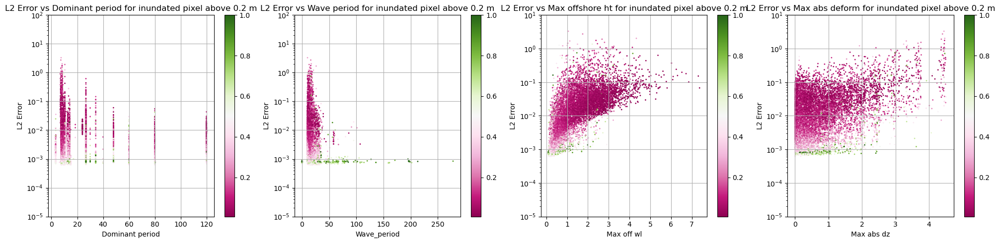

In [4]:
eve_perf = pd.read_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv')
eve_perf = eve_perf[eve_perf['split']== 'test']
eve_perf = eve_perf[eve_perf['max_off']>0.1]
eve_perf.reset_index(drop=True, inplace=True)
#filter events with G greater than 0.3  or r2 less than 0.7
# eve_perf = eve_perf[(eve_perf['g']>0.3)] #
# print('events with G greater than 0.3',len(eve_perf))

# Create a single figure with three axes
fig, ax = plt.subplots(1, 3, figsize=(20, 5))

# Plot scatter of flood count
r2area = r2_score(eve_perf['true'], eve_perf['pred'])
scatter = ax[0].scatter(eve_perf['true'], eve_perf['pred'], s=1, c=eve_perf['g'], cmap='PiYG')
ax[0].plot([0, 1], [0, 1], transform=ax[0].transAxes, color='red')
ax[0].set_title(f"r^2: {r2area:.3f} for inundated pixel above 0.2 m")
plt.colorbar(scatter, ax=ax[0])
ax[0].set_aspect('equal', adjustable='box')
ax[0].set_xscale('log')
ax[0].set_yscale('log')
ax[0].set_xlim(10, 1000000)
ax[0].set_ylim(10, 1000000)
ax[0].grid()
ax[0].set_xlabel('True: Inundated pixel count')
ax[0].set_ylabel('Predicted: Inundated pixel count')

# Plot scatter of mse vs l2norm
scatter = ax[1].scatter(eve_perf['l2n'], eve_perf['mse'], s=1, c=eve_perf['g'], cmap='PiYG')
ax[1].plot([0, 1], [0, 1], transform=ax[1].transAxes, color='red')
plt.colorbar(scatter, ax=ax[1])
ax[1].set_title(f"L2 Error vs L2 Norm for inundated pixel above 0.2 m")
ax[1].set_aspect('equal', adjustable='box')
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].set_xlim(.00001, 10)
ax[1].set_ylim(.00001, 10)
ax[1].grid()
ax[1].set_xlabel('L2 Norm')
ax[1].set_ylabel('L2 Error')

# Plot scatter of max depth for each event
# Calculate the point density
eve_perf.reset_index(drop=True, inplace=True) #reset index
x = eve_perf['truemax']
y = eve_perf['predmax']
z = eve_perf['g']
r2maxdepth = r2_score(x, y)
scatter = ax[2].scatter(x, y, c=z, s=1, cmap='PiYG')
ax[2].plot([0, 1], [0, 1], transform=ax[2].transAxes, color='red')
plt.colorbar(scatter, ax=ax[2])
ax[2].set_title("Max depth for each event")
ax[2].text(10, 5, f"R Squared: {r2maxdepth:.5f} ", fontsize=12)
ax[2].set_aspect('equal', adjustable='box')
ax[2].set_xlim(0, 20)
ax[2].set_ylim(0, 20)
ax[2].grid()
plt.xlabel('True:Max. inun. depth(m)')
plt.ylabel('Predicted:Max. inun. depth(m)')

# Adjust layout and add a suptitle to the main plot
plt.tight_layout()


# Create a single figure with three axes
fig, ax = plt.subplots(1, 4, figsize=(20, 5))

# Plot scatter of mse vs dominant wp
scatter = ax[0].scatter(eve_perf['dominant_period'], eve_perf['mse'], s=1, c=eve_perf['g'], cmap='PiYG')
# ax[0].plot([0, 1], [0, 1], transform=ax[0].transAxes, color='red')
plt.colorbar(scatter, ax=ax[0])
ax[0].set_title(f"L2 Error vs Dominant period for inundated pixel above 0.2 m")
# ax[0].set_aspect('equal', adjustable='box')
# ax[0].set_xscale('log')
ax[0].set_yscale('log')
# ax[0].set_xlim(.00001, 100)
ax[0].set_ylim(.00001, 100)
ax[0].grid()
ax[0].set_xlabel('Dominant period')
ax[0].set_ylabel('L2 Error')

# Plot scatter of mse vs dominant wp
scatter = ax[1].scatter(eve_perf['wave_period'], eve_perf['mse'], s=1, c=eve_perf['g'], cmap='PiYG')
# ax[1].plot([0, 1], [0, 1], transform=ax[1].transAxes, color='red')
plt.colorbar(scatter, ax=ax[1])
ax[1].set_title(f"L2 Error vs Wave period for inundated pixel above 0.2 m")
# ax[1].set_aspect('equal', adjustable='box')
# ax[1].set_xscale('log')
ax[1].set_yscale('log')
# ax[1].set_xlim(.00001, 100)
ax[1].set_ylim(.00001, 100)
ax[1].grid()
ax[1].set_xlabel('Wave_period')
ax[1].set_ylabel('L2 Error')

# Plot scatter of mse vs max_off
scatter = ax[2].scatter(eve_perf['max_off'], eve_perf['mse'], s=1, c=eve_perf['g'], cmap='PiYG')
# ax[2].plot([0, 1], [0, 1], transform=ax[2].transAxes, color='red')
plt.colorbar(scatter, ax=ax[2])
ax[2].set_title(f"L2 Error vs Max offshore ht for inundated pixel above 0.2 m")
# ax[2].set_aspect('equal', adjustable='box')
# ax[2].set_xscale('log')
ax[2].set_yscale('log')
# ax[2].set_xlim(.00001, 100)
ax[2].set_ylim(.00001, 10)
ax[2].grid()
ax[2].set_xlabel('Max off wl')
ax[2].set_ylabel('L2 Error')

# Plot scatter of mse vs max_absdz
scatter = ax[3].scatter(eve_perf['max_absdz'], eve_perf['mse'], s=1, c=eve_perf['g'], cmap='PiYG')
# ax[2].plot([0, 1], [0, 1], transform=ax[2].transAxes, color='red')
plt.colorbar(scatter, ax=ax[3])
ax[3].set_title(f"L2 Error vs Max abs deform for inundated pixel above 0.2 m")
# ax[2].set_aspect('equal', adjustable='box')
# ax[2].set_xscale('log')
ax[3].set_yscale('log')
# ax[2].set_xlim(.00001, 100)
ax[3].set_ylim(.00001, 10)
ax[3].grid()
ax[3].set_xlabel('Max abs dz')
ax[3].set_ylabel('L2 Error')

# Adjust layout and add a suptitle to the main plot
plt.tight_layout()


In [3]:
#select particular representative gauge
reg = 'SR'

list_size = ['961','1773','3669','6941']
columnname = str(54)
mask_size = list_size[0]
train_size = list_size[1]

events with G greater than 0.3 11466


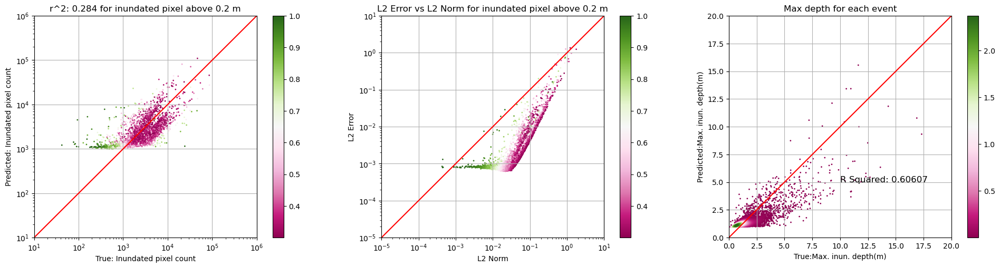

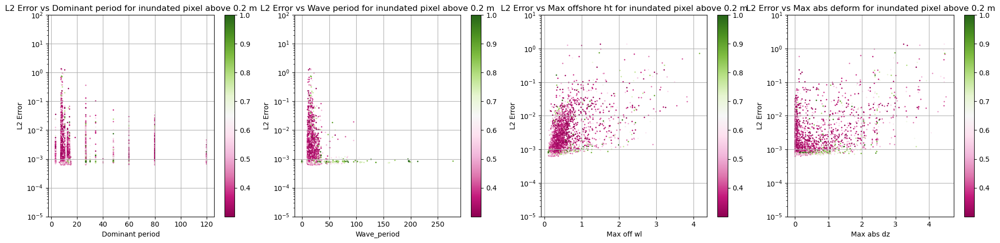

In [7]:
eve_perf = pd.read_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv')
eve_perf = eve_perf[eve_perf['split']== 'test']
eve_perf = eve_perf[eve_perf['max_off']>0.1]
eve_perf.reset_index(drop=True, inplace=True)
#filter events with G greater than 0.3  or r2 less than 0.7
eve_perf = eve_perf[(eve_perf['g']>0.3)] #
print('events with G greater than 0.3',len(eve_perf))

# Create a single figure with three axes
fig, ax = plt.subplots(1, 3, figsize=(20, 5))

# Plot scatter of flood count
r2area = r2_score(eve_perf['true'], eve_perf['pred'])
scatter = ax[0].scatter(eve_perf['true'], eve_perf['pred'], s=1, c=eve_perf['g'], cmap='PiYG')
ax[0].plot([0, 1], [0, 1], transform=ax[0].transAxes, color='red')
ax[0].set_title(f"r^2: {r2area:.3f} for inundated pixel above 0.2 m")
plt.colorbar(scatter, ax=ax[0])
ax[0].set_aspect('equal', adjustable='box')
ax[0].set_xscale('log')
ax[0].set_yscale('log')
ax[0].set_xlim(10, 1000000)
ax[0].set_ylim(10, 1000000)
ax[0].grid()
ax[0].set_xlabel('True: Inundated pixel count')
ax[0].set_ylabel('Predicted: Inundated pixel count')

# Plot scatter of mse vs l2norm
scatter = ax[1].scatter(eve_perf['l2n'], eve_perf['mse'], s=1, c=eve_perf['g'], cmap='PiYG')
ax[1].plot([0, 1], [0, 1], transform=ax[1].transAxes, color='red')
plt.colorbar(scatter, ax=ax[1])
ax[1].set_title(f"L2 Error vs L2 Norm for inundated pixel above 0.2 m")
ax[1].set_aspect('equal', adjustable='box')
ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].set_xlim(.00001, 10)
ax[1].set_ylim(.00001, 10)
ax[1].grid()
ax[1].set_xlabel('L2 Norm')
ax[1].set_ylabel('L2 Error')

# Plot scatter of max depth for each event
# Calculate the point density
eve_perf.reset_index(drop=True, inplace=True) #reset index
x = eve_perf['truemax']
y = eve_perf['predmax']
r2maxdepth = r2_score(x, y)
xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)
index = z.argsort()
x, y, z = x[index], y[index], z[index]
scatter = ax[2].scatter(x, y, c=z, s=1, cmap='PiYG')
ax[2].plot([0, 1], [0, 1], transform=ax[2].transAxes, color='red')
plt.colorbar(scatter, ax=ax[2])
ax[2].set_title("Max depth for each event")
ax[2].text(10, 5, f"R Squared: {r2maxdepth:.5f} ", fontsize=12)
ax[2].set_aspect('equal', adjustable='box')
ax[2].set_xlim(0, 20)
ax[2].set_ylim(0, 20)
ax[2].grid()
plt.xlabel('True:Max. inun. depth(m)')
plt.ylabel('Predicted:Max. inun. depth(m)')

# Adjust layout and add a suptitle to the main plot
plt.tight_layout()


# Create a single figure with three axes
fig, ax = plt.subplots(1, 4, figsize=(20, 5))

# Plot scatter of mse vs dominant wp
scatter = ax[0].scatter(eve_perf['dominant_period'], eve_perf['mse'], s=1, c=eve_perf['g'], cmap='PiYG')
# ax[0].plot([0, 1], [0, 1], transform=ax[0].transAxes, color='red')
plt.colorbar(scatter, ax=ax[0])
ax[0].set_title(f"L2 Error vs Dominant period for inundated pixel above 0.2 m")
# ax[0].set_aspect('equal', adjustable='box')
# ax[0].set_xscale('log')
ax[0].set_yscale('log')
# ax[0].set_xlim(.00001, 100)
ax[0].set_ylim(.00001, 100)
ax[0].grid()
ax[0].set_xlabel('Dominant period')
ax[0].set_ylabel('L2 Error')

# Plot scatter of mse vs dominant wp
scatter = ax[1].scatter(eve_perf['wave_period'], eve_perf['mse'], s=1, c=eve_perf['g'], cmap='PiYG')
# ax[1].plot([0, 1], [0, 1], transform=ax[1].transAxes, color='red')
plt.colorbar(scatter, ax=ax[1])
ax[1].set_title(f"L2 Error vs Wave period for inundated pixel above 0.2 m")
# ax[1].set_aspect('equal', adjustable='box')
# ax[1].set_xscale('log')
ax[1].set_yscale('log')
# ax[1].set_xlim(.00001, 100)
ax[1].set_ylim(.00001, 100)
ax[1].grid()
ax[1].set_xlabel('Wave_period')
ax[1].set_ylabel('L2 Error')

# Plot scatter of mse vs max_off
scatter = ax[2].scatter(eve_perf['max_off'], eve_perf['mse'], s=1, c=eve_perf['g'], cmap='PiYG')
# ax[2].plot([0, 1], [0, 1], transform=ax[2].transAxes, color='red')
plt.colorbar(scatter, ax=ax[2])
ax[2].set_title(f"L2 Error vs Max offshore ht for inundated pixel above 0.2 m")
# ax[2].set_aspect('equal', adjustable='box')
# ax[2].set_xscale('log')
ax[2].set_yscale('log')
# ax[2].set_xlim(.00001, 100)
ax[2].set_ylim(.00001, 10)
ax[2].grid()
ax[2].set_xlabel('Max off wl')
ax[2].set_ylabel('L2 Error')

# Plot scatter of mse vs max_absdz
scatter = ax[3].scatter(eve_perf['max_absdz'], eve_perf['mse'], s=1, c=eve_perf['g'], cmap='PiYG')
# ax[2].plot([0, 1], [0, 1], transform=ax[2].transAxes, color='red')
plt.colorbar(scatter, ax=ax[3])
ax[3].set_title(f"L2 Error vs Max abs deform for inundated pixel above 0.2 m")
# ax[2].set_aspect('equal', adjustable='box')
# ax[2].set_xscale('log')
ax[3].set_yscale('log')
# ax[2].set_xlim(.00001, 100)
ax[3].set_ylim(.00001, 10)
ax[3].grid()
ax[3].set_xlabel('Max abs dz')
ax[3].set_ylabel('L2 Error')

# Adjust layout and add a suptitle to the main plot
plt.tight_layout()


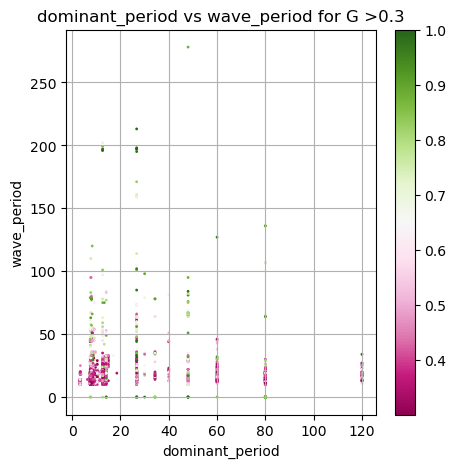

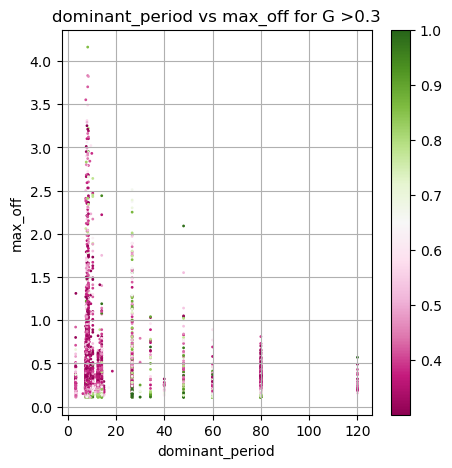

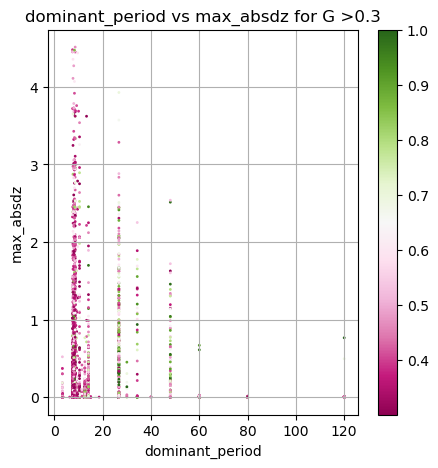

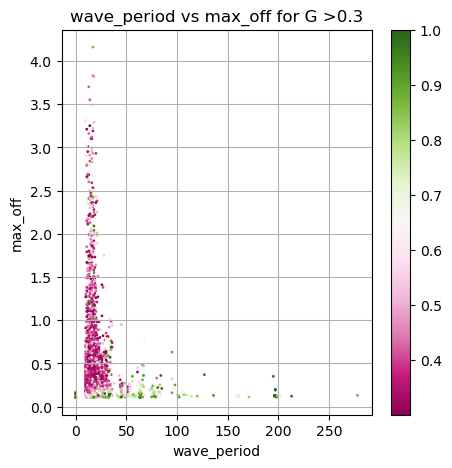

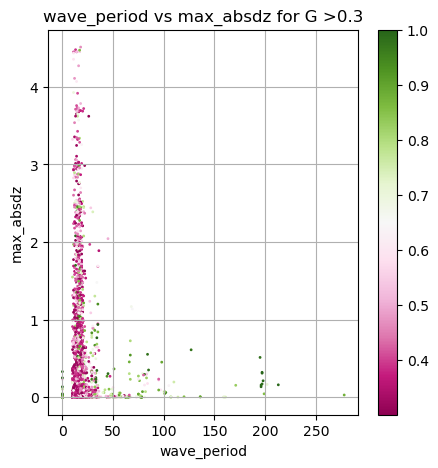

...

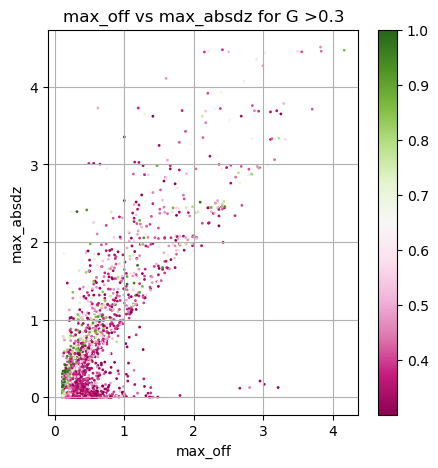

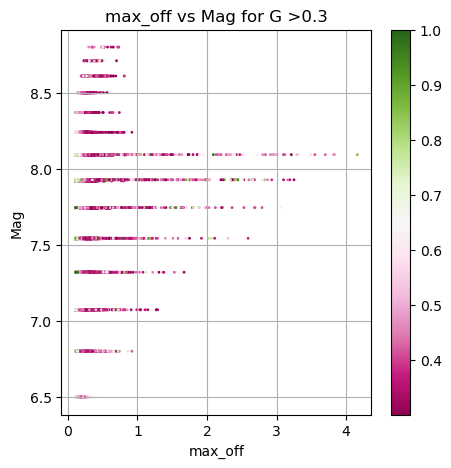

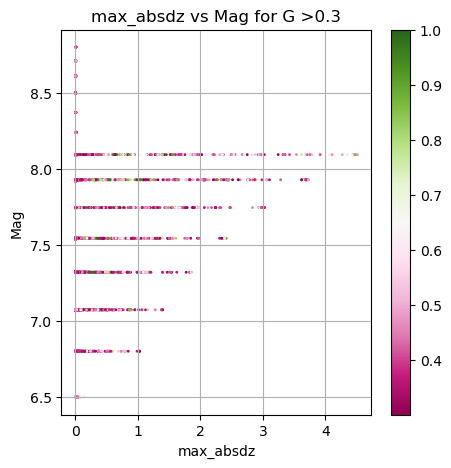

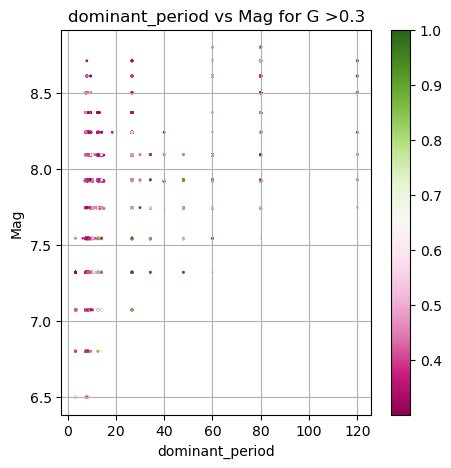

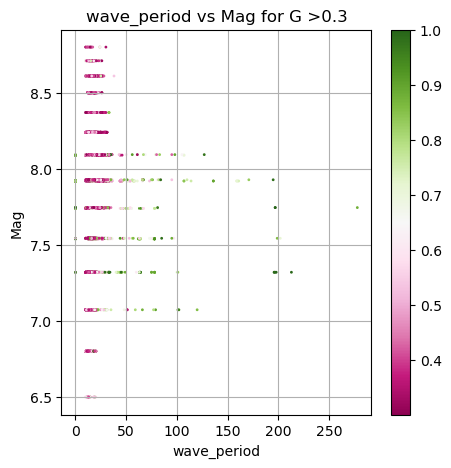

In [8]:
#plot events scatter using  2 of the physical parameters from - dominant period, wave period, max_off, max_absdz
combinations = [
    ('dominant_period', 'wave_period'),
    ('dominant_period', 'max_off'),
    ('dominant_period', 'max_absdz'),
    ('wave_period', 'max_off'),
    ('wave_period', 'max_absdz'), 
    ('max_off', 'max_absdz'),
    ('max_off', 'max_absdz'),
    ('max_off', 'Mag'),
    ('max_absdz', 'Mag'),
    ('dominant_period', 'Mag'),
    ('wave_period', 'Mag'),
    ]

#source and MW

for comb in combinations:
    fig, ax = plt.subplots(1, 1, figsize=(5, 5))
    scatter = ax.scatter(eve_perf[comb[0]], eve_perf[comb[1]], s=1, c=eve_perf['g'], cmap='PiYG')
    plt.colorbar(scatter, ax=ax)
    ax.set_title(f"{comb[0]} vs {comb[1]} for G >0.3")
    # ax.set_aspect('equal', adjustable='box')
    # ax.set_xscale('log')
    # ax.set_yscale('log')
    ax.grid()
    ax.set_xlabel(comb[0])
    ax.set_ylabel(comb[1])
    # plt.savefig(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_combined_{comb[0]}_{comb[1]}.png')
    plt.show()


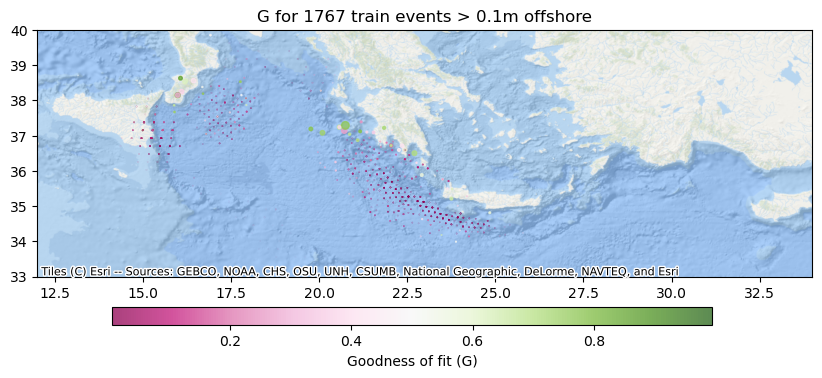

In [9]:
import matplotlib.pyplot as plt
import contextily as cx
#load file
eve_perf = pd.read_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv')
sample_test = eve_perf[eve_perf['split']=='train']

# Create the figure and axes
fig, ax = plt.subplots(figsize=(10, 7))

# Set the title
ax.set_title('G for ' + str(len(sample_test)) + ' train events > 0.1m offshore')

# Create a scatter plot
scatter = ax.scatter(sample_test['lon'], sample_test['lat'], c=sample_test['g'],
                      cmap='PiYG', s=sample_test['mean_prob'] * 1000000, alpha=0.75)

# Set the plot limits
plt.xlim(12, 34)
plt.ylim(33, 40)

# Add a basemap
cx.add_basemap(ax, crs='EPSG:4326', source=cx.providers.Esri.OceanBasemap)

# Position the colorbar inside the map plot
cax = fig.add_axes([0.2, 0.25, 0.60, 0.025])  # Adjust the position as needed
cbar = plt.colorbar(scatter, cax=cax, orientation='horizontal', label='Goodness of fit (G)')

# Show the plot
plt.show()


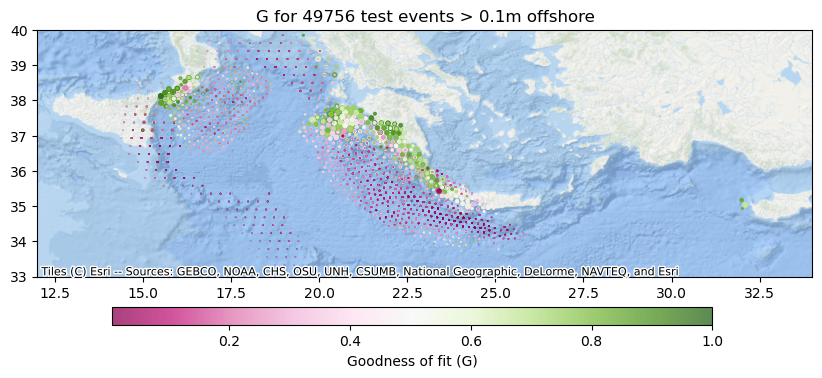

In [10]:
import matplotlib.pyplot as plt
import contextily as cx
#load file
eve_perf = pd.read_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv')
eve_perf = eve_perf[eve_perf['max_off'] > 0.1]
sample_test = eve_perf[eve_perf['split']=='test']

# Create the figure and axes
fig, ax = plt.subplots(figsize=(10, 7))

# Set the title
ax.set_title('G for ' + str(len(sample_test)) + ' test events > 0.1m offshore')

# Create a scatter plot
scatter = ax.scatter(sample_test['lon'], sample_test['lat'], c=sample_test['g'],
                      cmap='PiYG', s=sample_test['mean_prob'] * 600000, alpha=0.75)

# Set the plot limits
plt.xlim(12, 34)
plt.ylim(33, 40)

# Add a basemap
cx.add_basemap(ax, crs='EPSG:4326', source=cx.providers.Esri.OceanBasemap)

# Position the colorbar inside the map plot
cax = fig.add_axes([0.2, 0.25, 0.60, 0.025])  # Adjust the position as needed
cbar = plt.colorbar(scatter, cax=cax, orientation='horizontal', label='Goodness of fit (G)')

# Show the plot
plt.show()


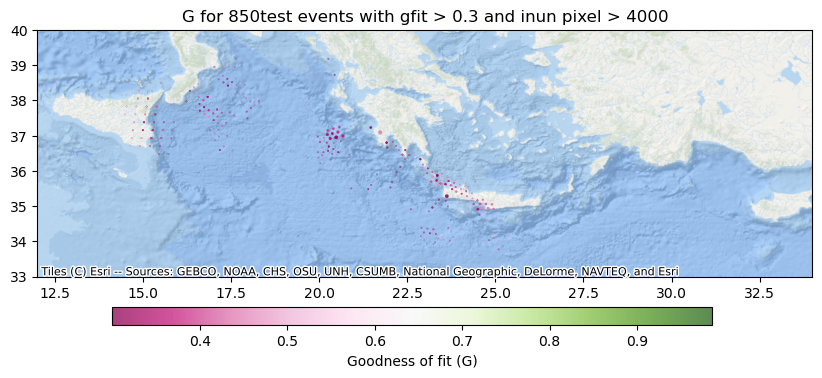

In [11]:
import matplotlib.pyplot as plt
import contextily as cx
#load file

#filter events with G greater than 0.3  or r2 less than 0.7
sample_test = sample_test[(sample_test['g']>0.3)] #
sample_test = sample_test[sample_test['true']>4000]

# Create the figure and axes
fig, ax = plt.subplots(figsize=(10, 7))

# Set the title
ax.set_title('G for ' + str(len(sample_test)) + 'test events with gfit > 0.3 and inun pixel > 4000')

# Create a scatter plot
scatter = ax.scatter(sample_test['lon'], sample_test['lat'], c=sample_test['g'],
                      cmap='PiYG', s=sample_test['mean_prob'] * 600000, alpha=0.75)

# Set the plot limits
plt.xlim(12, 34)
plt.ylim(33, 40)

# Add a basemap
cx.add_basemap(ax, crs='EPSG:4326', source=cx.providers.Esri.OceanBasemap)

# Position the colorbar inside the map plot
cax = fig.add_axes([0.2, 0.25, 0.60, 0.025])  # Adjust the position as needed
cbar = plt.colorbar(scatter, cax=cax, orientation='horizontal', label='Goodness of fit (G)')

# Show the plot
plt.show()


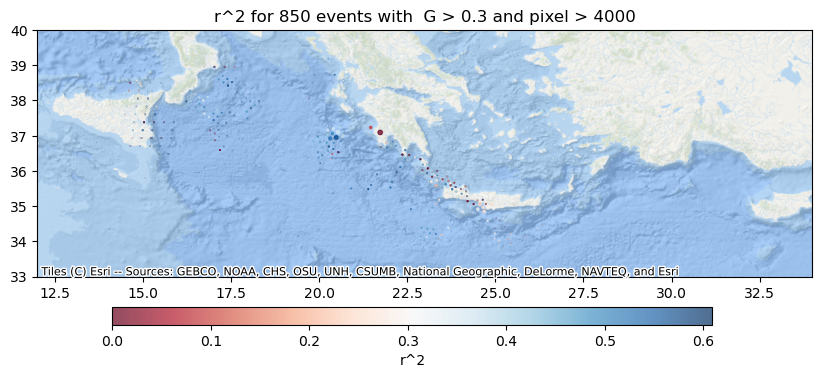

In [12]:
#plot events with lat lon and r2score as color
#load file

#set r2score to -1 if it is negative
sample_test.loc[sample_test['r2'] < 0, 'r2'] = 0
# Create the figure and axes
fig, ax = plt.subplots(figsize=(10, 7))

# Set the title
ax.set_title('r^2 for ' + str(len(sample_test)) + ' events with  G > 0.3 and pixel > 4000')

# Create a scatter plot
scatter = ax.scatter(sample_test['lon'], sample_test['lat'], c=sample_test['r2'],
                      cmap='RdBu', s=sample_test['mean_prob'] * 1500000, alpha=0.7)

# Set the plot limits
plt.xlim(12, 34)
plt.ylim(33, 40)

# Add a basemap
cx.add_basemap(ax, crs='EPSG:4326', source=cx.providers.Esri.OceanBasemap)

# Position the colorbar inside the map plot
cax = fig.add_axes([0.2, 0.25, 0.60, 0.025])  # Adjust the position as needed
cbar = plt.colorbar(scatter, cax=cax, orientation='horizontal', label='r^2')

# Show the plot
plt.show()


In [13]:
import folium
import pandas as pd
import numpy as np


#read train events
train_events = np.loadtxt(f'{MLDir}/data/events/shuffled_events_{reg}_{train_size}.txt', dtype='str')

#Create location keyword
DF_eve = pd.read_csv(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/info/sampling_input_{reg}_{columnname}.csv')

#event_list train events, pick form DF_eve
Train_eve = DF_eve[DF_eve['id'].isin(train_events)]

#Unique EQ locations overall
unique_locations = len(DF_eve['Location'].unique())
print('uniques EQ locations in the dataset:',unique_locations)

#filter 1 row per unique location from list of DF_eve
DF_eve_unique = DF_eve.drop_duplicates(subset=['Location'], keep='first')
#reset index
DF_eve_unique.reset_index(drop=True, inplace=True)

#unique locations for training events
unique_locations_train = len(Train_eve['Location'].unique())
print('uniques EQ locations in the training dataset:',unique_locations_train)

#unique locations for test events
unique_locations_bad = len(sample_test['Location'].unique())
print('uniques EQ locations in the bad events:',unique_locations_bad)

#filter 1 row per unique location from list of train list
Train_eve_unique = Train_eve.drop_duplicates(subset=['Location'], keep='first')
#reset index
Train_eve_unique.reset_index(drop=True, inplace=True)


#filter 1 row per unique location from list of bad list
Test_eve_unique = sample_test.drop_duplicates(subset=['Location'], keep='first')
#reset index
Test_eve_unique.reset_index(drop=True, inplace=True)

data_pts = np.loadtxt('/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/resources/raw/pois_eastern_sicily_2km.txt', dtype=str)
id_pts = data_pts[:, 0]
lon_pts = data_pts[:, 1].astype(float)
lat_pts = data_pts[:, 2].astype(float)
z_pts = data_pts[:, 3].astype(float)

#Create a map with the unique locations
eve_map = folium.Map(location=[np.mean(DF_eve_unique['lat']),
                               np.mean(DF_eve_unique['lon'])],
                               zoom_start=7, tiles='OpenStreetMap')

# Basemaps
folium.TileLayer(tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
        attr = 'Esri',
        name = 'Esri Satellite',
        overlay = False,
        control = True,
        show = False).add_to(eve_map)

# Create a feature group for the offshore points and eq loc 
fg_pts = folium.FeatureGroup(name='Offshore Points Txt').add_to(eve_map)
fg_Unq_EQ = folium.FeatureGroup(name='Unique EQ Location').add_to(eve_map)
fg_Train_EQ = folium.FeatureGroup(name='Train EQ Location').add_to(eve_map)
fg_test_bad = folium.FeatureGroup(name='Test EQ Location Bad').add_to(eve_map)

for i in range(len(DF_eve_unique)-1):
    folium.CircleMarker([DF_eve_unique.loc[i+1,'lat'], DF_eve_unique.loc[i+1,'lon']],radius= 3,color = 'green',opacity=0.95 ).add_to(fg_Unq_EQ)

for i in range(len(Train_eve_unique)-1):
    folium.CircleMarker([Train_eve_unique.loc[i+1,'lat'], Train_eve_unique.loc[i+1,'lon']],radius= 1,color = 'red',opacity=0.95 ).add_to(fg_Train_EQ)

for i in range(len(Test_eve_unique)-1):
    folium.CircleMarker([Test_eve_unique.loc[i+1,'lat'], Test_eve_unique.loc[i+1,'lon']],radius= 1,color = 'blue',opacity=0.95 ).add_to(fg_test_bad)

for id, lat, lon,z in zip(id_pts, lat_pts, lon_pts, z_pts):
    info = f"ID:{id}, Depth: {z} "  # Create tooltip string
    folium.CircleMarker(location=[lat, lon],
                  tooltip=info,radius=0.5,
                  icon=folium.Icon(color='blue', icon='')).add_to(fg_pts)
    

folium.LayerControl().add_to(eve_map)   

# for i in range(len(sample_test)-1):
#     folium.CircleMarker([sample_test.loc[i+1,'lat'], sample_test.loc[i+1,'lon']],radius= 1,color = 'blue',opacity=0.95 ).add_to(fg_test_bad)

# # Save the map as an HTML file or plot here
# # eve_map.save('tsu_PS_eve_map.html')

eve_map


uniques EQ locations in the dataset: 1283
uniques EQ locations in the training dataset: 467
uniques EQ locations in the bad events: 281


[29720, 202349, 153030, 94497]
Control Location:1,No of flood events:2903/53550
Control Location:2,No of flood events:28895/53550
Control Location:3,No of flood events:6602/53550
Control Location:4,No of flood events:10843/53550


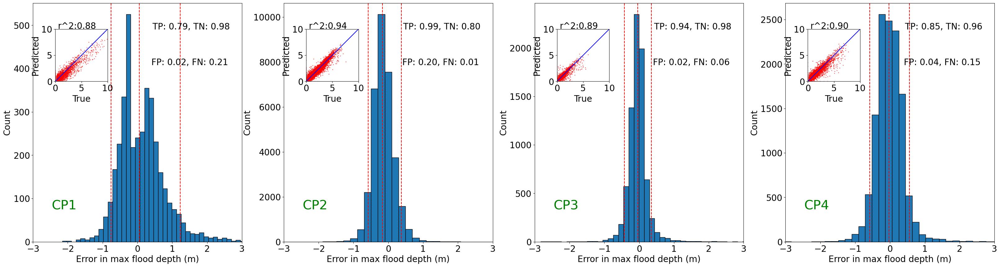

In [18]:
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import xarray as xr

def get_idx_from_latlon(locations,reg,MLDir,SimDir,mask_size):  
    #get first event to get lat lon
    firstevent = np.loadtxt(f'{MLDir}/data/events/sample_events53550.txt',dtype='str')[0]
    D_grids = xr.open_dataset(f'{SimDir}/{firstevent}/{reg}_flowdepth.nc')
    zero_mask = np.load(f'{MLDir}/data/processed/zero_mask_{reg}_{mask_size}.npy')
    non_zero_list = np.argwhere(~zero_mask).tolist()

    #iterate over list locations
    indices = []
    for loc in locations: 
        #get index of lat lon
        lat_idx = np.argmin(np.abs(D_grids.lat.values - loc[0]))
        lon_idx = np.argmin(np.abs(D_grids.lon.values - loc[1]))

        #get idx in non zero mask list from lat_idx and lon_idx
        idx = non_zero_list.index([lat_idx,lon_idx])
        indices.append(idx)

    # return lat_idx, lon_idx, idx
    print(indices)
    return indices

threshold = 0.2
control_points = [[37.01,15.29],
            [37.06757,15.28709],
            [37.05266,15.26536],
            [37.03211,15.28632]]
#[587734, 575410, 543846, 520437, 519950, 494033, 410933, 329708, 233614, 158611, 83994, 314698]

#keep every second element from the list
# control_points = control_points[::1]
locindices = get_idx_from_latlon(control_points,reg,MLDir,SimDir,mask_size)

true_pred_er = pd.read_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_true_pred_er_combined.csv')
#keep every second column from the dataframe
# true_pred_er = true_pred_er.iloc[:,::2]
#filter all columns with column name starting with E of true_pred_er
er_list = true_pred_er.iloc[:,true_pred_er.columns.str.startswith('E')].values 
#remove first and last column 
true_pred_er = true_pred_er.iloc[:,1:-1].values

#error charts
plt.figure(figsize=(40, 10))
for i in range(len(locindices)):
    ax = plt.subplot(1, 4, i+1)
    # Plot the histogram of errors for the control locations
    plt.hist(er_list[er_list[:,i]!=0,i],bins=40,edgecolor='black',)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    # Check if its empty
    if len(er_list[er_list[:,i]!=0,i]) == 0:
        continue
    else:
        quantiles = np.percentile(er_list[er_list[:,i]!=0,i], [5, 50, 95])
        # Plot quantile lines
        for q in quantiles:
            ax.axvline(q, color='red', linestyle='--', label=f'Q{int(q)}')
        ax.set_xlim(-3, 3)
    #calculate hit and mis for each location based on depth of true and prediction
    #events crossing the threshold say 0.2 are considered flooded
    neve = np.count_nonzero(true_pred_er[:,i]>threshold)
    neve_recon = np.count_nonzero(true_pred_er[:,i+len(locindices)]>threshold)
    print(f"Control Location:{i+1},No of flood events:{neve}/{len(true_pred_er[:,i])}")
    if neve == 0:
        TP = -999
        FN = -999
    else:
    #true positive: true>0.2 and pred>0.2
        TP = np.count_nonzero((true_pred_er[:,i]>threshold) & (true_pred_er[:,i+len(locindices)]>threshold))/(neve)
        FN = np.count_nonzero((true_pred_er[:,i]>threshold) & (true_pred_er[:,i+len(locindices)]<=threshold))/(neve)
    TN = np.count_nonzero((true_pred_er[:,i]<=threshold) & (true_pred_er[:,i+len(locindices)]<=threshold))/(len(true_pred_er[:,i])-neve)
    FP = np.count_nonzero((true_pred_er[:,i]<=threshold) & (true_pred_er[:,i+len(locindices)]>threshold))/(len(true_pred_er[:,i])-neve)
    # plt.title(f"#flood events:True={neve}|Predicted={neve_recon}",fontsize=20)
    plt.text(0.15,0.15,f"CP{i+1}", horizontalalignment='center',verticalalignment='center', transform=plt.gca().transAxes,fontsize=30,color='green')
    plt.text(0.75, 0.9, f" TP: {TP:.2f}, TN: {TN:.2f}", horizontalalignment='center',verticalalignment='center', transform=plt.gca().transAxes,fontsize=20)
    plt.text(0.75, 0.75, f"FP: {FP:.2f}, FN: {FN:.2f}", horizontalalignment='center',verticalalignment='center', transform=plt.gca().transAxes,fontsize=20)
    plt.xlabel('Error in max flood depth (m)',fontsize=20)
    plt.ylabel('Count',fontsize=20)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)

    # Create a new inset axis for the scatter plot
    axins = inset_axes(ax, width="25%", height="25%", loc='upper left', borderpad=5.2)
    # Scatter plot of values (replace with your data)
    axins.plot([0, 1], [0, 1], transform=axins.transAxes, color='blue')
    axins.scatter(true_pred_er[:,i], true_pred_er[:,i+len(locindices)], marker='o', color='red', label='Max Inun Depth',s=0.33)  # Customize marker and color as needed
    axins.text(0.5,10.1,f'r^2:{r2_score(true_pred_er[:,i], true_pred_er[:,i+len(locindices)]):.2f}',fontsize=20)
    axins.set_xlim(0, 10)  # Adjust x-axis limits for the scatter plot
    axins.set_ylim(0, 10)  # Adjust y-axis limits for the scatter plot
    axins.set_xticks([0, 5, 10])  # Adjust x-axis ticks for the scatter plot
    axins.set_yticks([0, 5, 10])  # Adjust y-axis ticks for the scatter plot
    axins.set_xlabel('True',fontsize=20)
    axins.set_ylabel('Predicted',fontsize=20)
    axins.set_aspect('equal', adjustable='box')
    axins.tick_params(axis='x', labelsize=20)
    axins.tick_params(axis='y', labelsize=20)
plt.savefig(f'{MLDir}/model/{reg}/results/error_test_combined_{reg}_{train_size}.png', transparent=False)


In [4]:
#read combined file :/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/CT/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_892_compile_combined.csv
combined = pd.read_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv')

#sort by mse
combined = combined.sort_values(by='mse',ascending=False)

#find 95th percentile mse 
percentile95 = combined['mse'].quantile(0.99)

#filter events with mse greater than 95th percentile
bad_events = combined[combined['mse']>percentile95]

#sort by mse and reset index
bad_events = bad_events.sort_values(by='mse',ascending=False)
bad_events.reset_index(drop=True, inplace=True)

#save bad events to a file
bad_events.to_csv(f'{MLDir}/model/{reg}/results/Q99_events_{reg}_{train_size}.csv',index=False)


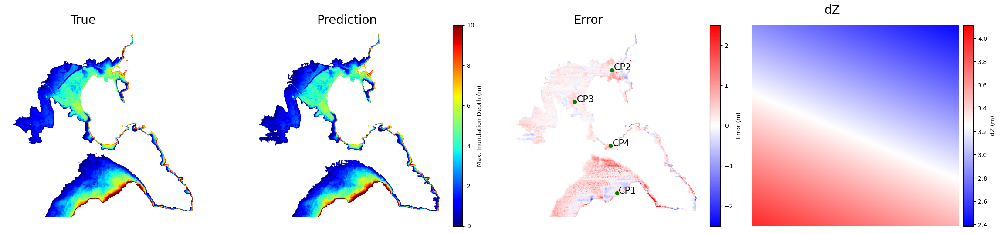

In [6]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from sklearn.metrics import r2_score
import xarray as xr

#select particular representative gauge
reg = 'SR'
list_size = ['961','1773','3669','6941']
columnname = str(54)
mask_size = '961'
train_size = list_size[1]
test_size = 3
idx= np.load(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/processed/lat_lon_idx_{reg}_{mask_size}.npy')
#add recon and true column to to the idx array
n_eve = len(np.loadtxt(f'{MLDir}/data/events/shuffled_events_test_{reg}_{test_size}.txt', dtype='str'))
nflood_grids = len(idx)
red_d_array = np.memmap(f'{MLDir}/data/processed/dflat_{reg}_{test_size}.dat',
                        mode='r',
                        dtype=float,
                        shape=(n_eve, nflood_grids))

id = 8761 #BS_manning003/E01267N3753E01646N3535-BS-M809_E01551N3692_D010_S292D70R270_A006995_S075
eve_id = np.loadtxt(f'{MLDir}/data/events/shuffled_events_test_{reg}_{test_size}.txt', dtype='str')[id]

#read dZ file and grid location file to extract location information
data2plot = xr.open_dataset(f'{SimDir}/{eve_id}/{reg}_deformation.nc')
dz = data2plot['deformation'].values# (948 x 1300)
# x = data2plot['x'].values #1300
# y = data2plot['y'].values #948

x = np.linspace(0,dz.shape[1],dz.shape[1])
y = np.linspace(0,dz.shape[0],dz.shape[0])


#create list of x,y,dz
xy_mesh = np.meshgrid(x,y)
x_list,y_list = xy_mesh[0].flatten(),xy_mesh[1].flatten()
dz_list = dz.flatten()


true = red_d_array[id, :]
pred_test = f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/out/postprocessed_trainsize{train_size}_testsize{test_size}.npy'
pred = np.load(pred_test)[id, :]
pred[np.isnan(pred)] = 0
error = true - pred

del red_d_array,pred_test

red_dZ_array = np.memmap(f'{MLDir}/data/processed/dZflat_{reg}_{test_size}.dat',
                            mode='r',
                            dtype=float,
                            shape=(n_eve, nflood_grids))
deform = red_dZ_array[id, :]
del red_dZ_array

idx = np.c_[idx,true,pred,error,deform]

# set values below 0.1 to nan
idx[idx[:,4] < 0.1, 4] = np.nan
idx[idx[:,5] < 0.1, 5] = np.nan

# Using enumerate to add index to the list of coordinates
control_points = [[37.01,15.29],
            [37.06757,15.28709],
            [37.05266,15.26536],
            [37.03211,15.28632]]

coordinates_list = pd.DataFrame(control_points,columns=['lat','lon'])
coordinates_list['id'] = coordinates_list.index+1
CP_list = [29720, 202349, 153030, 94497]
coordinates_list['idx'] = CP_list
coordinates_list['m'] = idx[CP_list, 1]
coordinates_list['n'] = idx[CP_list, 0]

# Plot the true, recon, and error values on the map as color side by side using lat lon
minval = 0
maxval = 10
minerror = -2.5
maxerror = 2.5

fig, axs = plt.subplots(1, 4, figsize=(30, 6))

#set background color as transparent
# fig.patch.set_facecolor('none')

# Plot True
sc1 = axs[0].scatter(idx[:, 1], idx[:, 0], c=idx[:, 4], s=0.1, cmap='jet', vmin=minval, vmax=maxval)
axs[0].text(600,1000,'True',fontsize=20)
axs[0].set_aspect('equal')
axs[0].set_axis_off()

# Plot Prediction
sc2 = axs[1].scatter(idx[:, 1], idx[:, 0], c=idx[:, 5], s=0.1, cmap='jet', vmin=minval, vmax=maxval)
axs[1].text(600,1000,'Prediction',fontsize=20)
axs[1].set_aspect('equal')
axs[1].set_axis_off()

# Plot Error
sc3 = axs[2].scatter(idx[:, 1], idx[:, 0], c=idx[:, 6], s=0.1, cmap='bwr', vmin=minerror, vmax=maxerror)
axs[2].text(600,1000,'Error',fontsize=20)
# Add the control points
axs[2].scatter(coordinates_list['m'],coordinates_list['n'], marker='o', s=33, c='green')
for i, txt in enumerate(coordinates_list['id']):
    axs[2].annotate('CP'+ str(txt), (coordinates_list['m'][i]+10,coordinates_list['n'][i]),fontsize=15)
axs[2].set_aspect('equal')
axs[2].set_axis_off()

# # Plot Deformation
# # sc4 = axs[3].scatter(idx[:, 1], idx[:, 0], c=idx[:, 7], s=0.1, cmap='bwr', vmin=minerror, vmax=maxerror)
sc4 = axs[3].scatter(x_list,y_list,c=dz_list,cmap='bwr')
axs[3].text(600,1000,'dZ',fontsize=20)
axs[3].set_aspect('equal')
axs[3].set_xlim(min(idx[:, 1]), max(idx[:, 1]))
axs[3].set_ylim(min(idx[:, 0]), max(idx[:, 0]))
axs[3].set_axis_off()

# Create a divider for the existing axes instance
divider2 = make_axes_locatable(axs[1])
cax2 = divider2.append_axes('right', size='5%', pad=0.1)  # Adjust the pad as needed
plt.colorbar(sc1, cax=cax2, orientation='vertical', label='Max. Inundation Depth (m)')

# Create a divider for the existing axes instance
divider3 = make_axes_locatable(axs[2])
cax3 = divider3.append_axes('right', size='5%', pad=0.1)  # Adjust the pad as needed
plt.colorbar(sc3, cax=cax3, orientation='vertical', label='Error (m)')

# Create a divider for the existing axes instance
divider1 = make_axes_locatable(axs[3])
cax1 = divider1.append_axes('right', size='5%', pad=0.1)  # Adjust the pad as needed
plt.colorbar(sc4, cax=cax1, orientation='vertical', label='dZ (m)')

# Ensure equal height for subplots
plt.subplots_adjust(wspace=0, hspace=0)

#save as svg
plt.savefig(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/results/Q99eve_example_{reg}.png',dpi=150,transparent=False)
plt.show()

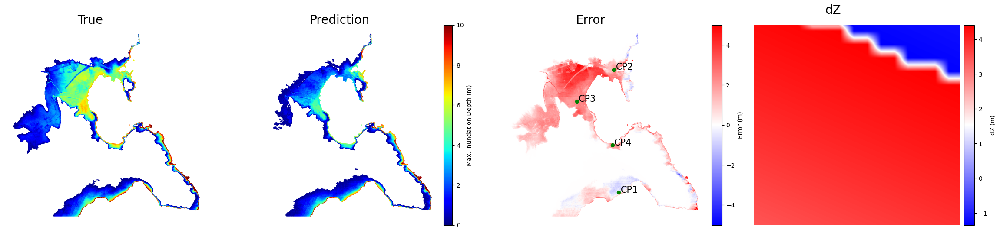

In [5]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from sklearn.metrics import r2_score
import xarray as xr

#select particular representative gauge
reg = 'SR'
list_size = ['961','1773','3669','6941']
columnname = str(54)
mask_size = '961'
train_size = list_size[1]
test_size = 2
idx= np.load(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/data/processed/lat_lon_idx_{reg}_{mask_size}.npy')
#add recon and true column to to the idx array
n_eve = len(np.loadtxt(f'{MLDir}/data/events/shuffled_events_test_{reg}_{test_size}.txt', dtype='str'))
nflood_grids = len(idx)
red_d_array = np.memmap(f'{MLDir}/data/processed/dflat_{reg}_{test_size}.dat',
                        mode='r',
                        dtype=float,
                        shape=(n_eve, nflood_grids))

id = 2247 #BS_manning003/E01267N3753E01646N3535-BS-M809_E01551N3692_D010_S112D70R270_A006995_S075
eve_id = np.loadtxt(f'{MLDir}/data/events/shuffled_events_test_{reg}_{test_size}.txt', dtype='str')[id]

#read dZ file and grid location file to extract location information
data2plot = xr.open_dataset(f'{SimDir}/{eve_id}/{reg}_deformation.nc')
dz = data2plot['deformation'].values# (948 x 1300)
# x = data2plot['x'].values #1300
# y = data2plot['y'].values #948

x = np.linspace(0,dz.shape[1],dz.shape[1])
y = np.linspace(0,dz.shape[0],dz.shape[0])


#create list of x,y,dz
xy_mesh = np.meshgrid(x,y)
x_list,y_list = xy_mesh[0].flatten(),xy_mesh[1].flatten()
dz_list = dz.flatten()


true = red_d_array[id, :]
pred_test = f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/out/postprocessed_trainsize{train_size}_testsize{test_size}.npy'
pred = np.load(pred_test)[id, :]
pred[np.isnan(pred)] = 0
error = true - pred

del red_d_array,pred_test

red_dZ_array = np.memmap(f'{MLDir}/data/processed/dZflat_{reg}_{test_size}.dat',
                            mode='r',
                            dtype=float,
                            shape=(n_eve, nflood_grids))
deform = red_dZ_array[id, :]
del red_dZ_array

idx = np.c_[idx,true,pred,error,deform]

# set values below 0.1 to nan
idx[idx[:,4] < 0.1, 4] = np.nan
idx[idx[:,5] < 0.1, 5] = np.nan

# Using enumerate to add index to the list of coordinates
control_points = [[37.01,15.29],
            [37.06757,15.28709],
            [37.05266,15.26536],
            [37.03211,15.28632]]

coordinates_list = pd.DataFrame(control_points,columns=['lat','lon'])
coordinates_list['id'] = coordinates_list.index+1
CP_list = [29720, 202349, 153030, 94497]
coordinates_list['idx'] = CP_list
coordinates_list['m'] = idx[CP_list, 1]
coordinates_list['n'] = idx[CP_list, 0]

# Plot the true, recon, and error values on the map as color side by side using lat lon
minval = 0
maxval = 10
minerror = -5
maxerror = 5

fig, axs = plt.subplots(1, 4, figsize=(30, 6))

#set background color as transparent
# fig.patch.set_facecolor('none')

# Plot True
sc1 = axs[0].scatter(idx[:, 1], idx[:, 0], c=idx[:, 4], s=0.1, cmap='jet', vmin=minval, vmax=maxval)
axs[0].text(600,1000,'True',fontsize=20)
axs[0].set_aspect('equal')
axs[0].set_axis_off()

# Plot Prediction
sc2 = axs[1].scatter(idx[:, 1], idx[:, 0], c=idx[:, 5], s=0.1, cmap='jet', vmin=minval, vmax=maxval)
axs[1].text(600,1000,'Prediction',fontsize=20)
axs[1].set_aspect('equal')
axs[1].set_axis_off()

# Plot Error
sc3 = axs[2].scatter(idx[:, 1], idx[:, 0], c=idx[:, 6], s=0.1, cmap='bwr', vmin=minerror, vmax=maxerror)
axs[2].text(600,1000,'Error',fontsize=20)
# Add the control points
axs[2].scatter(coordinates_list['m'],coordinates_list['n'], marker='o', s=33, c='green')
for i, txt in enumerate(coordinates_list['id']):
    axs[2].annotate('CP'+ str(txt), (coordinates_list['m'][i]+10,coordinates_list['n'][i]),fontsize=15)
axs[2].set_aspect('equal')
axs[2].set_axis_off()

# # Plot Deformation
# # sc4 = axs[3].scatter(idx[:, 1], idx[:, 0], c=idx[:, 7], s=0.1, cmap='bwr', vmin=minerror, vmax=maxerror)
sc4 = axs[3].scatter(x_list,y_list,c=dz_list,cmap='bwr')
axs[3].text(600,1000,'dZ',fontsize=20)
axs[3].set_aspect('equal')
axs[3].set_xlim(min(idx[:, 1]), max(idx[:, 1]))
axs[3].set_ylim(min(idx[:, 0]), max(idx[:, 0]))
axs[3].set_axis_off()

# Create a divider for the existing axes instance
divider2 = make_axes_locatable(axs[1])
cax2 = divider2.append_axes('right', size='5%', pad=0.1)  # Adjust the pad as needed
plt.colorbar(sc1, cax=cax2, orientation='vertical', label='Max. Inundation Depth (m)')

# Create a divider for the existing axes instance
divider3 = make_axes_locatable(axs[2])
cax3 = divider3.append_axes('right', size='5%', pad=0.1)  # Adjust the pad as needed
plt.colorbar(sc3, cax=cax3, orientation='vertical', label='Error (m)')

# Create a divider for the existing axes instance
divider1 = make_axes_locatable(axs[3])
cax1 = divider1.append_axes('right', size='5%', pad=0.1)  # Adjust the pad as needed
plt.colorbar(sc4, cax=cax1, orientation='vertical', label='dZ (m)')

# Ensure equal height for subplots
plt.subplots_adjust(wspace=0, hspace=0)

#save as svg
plt.savefig(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/results/Adv_eve_example_{reg}.png',dpi=150,transparent=False)
plt.show()

In [2]:
sum_wt_err = {}
for train_size in list_size:
    eve_perf = pd.read_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv')
    #calc wt err = sum(mse x prob)
    eve_perf['wt_err'] = eve_perf['mse'] * eve_perf['mean_prob']
    sum_wt_err[train_size] = eve_perf['wt_err'].sum()
print(sum_wt_err)


{'961': 8.074729642383955e-05, '1773': 5.237383212415526e-05, '3669': 2.53399698487706e-05, '6941': 1.8776183844465026e-05}


53550


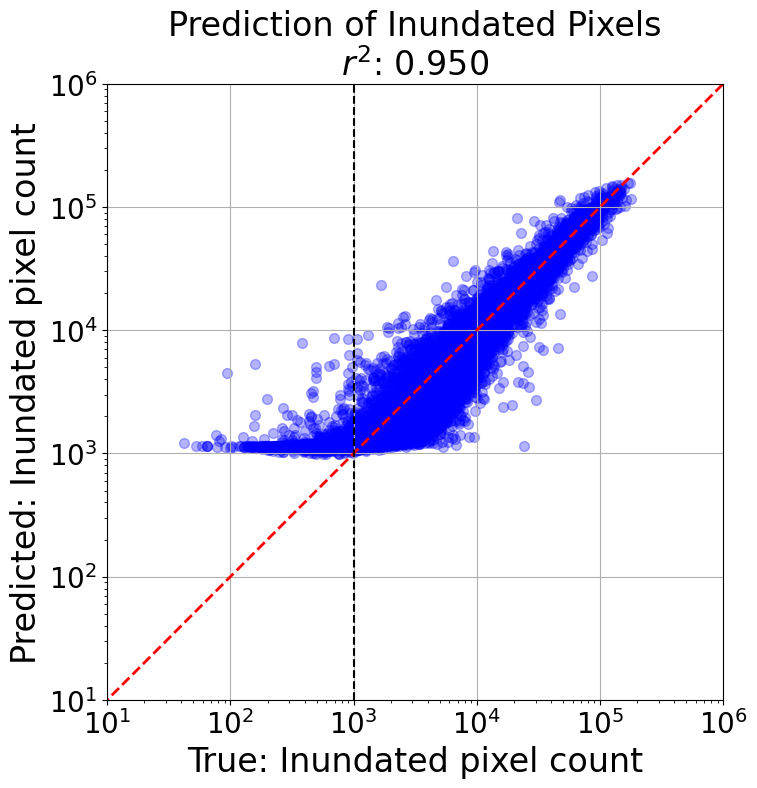

In [27]:
eve_perf = pd.read_csv(f'{MLDir}/model/{reg}/results/model_coupled_off[64, 128, 256]_on[16, 128, 128]_{train_size}_compile_combined.csv')
# eve_perf = eve_perf[eve_perf['max_off']>0.1] #filter as training set
eve_perf.reset_index(drop=True, inplace=True) #reset index
print(len(eve_perf)) #count

#plot scatter of flood count
plt.figure(figsize=(8, 8))
r2floofcount = r2_score(eve_perf['true'], eve_perf['pred'])
plt.scatter(eve_perf['true'], eve_perf['pred'], s=50, alpha=0.3, color='blue', label='Data Points')
# Add a diagonal line (y=x) for reference
plt.plot([0, 250000000], [0, 250000000], color='red', linestyle='--', linewidth=2, label='Ideal Fit')
plt.axvline(x=1000, color='black', linestyle='--',label = 'Threshold')
plt.title(f"Prediction of Inundated Pixels\n$r^2$: {r2floofcount:.3f}", fontsize=24)
plt.gca().set_aspect('equal', adjustable='box')

#use log scale
plt.xscale('log')
plt.yscale('log')
plt.xlim(10, 1000000)
plt.ylim(10, 1000000)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.grid()
plt.xlabel('True: Inundated pixel count',fontsize=24)
plt.ylabel('Predicted: Inundated pixel count',fontsize=24)

#set transparent background and save 
plt.rcParams['axes.facecolor'] = 'none'
plt.savefig(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/CT/results/poster_floodcount.png',dpi=600,transparent=True)
plt.show()

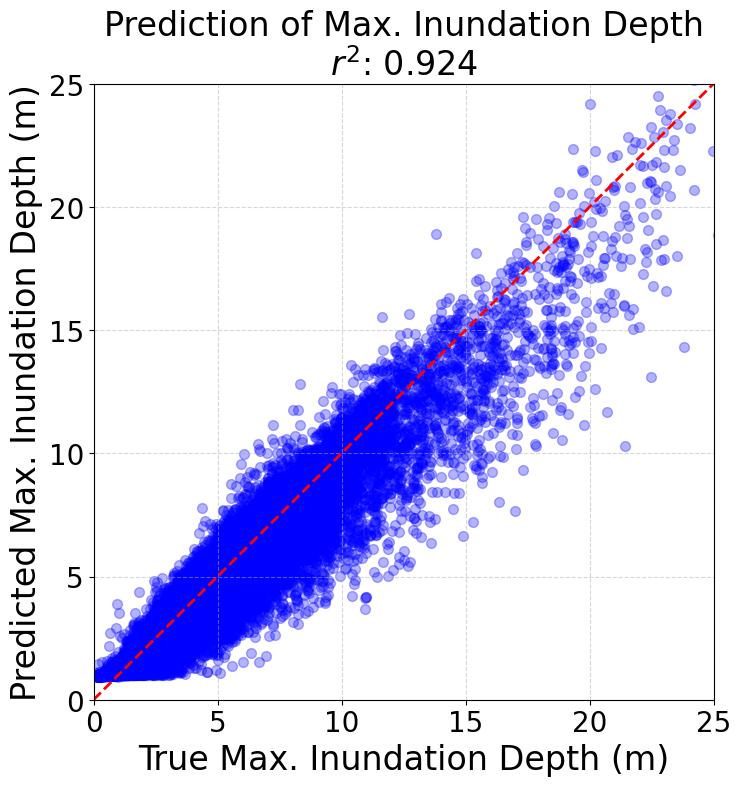

In [24]:
# Create a figure with a specified size
plt.figure(figsize=(8, 8))

# Set transparent background
plt.rcParams['axes.facecolor'] = 'none'

# Scatter plot
plt.scatter(eve_perf['truemax'], eve_perf['predmax'], s=50, alpha=0.3, color='blue', label='Data Points')

# Add a diagonal line (y=x) for reference
plt.plot([0, 25], [0, 25], color='red', linestyle='--', linewidth=2, label='Ideal Fit')

# Calculate and display the R-squared value as part of the title
r_squared = r2_score(eve_perf['truemax'], eve_perf['predmax'])
plt.title(f"Prediction of Max. Inundation Depth\n$r^2$: {r_squared:.3f}", fontsize=24)

# Set plot limits and labels
plt.xlim(0, 25)
plt.ylim(0, 25)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('True Max. Inundation Depth (m)', fontsize=24)
plt.ylabel('Predicted Max. Inundation Depth (m)', fontsize=24)

# Customize grid
plt.grid(True, linestyle='--', alpha=0.5)

# Save the plot as PNG with high DPI and transparent background
plt.savefig('/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/CT/results/poster_max.png', dpi=600, transparent=True)

# Show the plot
plt.show()

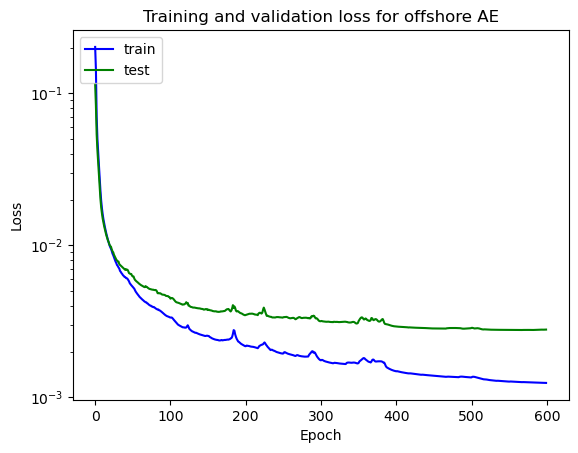

In [29]:
#plot train and test loss for pretraining and fine tuning
off_size = '6941'
train_epoch_losses = np.load(f'{MLDir}/model/{reg}/out/train_loss_offshore_ch_[64, 128, 256]_{off_size}.npy')
test_epoch_losses = np.load(f'{MLDir}/model/{reg}/out/test_loss_offshore_ch_[64, 128, 256]_{off_size}.npy')

plt.plot(train_epoch_losses, color='blue')
plt.plot(test_epoch_losses, color='green')
# plt.axvline(x=2983, color='black', linestyle='--')
# plt.text(2700, 0.1, 2983, fontsize=12)
plt.legend(['train', 'test', 'epoch selected'], loc='upper left')
plt.title(f"Training and validation loss for offshore AE")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.yscale('log')
plt.savefig(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/results/train_test_loss_offshore_{train_size}.png')

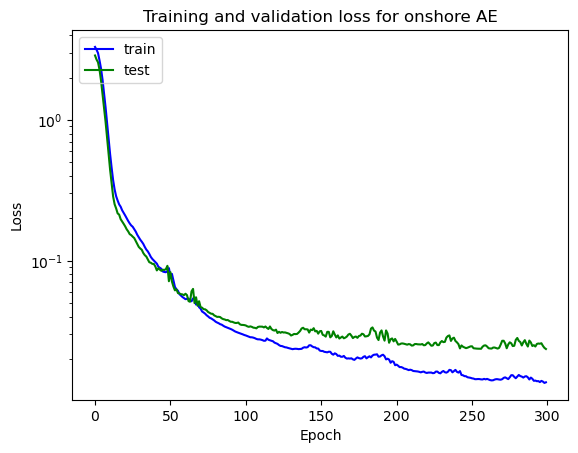

In [30]:
#plot train and test loss for pretraining and fine tuning
train_epoch_losses = np.load(f'{MLDir}/model/{reg}/out/train_loss_onshoreparts_ch_[16, 128, 128]_{train_size}.npy')
test_epoch_losses = np.load(f'{MLDir}/model/{reg}/out/test_loss_onshoreparts_ch_[16, 128, 128]_{train_size}.npy')

plt.plot(train_epoch_losses, color='blue')
plt.plot(test_epoch_losses, color='green')
# plt.axvline(x=2998, color='black', linestyle='--')
# plt.text(2700, 10, 2998, fontsize=12)
plt.legend(['train', 'test', 'epoch selected'], loc='upper left')
plt.title(f"Training and validation loss for onshore AE")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.yscale('log')
plt.savefig(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/results/train_test_loss_onshore_{train_size}.png')

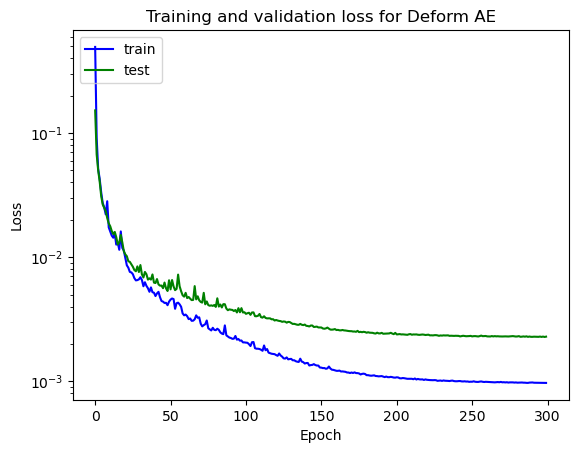

In [33]:
#plot train and test loss for pretraining and fine tuning
deform_size = '9186'
train_epoch_losses = np.load(f'{MLDir}/model/{reg}/out/train_loss_deformfull_ch_[16, 32, 64, 128]_{deform_size}.npy')
test_epoch_losses = np.load(f'{MLDir}/model/{reg}/out/test_loss_deformfull_ch_[16, 32, 64, 128]_{deform_size}.npy')

plt.plot(train_epoch_losses, color='blue')
plt.plot(test_epoch_losses, color='green')
# plt.axvline(x=2998, color='black', linestyle='--')
# plt.text(2700, 10, 2998, fontsize=12)
plt.legend(['train', 'test', 'epoch selected'], loc='upper left')
plt.title(f"Training and validation loss for Deform AE")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.yscale('log')
plt.savefig(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/results/train_test_loss_deform_{train_size}.png')

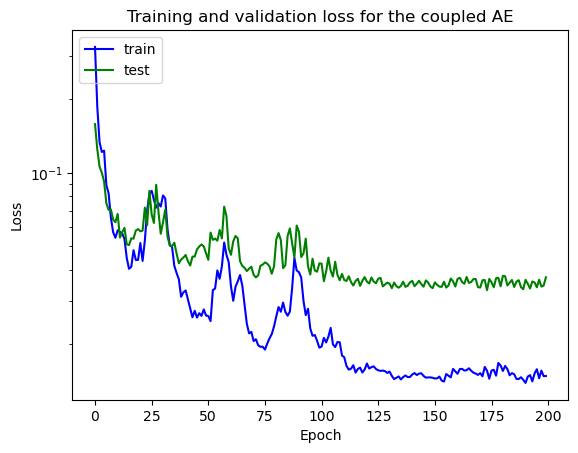

In [32]:
#plot train and test loss for pretraining and fine tuning

train_epoch_losses = np.load(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/out/train_loss_couple_{train_size}.npy')
test_epoch_losses = np.load(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/out/test_loss_couple_{train_size}.npy')

plt.plot(train_epoch_losses, color='blue')
plt.plot(test_epoch_losses, color='green')
# plt.axvline(x=1468, color='black', linestyle='--')
# plt.text(1200, 0.1, 1468, fontsize=12)
plt.legend(['train', 'test', 'epoch selected'], loc='upper left')
plt.title(f"Training and validation loss for the coupled AE")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.yscale('log')
plt.savefig(f'/mnt/beegfs/nragu/tsunami/ML4SicilyTsunami/model/{reg}/results/train_test_loss_couple_{train_size}.png')